In [209]:
import networkx as nx

In [1]:
from spinncer.analysis_common import *
import traceback
# The following LUT contains the delays for both excitation and inhibition to
# reach that particular population in the case of DCN, or only excitation for
# everything else
DELAY_IN_EXCITATION = {
    'glomerulus': 0,
    'mossy_fibers': 0,
    'granule': 4,
    'granule_cell': 4,
    'dcn': max(4, 10),
    'dcn_cell': max(4, 10),
    'dcn_interneuron': 4,
    'golgi': 4,
    'golgi_cell': 4,
    'purkinje': 6,
    'purkinje_cell': 6,
    'stellate': 9,
    'stellate_cell': 9,
    'basket': 9,
    'basket_cell': 9,
    'io_cell': 0,
}

def color_for_index(index, size, cmap=viridis_cmap):
    return cmap(1 / (size - index + 1))


def plot_analog_signal(data, variable_name, ylabel, plot_order,
                       wanted_times, time_to_bin_conversion,
                       fig_folder,
                       highlight_stim, common_highlight_values,
                       scale_xticks=1):
    print("Plotting {} traces for each population".format(variable_name))
    for index, pop in enumerate(plot_order):
        try:
            values_for_pop = data[pop]
            f = plt.figure(1, figsize=(9, 9), dpi=400)
            for _ind, _trace in enumerate(values_for_pop):
                plt.plot(_trace,
                         color=color_for_index(_ind, values_for_pop.shape[0]),
                         rasterized=True)
            plt.xticks(wanted_times * time_to_bin_conversion * scale_xticks,
                       wanted_times)
            plt.xlabel("Time (ms)")
            plt.ylabel(ylabel)

            save_figure(plt, os.path.join(fig_folder,
                                          "{}_{}".format(pop, variable_name)),
                        extensions=['.png', ])
            plt.close(f)
        except:
            pass


def highlight_area(ax, pop, start, stop, increment):
    _highlight_times = np.arange(start[pop],
                                 stop[pop],
                                 increment)
    ax.fill_between(
        _highlight_times, 0, 1,
        color='grey', alpha=0.3,
        transform=ax.get_xaxis_transform())

WARNING    /localhome/mbax3pb2/py3_venv/lib/python3.5/site-packages/elephant/pandas_bridge.py:22: DeprecationWarning: pandas_bridge module will be removed in Elephant v0.8.x
  DeprecationWarning)
 [py.warnings]


In [2]:
# ensure we use viridis as the default cmap
plt.viridis()

# ensure we use the same rc parameters for all matplotlib outputs
mlib.rcParams.update({'font.size': 24})
mlib.rcParams.update({'errorbar.capsize': 5})
mlib.rcParams.update({'figure.autolayout': True})
viridis_cmap = mlib.cm.get_cmap('viridis')

PREFFERED_ORDER = ['mossy_fibers',
                   'glomerulus',
                   'granule', 'golgi',
                   'stellate', 'basket',
                   'purkinje', 'dcn']

<Figure size 432x288 with 0 Axes>

In [35]:
for cell_name in plot_order:
    cell_params = CELL_PARAMS[cell_name]
    if cell_name == "glomerulus":
        continue
    print("{} & {} & {} & {} & {} & {} & {} & {} & {} & {} \\\\".format(
        use_display_name(cell_name),
        cell_params["cm"],
        cell_params["i_offset"],
        cell_params["tau_m"],
        cell_params["tau_refrac"],
        cell_params["tau_syn_E"],
        cell_params["tau_syn_I"],
        cell_params["v_reset"],
        cell_params["v_rest"],
        cell_params["v_thresh"],
                                                                )
         )

GrC & 0.003 & 0.0 & 2 & 1.5 & 0.5 & 10.0 & -84.0 & -74.0 & -42.0 \\
GoC & 0.076 & 0.0368 & 21 & 2.0 & 0.5 & 10.0 & -75.0 & -65.0 & -55.0 \\
SC & 0.0146 & 0.0156 & 14.6 & 1.6 & 0.64 & 2 & -78.0 & -68.0 & -53.0 \\
BC & 0.0146 & 0.0156 & 14.6 & 1.6 & 0.64 & 2 & -78.0 & -68.0 & -53.0 \\
PC & 0.62 & 0.6 & 88.0 & 0.8 & 0.5 & 1.6 & -72.0 & -62.0 & -47.0 \\
DCNC & 0.089 & 0.0558 & 57 & 3.7 & 7.1 & 13.6 & -69.0 & -59.0 & -48.0 \\


In [142]:
# def spike_analysis(results_file, fig_folder,
#                    worst_case=True, delay_sensitive=False,
#                    dark_background=False,
#                    highlight_stim=False):
# path_to_results = "/localhome/mbax3pb2/SpiNNCer/spinncer/test_same_board/results/"
# path_to_results = "/localhome/mbax3pb2/SpiNNCer/spinncer/results/"
path_to_results = "/localhome/mbax3pb2/SpiNNCer/spinncer/variance_testing_POISSON_@c1f7f3710e632b0acfb3bb09650542af/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/results/"
# path_to_results = "/localhome/mbax3pb2/SpiNNCer/spinncer/test_same_board/variance_testing_POISSON_fpeak_200_radius_130_@ac320f65724d2c707291e87774d566cb/spinn_400x400_run_0_poisson_@ac320f65724d2c707291e87774d566cb/results/"
# file = "spinn_400x400_200_130_pc_1_16_bit_rec.npz"
file = "spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af.npz"
# file = "spinn_400x400_run_0_poisson_@ac320f65724d2c707291e87774d566cb.npz"
DEFAULT_FIGURE_DIR = 'figures/'
DEFAULT_RESULT_DIR = 'results/'

results_file = os.path.join(path_to_results,file)
fig_folder = DEFAULT_FIGURE_DIR
worst_case = True
delay_sensitive=True
dark_background=False
highlight_stim=True

In [194]:

if dark_background:
    plt.style.use('dark_background')
# Retrieve results file
try:
    data = np.load(results_file, allow_pickle=True)
except FileNotFoundError:
    data = np.load(results_file + ".npz", allow_pickle=True)
    results_file += ".npz"

# Check if the folders exist
if not os.path.isdir(fig_folder) and not os.path.exists(fig_folder):
    os.mkdir(fig_folder)

# Create figures folder for this results_file
sim_fig_folder = os.path.join(fig_folder,
                              str(ntpath.basename(results_file))[:-4])
if not os.path.isdir(sim_fig_folder) and not os.path.exists(sim_fig_folder):
    os.mkdir(sim_fig_folder)
# Set up colours
color_init(strip=False)

# Plotting results for ...
print("=" * 80)
print("Plotting results for", results_file)
print("-" * 80)

# Retrieve information from results file
all_spikes = data['all_spikes'].ravel()[0]
try:
    final_connectivity = data['final_connectivity'].ravel()[0]
except:
    final_connectivity = []
    traceback.print_exc()
all_neurons = data['all_neurons'].ravel()[0]
sim_params = data['simulation_parameters'].ravel()[0]
other_recordings = data['other_recordings'].ravel()[0]
simtime = data['simtime'] * ms
timestep = sim_params['argparser']['timestep'] * ms
stimulus_params = data['stimulus_params'].ravel()[0]
starts = np.cumsum(np.concatenate(([0], stimulus_params['stim_times'])))
time_filter = starts
stim_durations = sim_params['argparser']['stim_times']
stimulus_periods = len(stim_durations)
average_firing_rates = {}

conn_params = data['conn_params'].ravel()[0] if 'conn_params' in data.files else CONNECTIVITY_MAP
cell_params = data['cell_params'].ravel()[0] if 'cell_params' in data.files else CELL_PARAMS
# Compute plot order
plot_order = get_plot_order(all_spikes.keys())
n_plots = float(len(plot_order))
simulator = sim_params['argparser']['simulator']
# Check if using neo blocks
neo_all_spikes = {}
for pop, potential_neo_block in all_spikes.items():
    if isinstance(potential_neo_block, neo.Block):
        # make a copy of the spikes dict
        neo_all_spikes[pop] = potential_neo_block
        all_spikes[pop] = convert_spikes(potential_neo_block)
# Report useful parameters
print("=" * 80)
print("Simulation parameters")
print("-" * 80)
pp(sim_params)
pp(cell_params)
pp(conn_params)
# Report useful parameters
print("=" * 80)
print("Analysis report")
print("-" * 80)
print("Current time",
      plt.datetime.datetime.now().strftime("%H:%M:%S on %d.%m.%Y"))
print("This analysis includes:")
print("\tUNFILTERED mean firing rates per period (before, during, after "
      "stimulation)")
print("\tFILTERED   mean firing rates per period (before, during, after "
      "stimulation)")
print("\traster plots")
print("\t3ms-binned PSTH")
print("\ttimestep-binned PSTH")
if delay_sensitive:
    print("\tfiring rates per period taking into account DELAYS")
if worst_case:
    print("\tcounting WORST CASE number of afferent spikes per cell")
# Report number of neurons
print("=" * 80)
print("Number of neurons in each population")
print("-" * 80)
for pop in plot_order:
    print("\t{:20} -> {:10} neurons".format(pop, all_neurons[pop]))
# Pre-compute conversions
time_to_bin_conversion = 1. / (timestep / ms)
bins_in_3ms = int(3 * time_to_bin_conversion)
no_timesteps = int(simtime / ms * time_to_bin_conversion)
pad_to_compute_3ms_bins = bins_in_3ms - no_timesteps % bins_in_3ms
# Bincount
spikes_per_timestep = {}
spikes_per_3ms = {}
# Per neuron firing rate in each stimulus period
per_neuron_firing = {}
per_neuron_spike_count = {}
# Number of post-synaptic hits in each timestep
all_post_hits = {}
all_max_exc_spikes = {}
all_max_inh_spikes = {}
all_exc_spike_counts = {}
all_inh_spikes_counts = {}
print("=" * 80)
print("Maximum number of generated spikes per timestep")
print("-" * 80)

# Elephant computed metrics
elephant_psths = {}
elephant_instantaneous_rates = {}
elephant_timestep = sim_params['argparser']['timestep'] * pq.ms
elephant_simtime = data['simtime'] * pq.ms
try:
    for pop in plot_order:
        curr_spikes = neo_all_spikes[pop].segments[0].spiketrains
        curr_inst_rates = \
            elephant.statistics.instantaneous_rate(
                curr_spikes,
                sampling_period=elephant_timestep,
                t_start=0 * pq.ms,
                t_stop=elephant_simtime
            )
        curr_psths = \
            elephant.statistics.time_histogram(
                curr_spikes,
                binsize=elephant_timestep,
                t_start=0 * pq.ms,
                t_stop=elephant_simtime
            )
        elephant_psths[pop] = curr_psths.ravel()
        # Save the average instantaneous rate
        elephant_instantaneous_rates[pop] = curr_inst_rates.ravel() / all_neurons[pop]
except:
    pass

stim_period_start = {}
stim_period_end = {}
per_pop_stim_durations = {k: [] for k in plot_order}
for pop in plot_order:
    spikes = all_spikes[pop]

    spikes_per_timestep[pop] = \
        np.bincount((spikes[:, 1] * time_to_bin_conversion).astype(int),
                    minlength=no_timesteps)
    max_spikes = np.max(spikes_per_timestep[pop])
    print("\t{:20}->{:6} = {:1.4f}".format(pop, max_spikes,
                                           max_spikes / all_neurons[pop]),
          "per neuron")
    padded_bincount = np.pad(
        spikes_per_timestep[pop],
        (0, pad_to_compute_3ms_bins -
         (spikes_per_timestep[pop].size - no_timesteps)),  # This should be 0 or 1 corresponding to SpiNNaker or NEST
        'constant', constant_values=0)

    reshaped_bincount = padded_bincount.reshape(
        int(padded_bincount.shape[0] / bins_in_3ms), bins_in_3ms)

    spikes_per_3ms[pop] = np.sum(reshaped_bincount, axis=1)
    # temporary variable to store the population level firing rates
    # before, during and after stimulation
    _filtered_spike_rates = np.zeros(stimulus_periods)
    _spike_times = spikes[:, 1]
    # Initialise per_neuron_firing
    per_neuron_firing[pop] = np.ones((all_neurons[pop],
                                      stimulus_periods)) * -10
    per_neuron_spike_count[pop] = np.ones((all_neurons[pop],
                                           stimulus_periods)) * -10

    for period in range(stimulus_periods):

        if delay_sensitive and period == 0:
            time_filter_pre = time_filter[period]
            time_filter_post = time_filter[period + 1] + DELAY_IN_EXCITATION[pop]
        elif delay_sensitive and period == 1:
            time_filter_pre = time_filter[period] + DELAY_IN_EXCITATION[pop]
            time_filter_post = time_filter[period + 1] + DELAY_IN_EXCITATION[pop]
        elif delay_sensitive and period == 2:
            time_filter_pre = time_filter[period] + DELAY_IN_EXCITATION[pop]
            time_filter_post = time_filter[period + 1]
        else:
            time_filter_pre = time_filter[period]
            time_filter_post = time_filter[period + 1]

        if period == 1:
            stim_period_start[pop] = time_filter_pre
            stim_period_end[pop] = time_filter_post
        per_pop_stim_durations[pop].append(time_filter_post - time_filter_pre)
        current_period_duration = per_pop_stim_durations[pop][period]
        _filtered_spike_times = np.logical_and(
            _spike_times >= time_filter_pre,
            _spike_times < time_filter_post)
        _filtered_spike_rates[period] = \
            np.count_nonzero(_filtered_spike_times) / \
            (current_period_duration * ms)
        for nid in range(all_neurons[pop]):
            _spikes_for_nid = spikes[spikes[:, 0] == nid][:, 1]
            _no_spike_for_nid = np.count_nonzero(np.logical_and(
                _spikes_for_nid >= time_filter_pre,
                _spikes_for_nid < time_filter_post))
            per_neuron_spike_count[pop][nid, period] = _no_spike_for_nid
            per_neuron_firing[pop][nid, period] = \
                _no_spike_for_nid / (current_period_duration * ms)
    # save the firing rate for the average neuron in this population
    average_firing_rates[pop] = _filtered_spike_rates / all_neurons[pop]
# Report average firing rates before, during and after stimulation
print("=" * 80)
print("Average firing rates before, during and after stimulation")
print("-" * 80)
for pop in plot_order:
    _x = average_firing_rates[pop] / Hz
    before = _x[0]
    during = _x[1]
    after = _x[2]
    print("\t{:20}->[{:>8.2f}, {:>8.2f}, {:>8.2f}] Hz".format(
        pop, before, during, after), "per neuron")

print("=" * 80)
print("(LaTeX formatting) "
      "Average firing rates before, during and after stimulation "
      "(LaTeX formatting)")
print("-" * 80)
for pop in plot_order:
    _x = average_firing_rates[pop] / Hz
    before = _x[0]
    during = _x[1]
    after = _x[2]
    print("\t{:20} & {:>8.2f} & {:>8.2f} & {:>8.2f}".format(
        pop, before, during, after))

print("=" * 80)
print("FILTERED average firing rates before, during and after stimulation")
print("-" * 80)
for pop in plot_order:
    # Retrieve firing rate for each neuron in each of the periods
    _x = per_neuron_firing[pop]
    # _filtered_rates = np.zeros(stimulus_periods)
    _excited_map = np.zeros(_x.shape[0])
    _inhibited_map = np.zeros(_x.shape[0])

    # filter out neurons that are not "excited" as defined in the
    # scaffold paper, i.e., cells that fire twice as much when stimulated as
    # compared to before stimulation
    _excited_map = np.greater(_x[:, 1], 2 * _x[:, 0])
    # See SC email from 23/01/2020
    # baseline firing rate b
    # stimulation firing rate s
    # correct: b > 2 * s
    _inhibited_map = np.greater(_x[:, 0], 2 * _x[:, 1])

    # filter out neurons that don't fire at all
    _neurons_that_fire = np.sum(
        per_neuron_spike_count[pop], axis=1) > 0
    _excited_map = np.logical_and(
        _excited_map, _neurons_that_fire
    )
    _inhibited_map = np.logical_and(
        _inhibited_map, _neurons_that_fire
    )

    if pop == "granule":
        # for GrC filter out neurons that don't fire more than once
        _excited_map = np.logical_and(
            _excited_map, per_neuron_spike_count[pop][:, 1] > 1
        )

    # check that neurons are not both inhibited and excited
    assert np.all(~(np.logical_and(_excited_map, _inhibited_map)))

    excited_filtered_mean = np.mean(_x[_excited_map], axis=0)
    excited_filtered_std = np.std(_x[_excited_map], axis=0)
    excited_before = excited_filtered_mean[0]
    excited_during = excited_filtered_mean[1]
    excited_after = excited_filtered_mean[2]
    excited_before_std = excited_filtered_std[0]
    excited_during_std = excited_filtered_std[1]
    excited_after_std = excited_filtered_std[2]
    print("\t{:20} excited   ->[{:>8.2f}+-{:>4.1f}, {:>8.2f}+-{:>4.1f}, {:>8.2f}+-{:>4.1f}] Hz".format(
        pop,
        excited_before, excited_before_std,
        excited_during, excited_during_std,
        excited_after, excited_after_std),
        "per neuron")
    no_excited = np.count_nonzero(_excited_map)
    print("\t\t\t {:6d} excited neurons, i.e. {:7.2%} of cells".format(
        no_excited, no_excited / all_neurons[pop]))

    inhibited_filtered_mean = np.mean(_x[_inhibited_map], axis=0)
    inhibited_filtered_std = np.std(_x[_inhibited_map], axis=0)
    inhibited_before = inhibited_filtered_mean[0]
    inhibited_during = inhibited_filtered_mean[1]
    inhibited_after = inhibited_filtered_mean[2]
    inhibited_before_std = inhibited_filtered_std[0]
    inhibited_during_std = inhibited_filtered_std[1]
    inhibited_after_std = inhibited_filtered_std[2]
    print("\t{:20} inhibited ->[{:>8.2f}+-{:>4.1f}, {:>8.2f}+-{:>4.1f}, {:>8.2f}+-{:>4.1f}] Hz".format(
        pop,
        inhibited_before, inhibited_before_std,
        inhibited_during, inhibited_during_std,
        inhibited_after, inhibited_after_std),
        "per neuron")
    no_inhibited = np.count_nonzero(_inhibited_map)
    print("\t\t\t {:6d} inhibited neurons, i.e. {:7.2%} of cells".format(
        no_inhibited, no_inhibited / all_neurons[pop]))
    print("\t{:10} neurons didn't fire at all".format(
        np.count_nonzero(np.invert(_neurons_that_fire))))
    print("<(LaTeX formatting)>")
    print("{:15} EXCITED {:6d} ({:7.2%}) & "
          "{:>8.2f}$\pm${:>4.1f} & "
          "{:>8.2f}$\pm${:>4.1f} & "
          "{:>8.2f}$\pm${:>4.1f}".format(
        pop,
        int(no_excited), no_excited / all_neurons[pop],
        excited_before, excited_before_std,
        excited_during, excited_during_std,
        excited_after, excited_after_std))

    print("{:15} INHIBITED {:6d} ({:7.2%}) & "
          "{:>8.2f}$\pm${:>4.1f} & "
          "{:>8.2f}$\pm${:>4.1f} & "
          "{:>8.2f}$\pm${:>4.1f}".format(
        pop,
        int(no_inhibited), no_inhibited / all_neurons[pop],
        inhibited_before, inhibited_before_std,
        inhibited_during, inhibited_during_std,
        inhibited_after, inhibited_after_std))
    print("</(LaTeX formatting)>")
    print("-" * 80)
print("=" * 80)

if worst_case:
    # Count incoming spikes only if we care -- this takes a while
    inc_spike_count = {k: np.zeros((all_neurons[k], no_timesteps + 1))
                       for k in all_neurons.keys()}

# flag set if some connectivity exists
conn_exists = False

# Report weights values
print("Average weight per projection")
print("-" * 80)
conn_dict = {}
for key in final_connectivity:
    # Connection holder annoyance here:
    conn = np.asarray(final_connectivity[key])
    if final_connectivity[key] is None or conn.size == 0:
        print("Skipping analysing connection", key)
        continue
    conn_exists = True
    if len(conn.shape) == 1 or conn.shape[1] != 4:
        try:
            x = np.concatenate(conn)
            conn = x
        except:
            pass
        names = [('source', 'int_'),
                 ('target', 'int_'),
                 ('weight', 'float_'),
                 ('delay', 'float_')]
        useful_conn = np.zeros((conn.shape[0], 4), dtype=np.float)
        for i, (n, _) in enumerate(names):
            useful_conn[:, i] = conn[n].astype(np.float)
        final_connectivity[key] = useful_conn.astype(np.float)
        conn = useful_conn.astype(np.float)
    conn_dict[key] = conn
    mean = np.mean(conn[:, 2])
    # replace with percentage of difference
    original_conn = np.abs(conn_params[key]["weight"])
    if mean < original_conn:
        proportion = mean / original_conn
    else:
        proportion = original_conn / mean
    # assert (0 <= proportion <= 1), proportion
    is_close = proportion >= .95
    _c = Fore.GREEN if is_close else Fore.RED

    print("{:27} -> {}{:4.6f}{} uS".format(
        key, _c, mean, Style.RESET_ALL),
        "c.f. {: 4.6f} uS ({:>7.2%})".format(
            conn_params[key]["weight"], proportion))
# Report delay values
print("=" * 80)
print("Average Delay per projection")
print("-" * 80)
for key in final_connectivity:
    conn = conn_dict[key]
    mean = np.mean(conn[:, 3])
    # replace with percentage of difference
    original_conn = np.abs(conn_params[key]["delay"])
    if mean < original_conn:
        proportion = mean / original_conn
    else:
        proportion = original_conn / mean
    # assert (0 <= proportion <= 1), proportion
    is_close = proportion >= .95
    _c = Fore.GREEN if is_close else Fore.RED

    print("{:27} -> {}{:4.2f}{} ms".format(
        key, _c, mean, Style.RESET_ALL),
        "c.f. {: 4.2f} ms ({:>7.2%})".format(
            conn_params[key]["delay"], proportion))

# Report delay values
print("=" * 80)
print("(LaTeX formatting) "
      "Average weight per projection "
      "(LaTeX formatting)")
print("Connection Name ")
print("{:27} | {:10} | ".format("Connection Name", "Def. W"),
      "{:20}".format("SpiNN. W"))
for key in final_connectivity:
    conn = conn_dict[key]
    mean = np.mean(conn[:, 2])
    # replace with percentage of difference
    original_conn = np.abs(conn_params[key]["weight"])
    orig_conn_sign = np.sign(conn_params[key]["weight"])
    if mean < original_conn:
        proportion = mean / original_conn
    else:
        proportion = original_conn / mean
    diff = original_conn - mean
    prop_diff = orig_conn_sign * (diff / original_conn)
    # assert (0 <= proportion <= 1), proportion
    is_close = proportion >= .95

    print("{:27} & {:4.10f} &".format(key, conn_params[key]["weight"]),
          "{: 4.10f} ({:>7.2%})".format(
              mean, prop_diff))

# Check voltage information
all_voltages = {}
all_exc_gsyn = {}
all_inh_gsyn = {}

if other_recordings is not None:
    print("=" * 80)
    print("Input current analysis")
    print("-" * 80)
    # Looking at the voltage
    for pop in plot_order:
        try:
            curr_v = other_recordings[pop]
            if curr_v is None:
                raise KeyError()
            else:
                curr_v = curr_v['v']
        except KeyError:
            print("No voltage information for", pop)
            continue
        # Create a useful, aligned numpy array of shape (sh0, sh1)
        # where sh0 = number of neurons in pop
        # and   sh1 = number of timesteps in the simulation
        if isinstance(curr_v, neo.Block):
            try:
                all_voltages[pop] = np.array(curr_v.segments[0].filter(name='v')[0]).T
            except AttributeError as ae:
                all_voltages[pop] = np.squeeze(
                    np.asarray(curr_v.segments[0].analogsignals).T, axis=-1)

        elif curr_v.shape[1] == 4:
            all_voltages[pop + "_exc"] = np.zeros((all_neurons[pop], no_timesteps))
            all_voltages[pop + "_inh"] = np.zeros((all_neurons[pop], no_timesteps))
            for nid, time, v_exc, v_inh in curr_v:
                all_voltages[pop + "_exc"][int(nid), int(time * time_to_bin_conversion)] = v_exc
                all_voltages[pop + "_inh"][int(nid), int(time * time_to_bin_conversion)] = v_inh
        else:
            print("Only synaptic current contribution is supported "
                  "for analysis currently")
    # Report statistics here
    for key, v in all_voltages.items():
        nid, tstep = np.unravel_index(np.argmax(v, axis=None), v.shape)
        print("{:20}-> neuron {:>8d} received {:>6d}".format(
            key, int(nid), int(np.max(v))),
            "nA in timestep #{:8d}".format(int(tstep)))
        # Also treat voltage as if it's a piggybacked value packaging
        # counts of number of post-synaptic hits for spikes
        max_v = np.max(v, axis=0)
        abcd_view = max_v.astype(np.uint32).view(dtype=[
                                      ('d', np.uint16),
                                      ('c', np.uint16),
                                      ('b', np.uint16),
                                      ('a', np.uint16)])
        pd_view = pd.DataFrame(abcd_view)
        pd_view.describe()
        # this is meaningless using default tools
        all_post_hits[key] = pd_view
    # Looking at gsyn
    for pop in plot_order:
        try:
            og = other_recordings[pop]
            if og is None:
                raise KeyError()
            else:
                curr_exc_gsyn = og['gsyn_exc']
                curr_inh_gsyn = og['gsyn_inh']
        except KeyError:
            print("No gsyn information for", pop)
            continue

        if (isinstance(curr_exc_gsyn, neo.Block)
                and isinstance(curr_inh_gsyn, neo.Block)):
            try:
                all_exc_gsyn[pop] = np.array(curr_exc_gsyn.segments[0].filter(name='gsyn_exc')[0]).T
                all_inh_gsyn[pop] = np.array(curr_inh_gsyn.segments[0].filter(name='gsyn_inh')[0]).T

            except:
                all_exc_gsyn[pop] = np.squeeze(
                    np.asarray(curr_exc_gsyn.segments[0].analogsignals).T,
                    axis=-1)
                all_inh_gsyn[pop] = np.squeeze(
                    np.asarray(curr_inh_gsyn.segments[0].analogsignals).T,
                    axis=-1)

    # report gsyn information
    print("=" * 80)
    print("Excitatory synaptic conductance analysis")
    print("-" * 80)
    for key, g in all_exc_gsyn.items():
        nid, tstep = np.unravel_index(np.argmax(g, axis=None), g.shape)
        print("{:20}-> neuron {:>8d} had an excitatory synaptic "
              "conductance (g_syn) {:>10.2f}".format(
            key, int(nid), np.max(g)),
            "uS in timestep #{:8d}".format(int(tstep)))
        # this is meaningless using default tools
        all_max_exc_spikes[key] = np.max(g, axis=0)
    print("=" * 80)
    print("Inhibitory synaptic conductance analysis")
    print("-" * 80)
    for key, g in all_inh_gsyn.items():
        nid, tstep = np.unravel_index(np.argmax(g, axis=None), g.shape)
        print("{:20}-> neuron {:>8d} had an inhibitory synaptic "
              "conductance (g_syn) {:>10.2f}".format(
            key, int(nid), np.max(g)),
            "uS in timestep #{:8d}".format(int(tstep)))
        # this is meaningless using default tools
        all_max_inh_spikes[key] = np.max(g, axis=0)
else:
    print("No other recording information present.")

if worst_case:
    per_conn_worst_spikes = {}
    for k in all_neurons.keys():
        per_conn_worst_spikes[k] = {}
    # The following is expensive time wise
    for key, conn in conn_dict.items():
        post_pop = conn_params[key]["post"]
        pre_pop = conn_params[key]["pre"]
        curr_spikes = all_spikes[pre_pop]
        inc_spikes_for_this_conn = np.zeros(inc_spike_count[post_pop].shape)
        for nid, t in curr_spikes:
            nid = int(nid)
            times = int(t * time_to_bin_conversion)
            targets = conn[conn[:, 0] == nid][:, 1].astype(int)
            inc_spikes_for_this_conn[targets, times] += 1
        inc_spike_count[post_pop] += inc_spikes_for_this_conn
        per_conn_worst_spikes[post_pop][key] = inc_spikes_for_this_conn

if conn_exists and worst_case:
    print("=" * 80)
    print("Incoming spikes statistics")
    print("-" * 80)
    for pop in plot_order:
        counts = inc_spike_count[pop]
        nid, tstep = np.unravel_index(np.argmax(counts, axis=None), counts.shape)
        print("{:20}-> neuron {:>8d} saw {:>6d}".format(
            pop, int(nid), int(np.max(counts))),
            "spikes in timestep #{:8d}".format(int(tstep)))
        # Print worst case statistic for the population
        maxs = np.max(counts, axis=1)
        assert maxs.size == all_neurons[pop]
        print("\t# spikes: mean {:8.4f}, "
              "std {:8.4f}".format(
            np.mean(maxs), np.std(maxs)
        ))
        for conn_key in per_conn_worst_spikes[pop]:
            curr_nid_inc_spikes = per_conn_worst_spikes[pop][conn_key][nid]
            print("\t\t{:10} contributed {:8d} spikes".format(
                conn_key, int(curr_nid_inc_spikes[tstep])
            ))



Plotting results for /localhome/mbax3pb2/SpiNNCer/spinncer/variance_testing_POISSON_@c1f7f3710e632b0acfb3bb09650542af/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/results/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af.npz
--------------------------------------------------------------------------------
Simulation parameters
--------------------------------------------------------------------------------
{'argparser': {'dataset': 'scaffold_full_dcn_400.0x400.0_v3.hdf5',
               'disable_around': True,
               'disable_i_offset': False,
               'f_base': 1.0,
               'f_peak': 200.0,
               'figures_dir': 'figures/',
               'filename': 'spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af',
               'generate_conversion_constants': False,
               'loops_grc': 3,
               'neuron_model': 'IF_cond_exp',
               'no_reports': True,
               'param_json': None,
               '

In [144]:
# Report statistics here
for key, v in all_voltages.items():
    nid, tstep = np.unravel_index(np.argmax(v, axis=None), v.shape)
    print("{:20}-> neuron {:>8d} received {:>6d}".format(
        key, int(nid), int(np.max(v))),
        "nA in timestep #{:8d}".format(int(tstep)))
    # Also treat voltage as if it's a piggybacked value packaging
    # counts of number of post-synaptic hits for spikes
    max_v = np.max(v, axis=0)
    max_g = np.max(all_exc_gsyn[key], axis=0)
    abcd_view = max_v.astype(np.uint32).view(dtype=[
#                                   ('d', np.uint16),
#                                   ('c', np.uint16),
                                  ('b', np.uint16),
                                  ('a', np.uint16)
    ])
    abcd_view_part_2 = max_g.astype(np.uint32).view(dtype=[
                                  ('d', np.uint16),
                                  ('c', np.uint16),
#                                   ('b', np.uint16),
#                                   ('a', np.uint16)
    ])
    pd_view = pd.DataFrame(abcd_view)
    pd_view_part_2 = pd.DataFrame(abcd_view_part_2)
    pd_view = pd.concat([pd_view, pd_view_part_2], axis=1, sort=False)
    
    pd_view.describe()
    # this is meaningless using default tools
    all_post_hits[key] = pd_view
# Looking at gsyn
for pop in plot_order:
    try:
        og = other_recordings[pop]
        if og is None:
            raise KeyError()
        else:
            curr_exc_gsyn = og['gsyn_exc']
            curr_inh_gsyn = og['gsyn_inh']
    except KeyError:
        print("No gsyn information for", pop)
        continue

    if (isinstance(curr_exc_gsyn, neo.Block)
            and isinstance(curr_inh_gsyn, neo.Block)):
        try:
            all_exc_gsyn[pop] = np.array(curr_exc_gsyn.segments[0].filter(name='gsyn_exc')[0]).T
            all_inh_gsyn[pop] = np.array(curr_inh_gsyn.segments[0].filter(name='gsyn_inh')[0]).T

        except:
            all_exc_gsyn[pop] = np.squeeze(
                np.asarray(curr_exc_gsyn.segments[0].analogsignals).T,
                axis=-1)
            all_inh_gsyn[pop] = np.squeeze(
                np.asarray(curr_inh_gsyn.segments[0].analogsignals).T,
                axis=-1)

# report gsyn information
print("=" * 80)
print("Excitatory synaptic conductance analysis")
print("-" * 80)
for key, g in all_exc_gsyn.items():
    nid, tstep = np.unravel_index(np.argmax(g, axis=None), g.shape)
    print("{:20}-> neuron {:>8d} had an excitatory synaptic "
          "conductance (g_syn) {:>10.2f}".format(
        key, int(nid), np.max(g)),
        "uS in timestep #{:8d}".format(int(tstep)))
    # this is meaningless using default tools
    all_max_exc_spikes[key] = np.max(g, axis=0)
print("=" * 80)
print("Inhibitory synaptic conductance analysis")
print("-" * 80)
for key, g in all_inh_gsyn.items():
    nid, tstep = np.unravel_index(np.argmax(g, axis=None), g.shape)
    print("{:20}-> neuron {:>8d} had an inhibitory synaptic "
          "conductance (g_syn) {:>10.2f}".format(
        key, int(nid), np.max(g)),
        "uS in timestep #{:8d}".format(int(tstep)))
    # this is meaningless using default tools
    all_max_inh_spikes[key] = np.max(g, axis=0)
else:
    print("No other recording information present.")

granule             -> neuron      977 received     10 nA in timestep #    3340
stellate            -> neuron        3 received    196 nA in timestep #    3043
dcn                 -> neuron        0 received     44 nA in timestep #    3384
purkinje            -> neuron       37 received   1542 nA in timestep #    3043
golgi               -> neuron        0 received   1484 nA in timestep #    3047
basket              -> neuron        6 received    242 nA in timestep #    3043
No gsyn information for glomerulus
Excitatory synaptic conductance analysis
--------------------------------------------------------------------------------
granule             -> neuron     1002 had an excitatory synaptic conductance (g_syn)      10.00 uS in timestep #    3189
stellate            -> neuron        0 had an excitatory synaptic conductance (g_syn)     224.01 uS in timestep #    3050
dcn                 -> neuron        0 had an excitatory synaptic conductance (g_syn)       0.00 uS in timestep #    34

In [195]:
print("=" * 80)
print("Plotting figures...")
print("-" * 80)

wanted_times = np.linspace(0, (simtime / ms), 6).astype(int)
stim_wanted_times = np.linspace(time_filter[1] - 50,
                                time_filter[2] + 50, 4).astype(int)
common_highlight_values = {
    'start': stim_period_start,
    'stop': stim_period_end,
    'increment': timestep / ms,
}

common_values_for_plots = {
    'plot_order': plot_order,
    'wanted_times': wanted_times,
    'time_to_bin_conversion': time_to_bin_conversion,
    'fig_folder': sim_fig_folder,
    'highlight_stim': highlight_stim,
    'common_highlight_values': common_highlight_values,
}

Plotting figures...
--------------------------------------------------------------------------------


In [196]:
per_conn_worst_spikes['purkinje']['aa_pc'].shape

(69, 10001)

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_granule_glom_grc.png


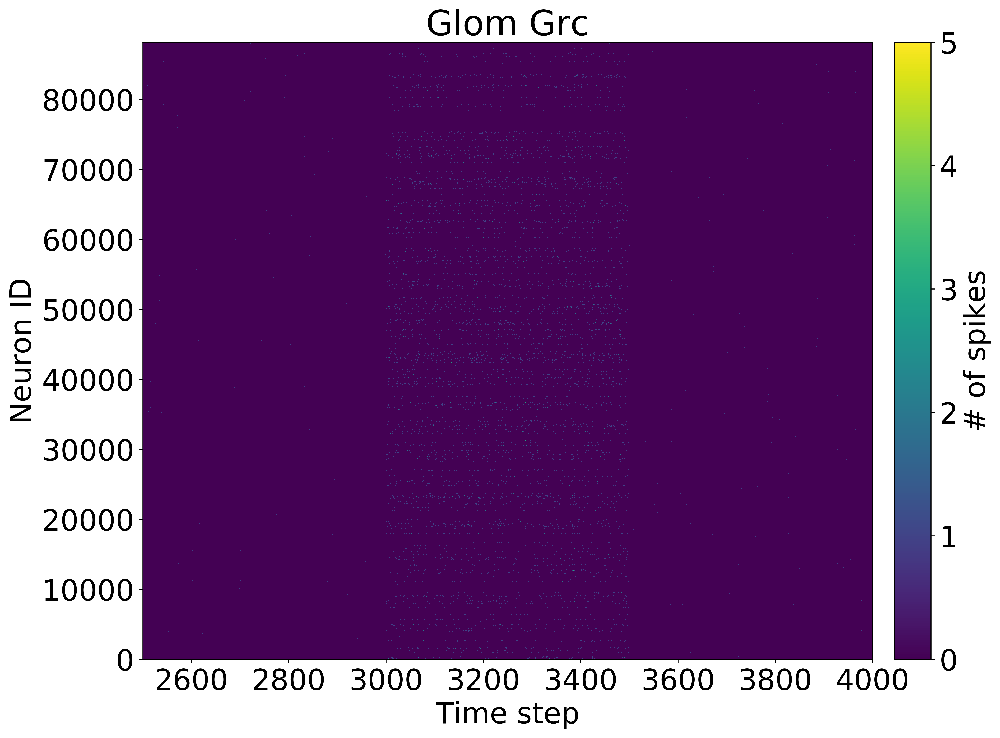

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_granule_goc_grc.png


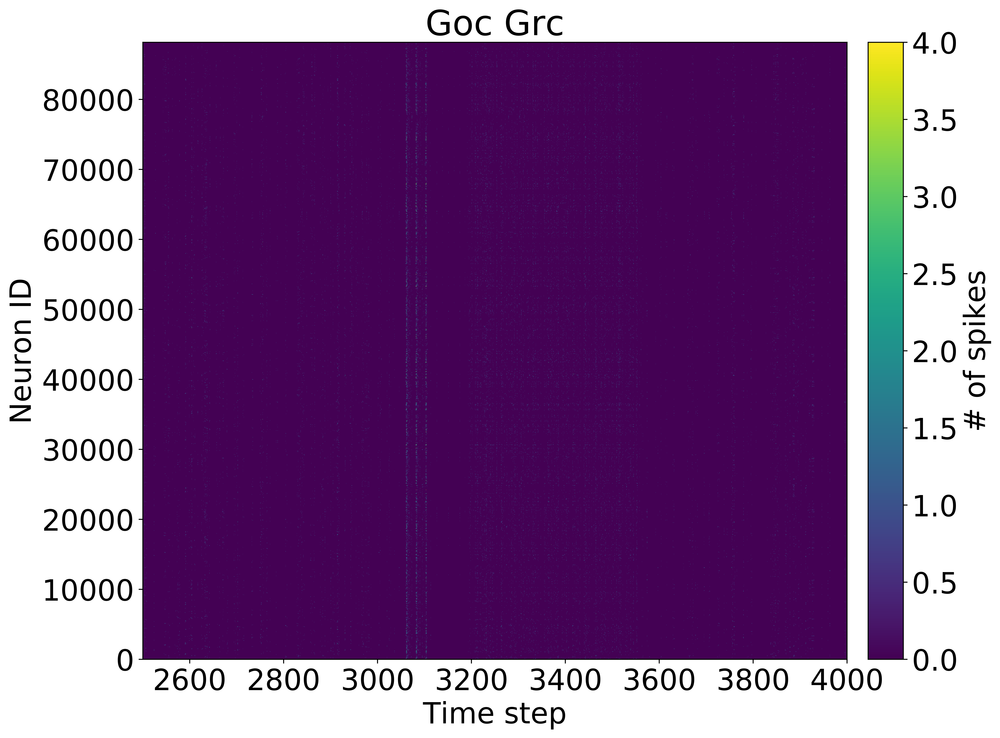

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_golgi_aa_goc.png


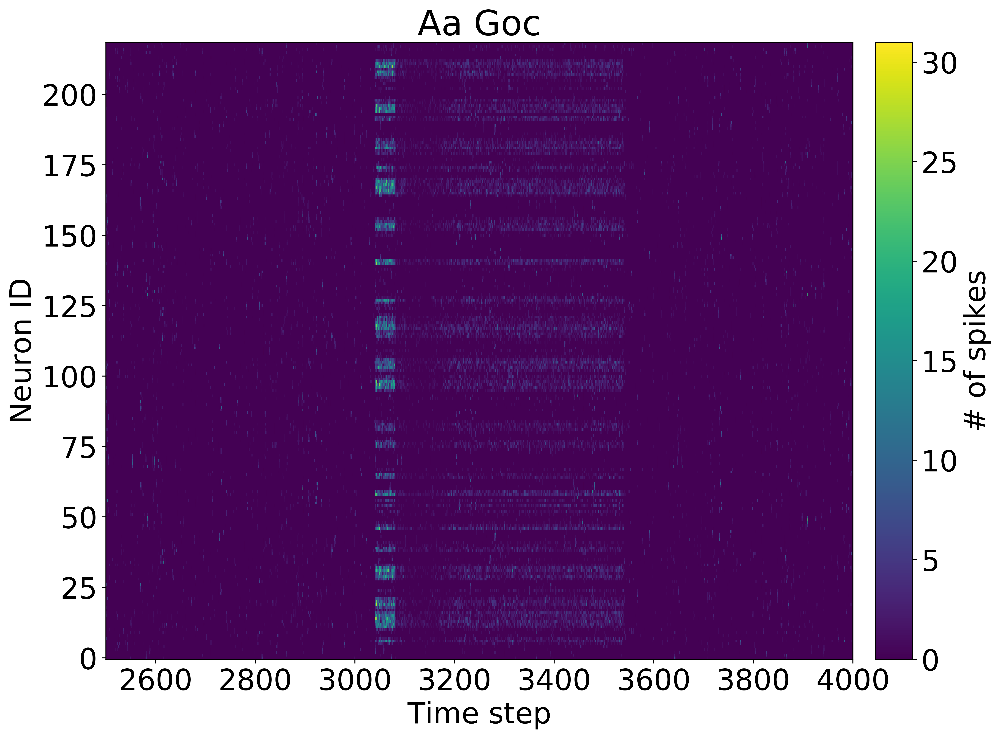

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_golgi_gj_goc.png


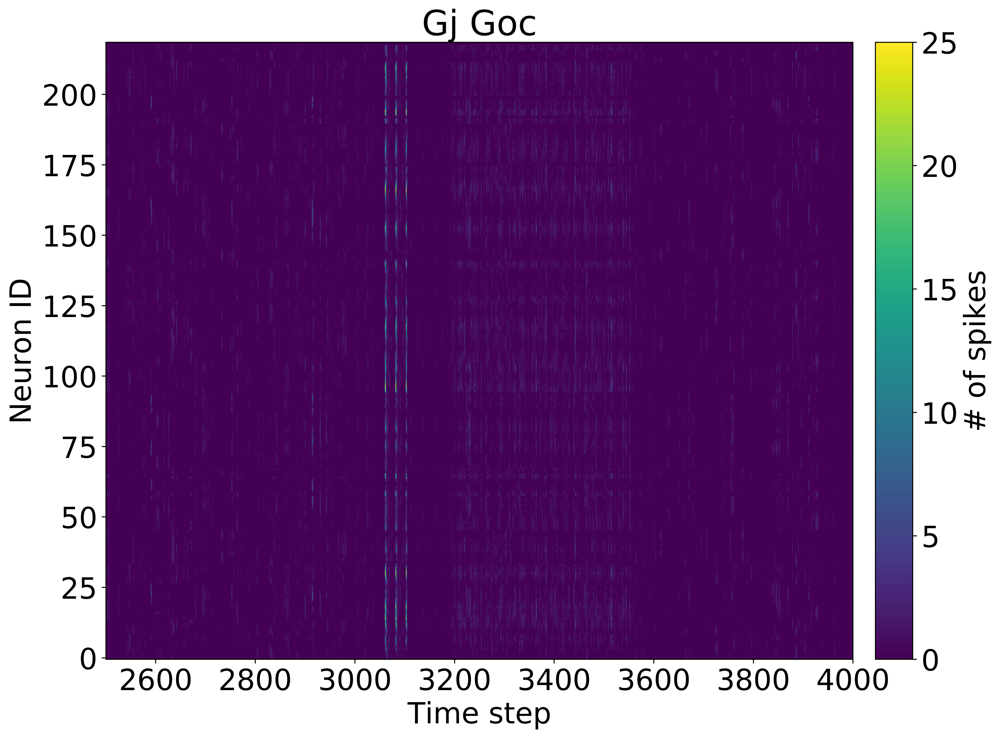

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_golgi_pf_goc.png


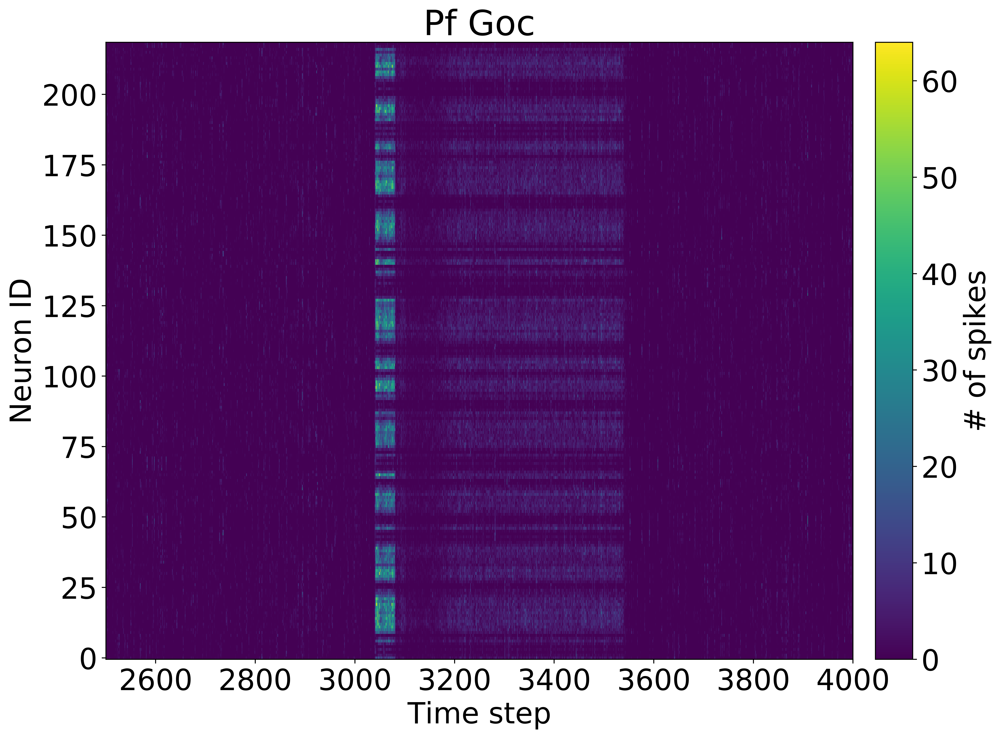

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_golgi_glom_goc.png


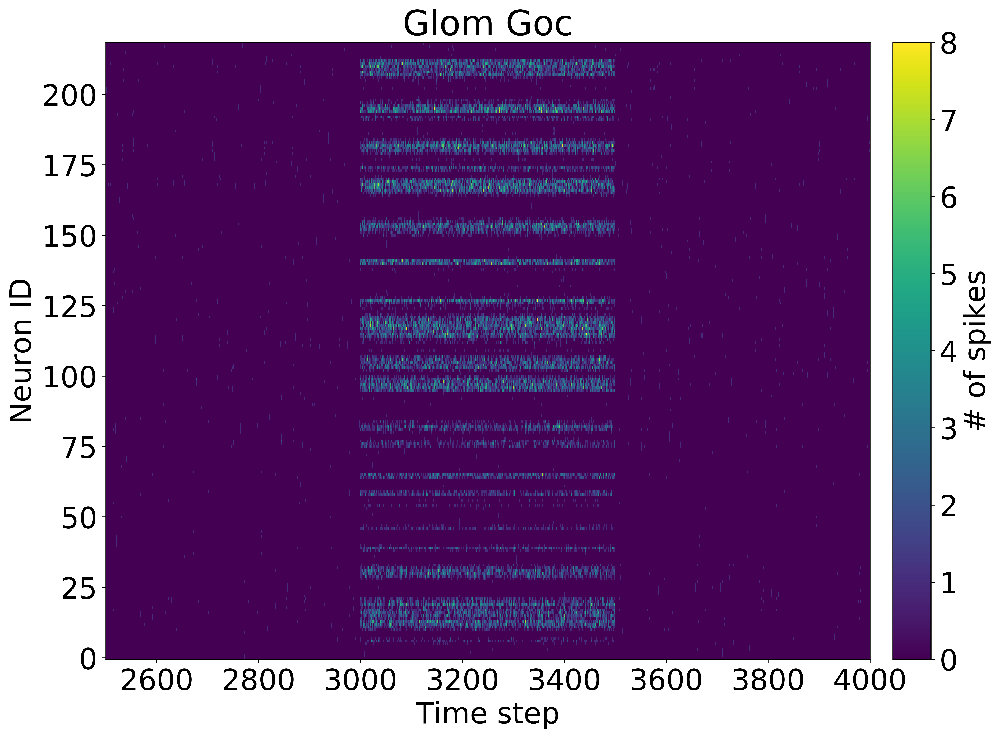

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_stellate_pf_sc.png


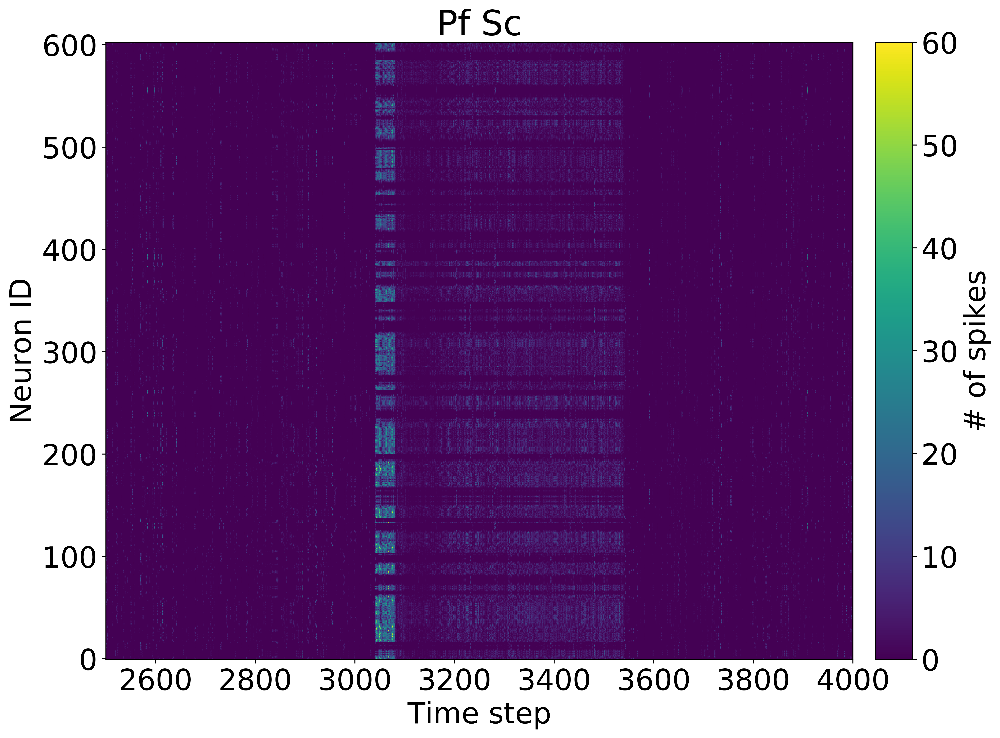

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_stellate_gj_sc.png


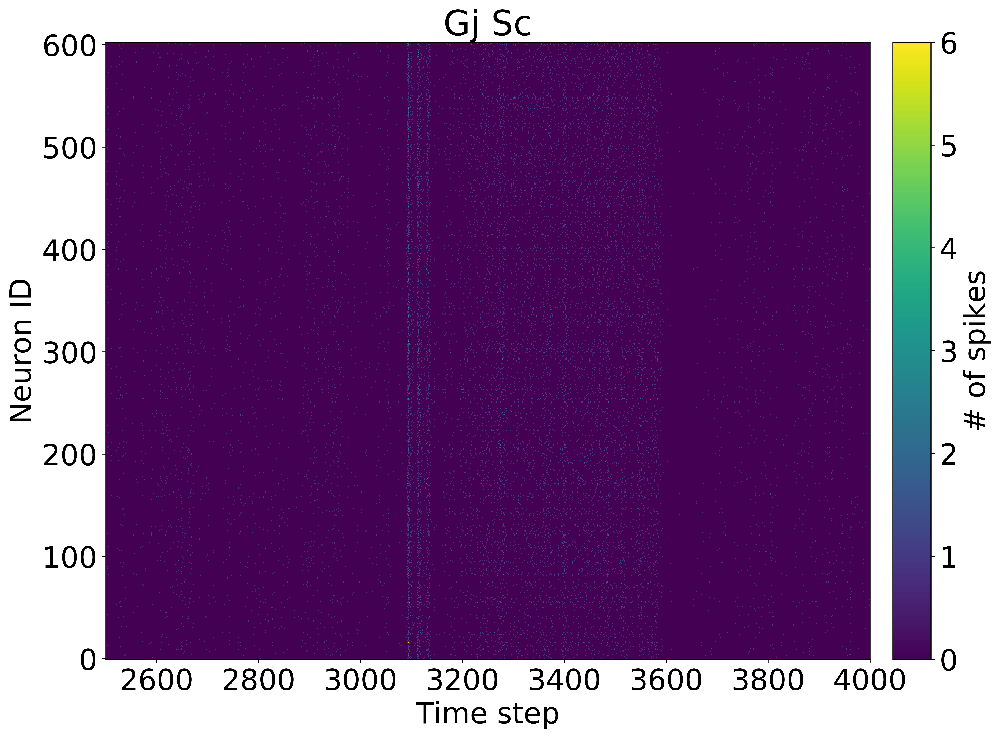

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_basket_gj_bc.png


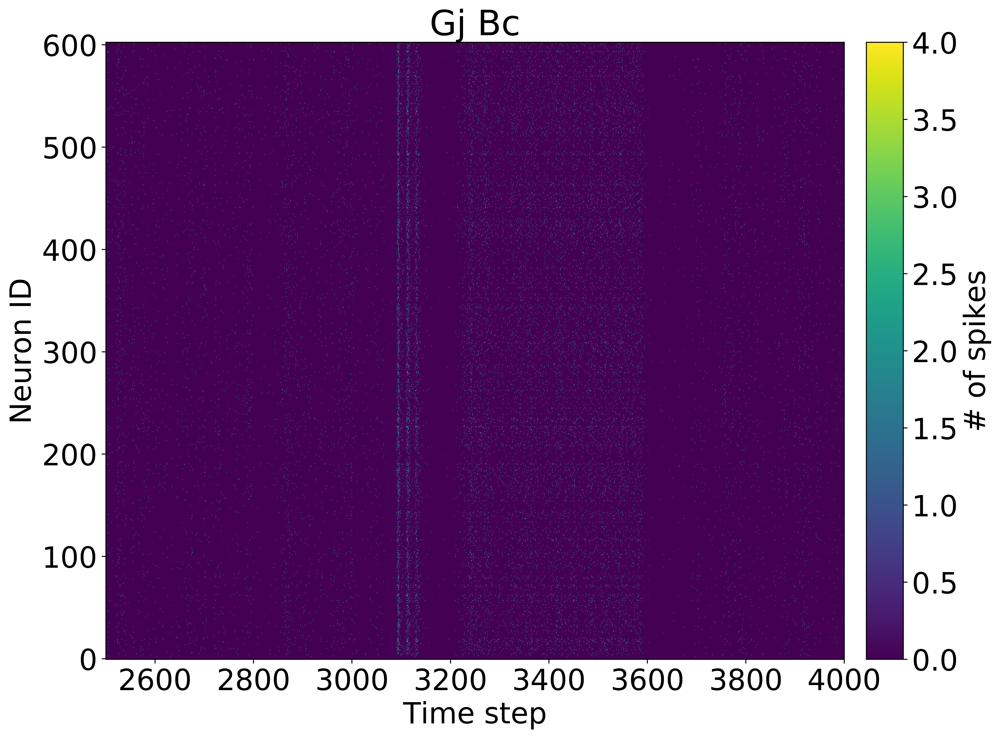

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_basket_pf_bc.png


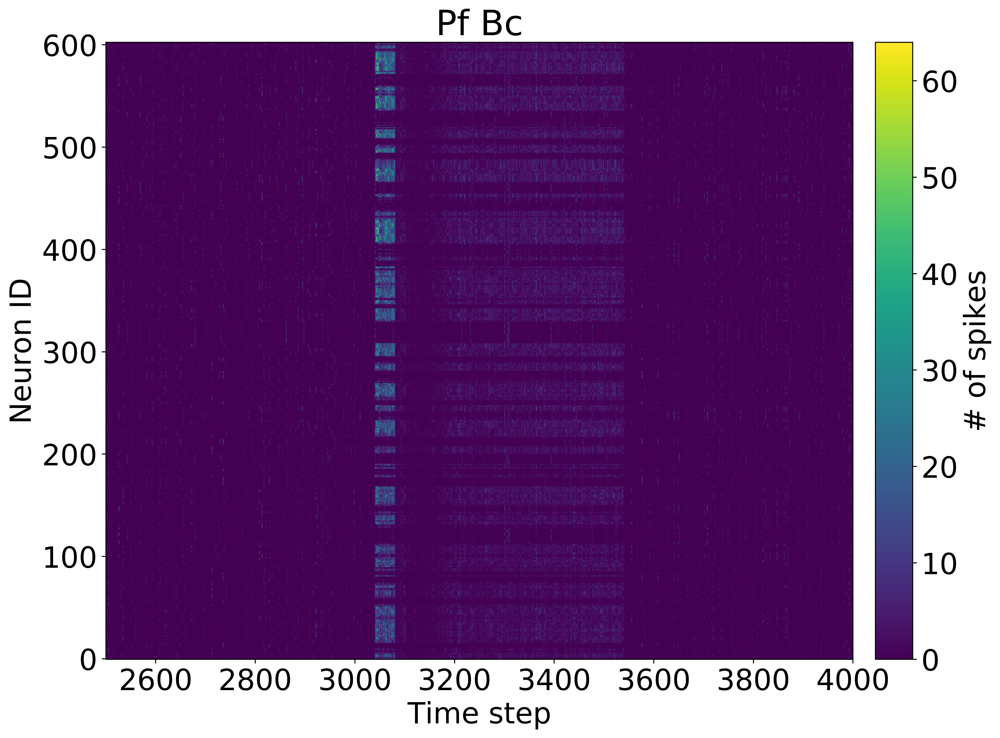

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_purkinje_pf_pc.png


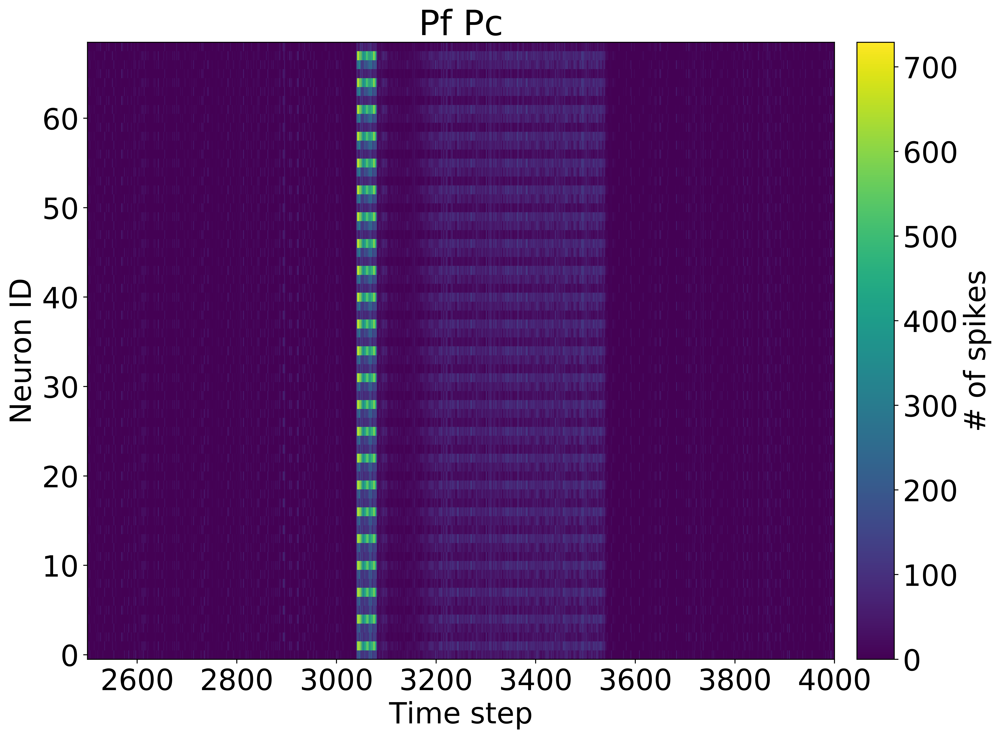

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_purkinje_aa_pc.png


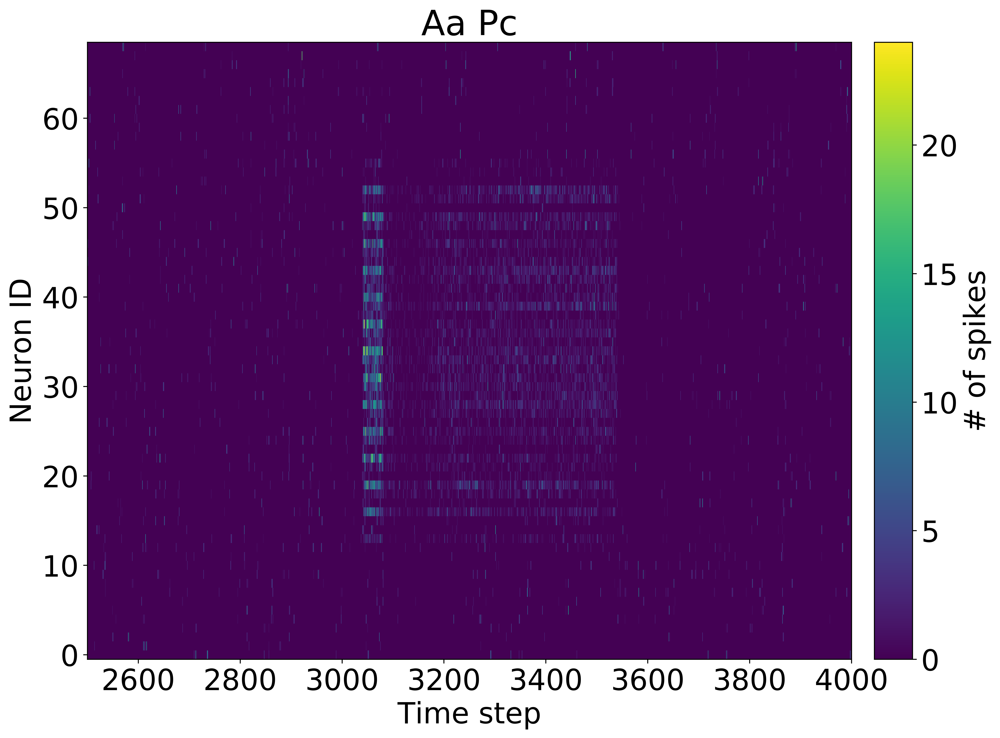

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_purkinje_bc_pc.png


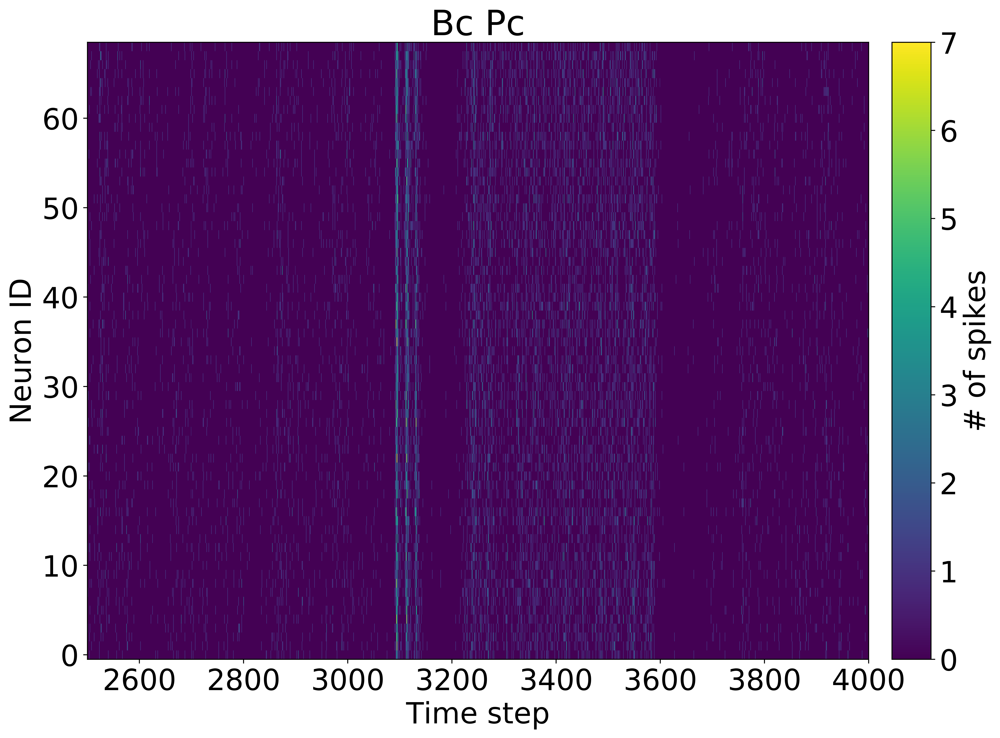

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_purkinje_sc_pc.png


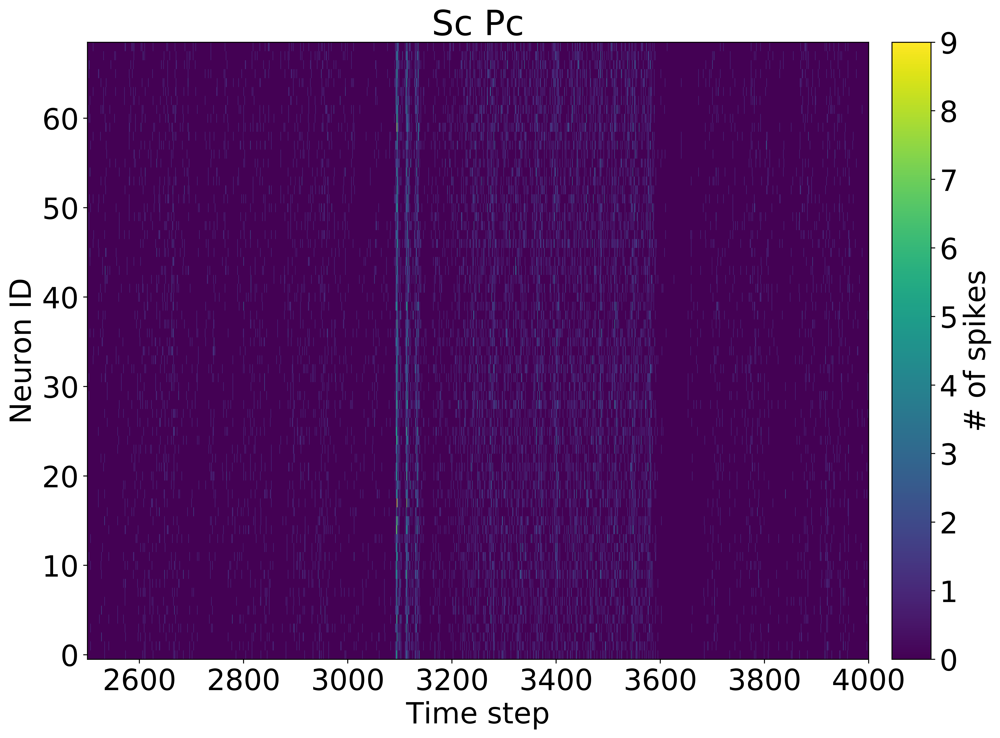

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_dcn_glom_dcn.png


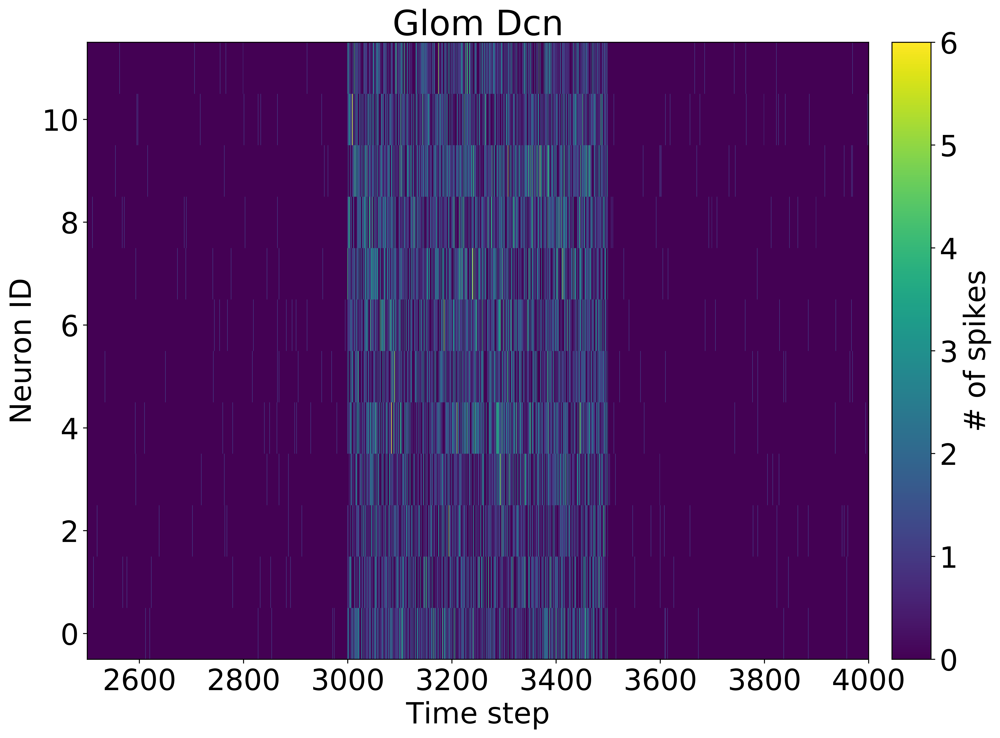

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/afferent_wcs_dcn_pc_dcn.png


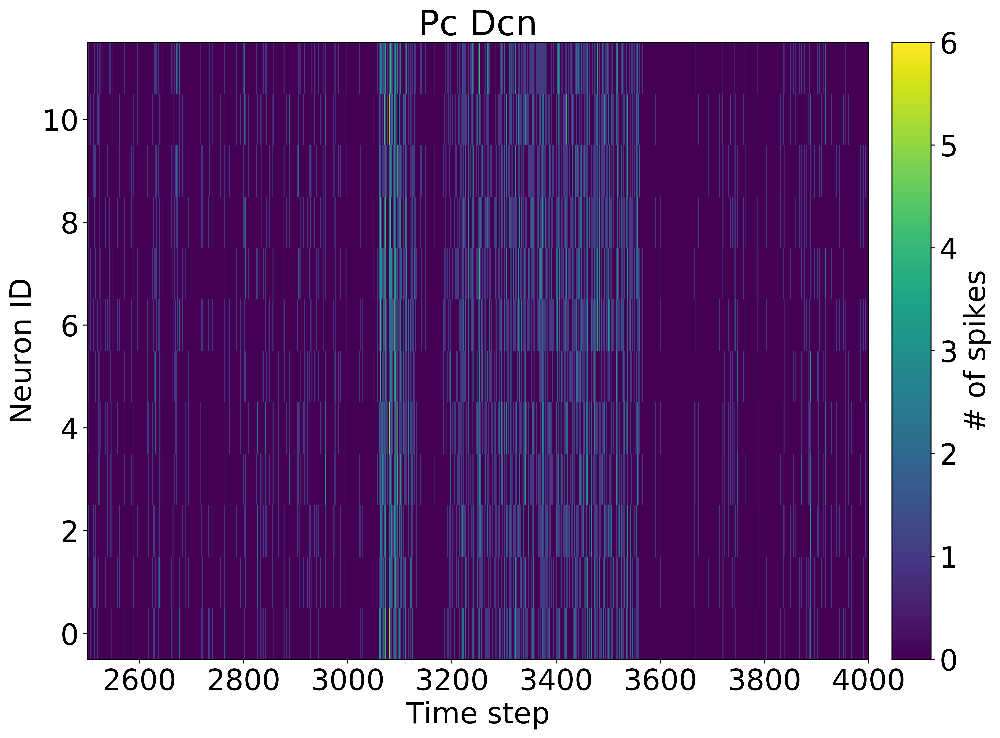

In [197]:
if conn_exists and worst_case:
    for pop in plot_order:
        for proj, worst_spikes  in per_conn_worst_spikes[pop].items():
            f = plt.figure(1, figsize=(12, 9), dpi=500)
            im = plt.imshow(worst_spikes,
                            interpolation='none',
#                             extent=[stim_wanted_times.min() * time_to_bin_conversion, stim_wanted_times.max() * time_to_bin_conversion,
#                                     0, worst_spikes.shape[0]],
                            origin='lower')
            ax = plt.gca()
            
            plt.title(use_display_name(proj))
            ax.set_aspect('auto')
            divider = make_axes_locatable(ax)
            cax = divider.append_axes("right", "5%", pad="3%")
            cbar = plt.colorbar(im, cax=cax)
            cbar.set_label("# of spikes")

            ax.set_xlabel("Time step")
            ax.set_ylabel("Neuron ID")
            
#             ax.set_xlim(2800, 3800)
            ax.set_xlim(stim_wanted_times.min() * time_to_bin_conversion,
             stim_wanted_times.max() * time_to_bin_conversion)
#             plt.xticks(stim_wanted_times * time_to_bin_conversion, stim_wanted_times)
#             ax.xticks(np.linspace(2800, 3800, 6))
#             ax.set_xticklabels([str(x) for x in (np.linspace(stim_wanted_times.min() * time_to_bin_conversion, stim_wanted_times.max() * time_to_bin_conversion, 6)/10)])
#             ax.set_xticklabels([str(x) for x in stim_wanted_times])
            save_figure(plt, os.path.join(sim_fig_folder,
                                          "afferent_wcs_{}_{}".format(pop, proj)),
#                         extensions=['.png', '.pdf'])
                        extensions=['.png', ])
            plt.show()
            plt.close(f)

# Compute statistics during stimulation

In [256]:
proj

'pc_dcn'

In [264]:
stim_period_start[pop]

310

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_glom_grc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_glom_grc.png


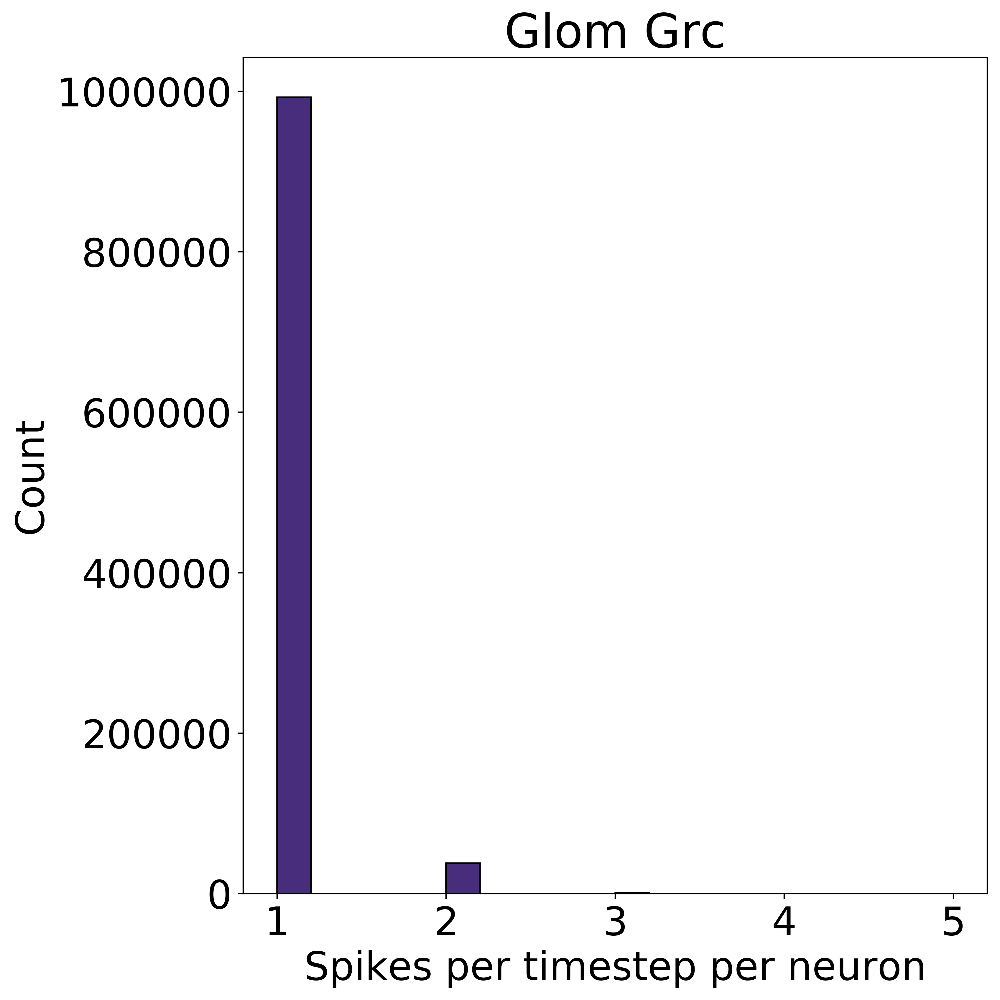

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_goc_grc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_goc_grc.png


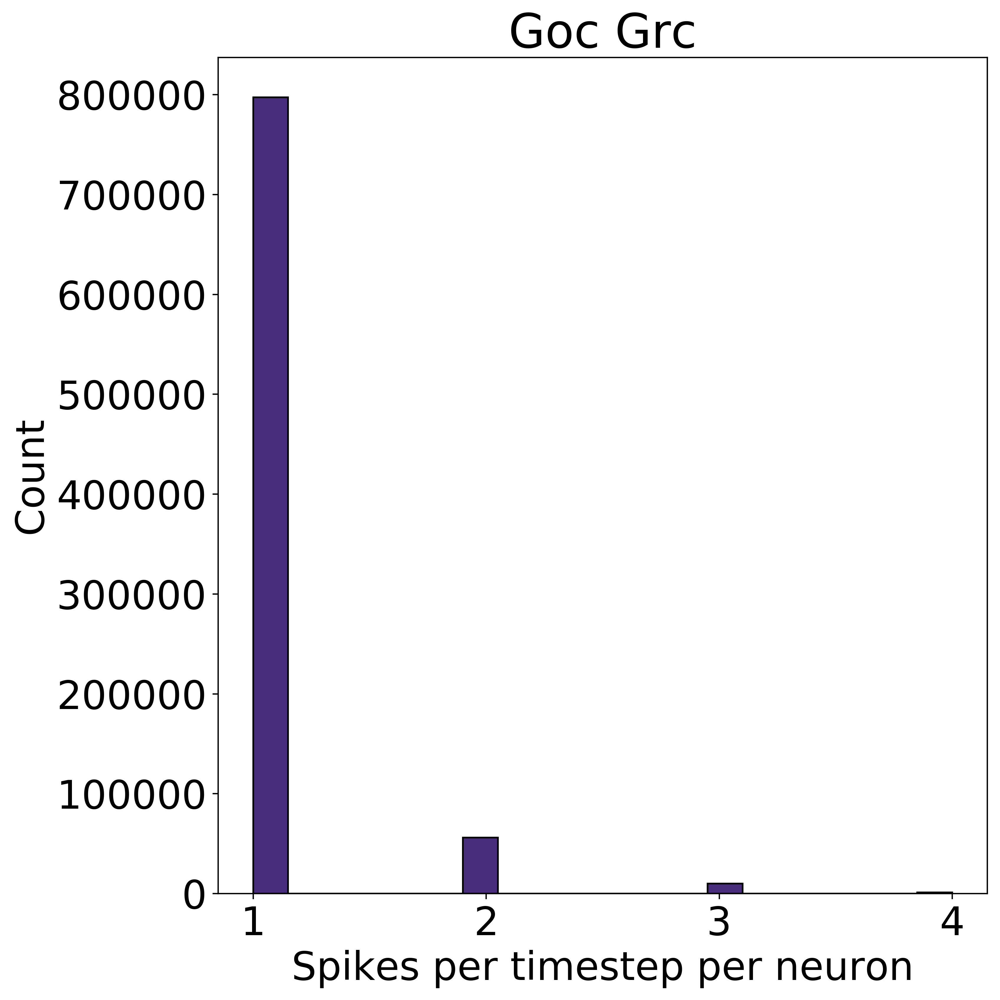

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_aa_goc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_aa_goc.png


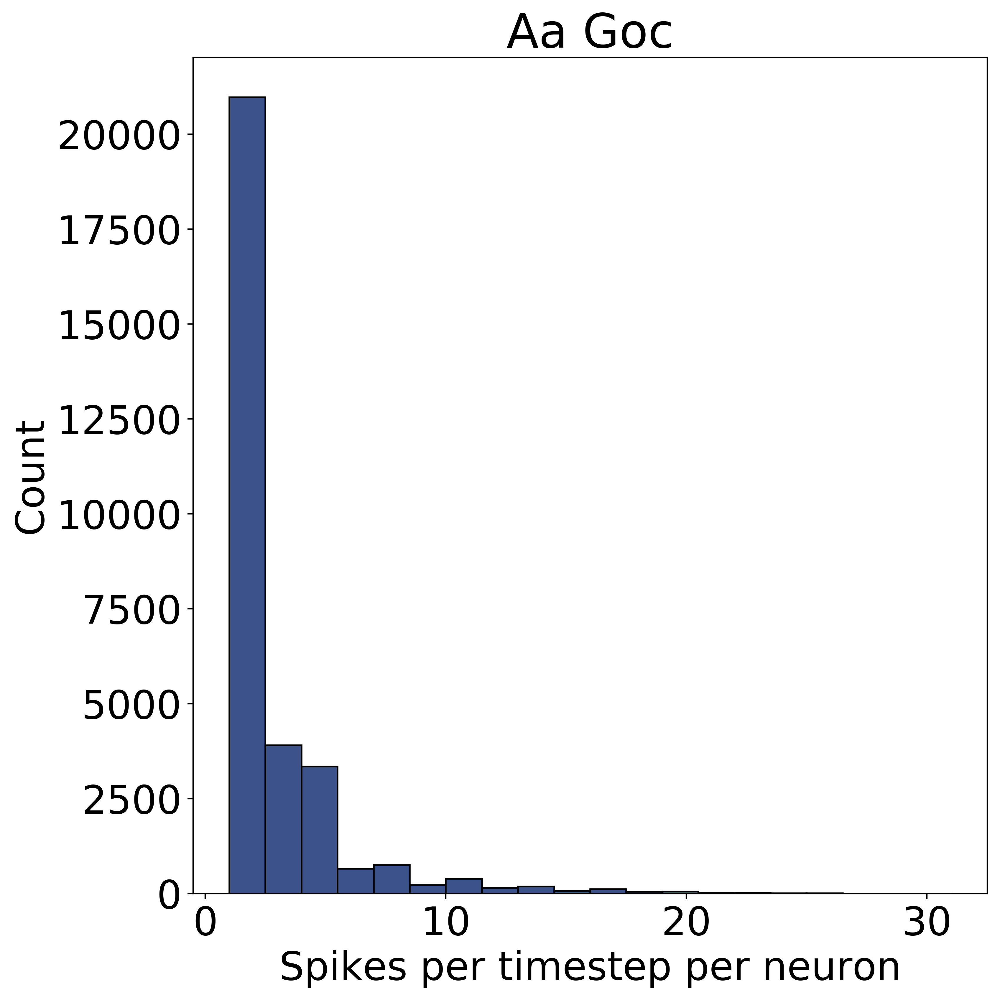

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_gj_goc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_gj_goc.png


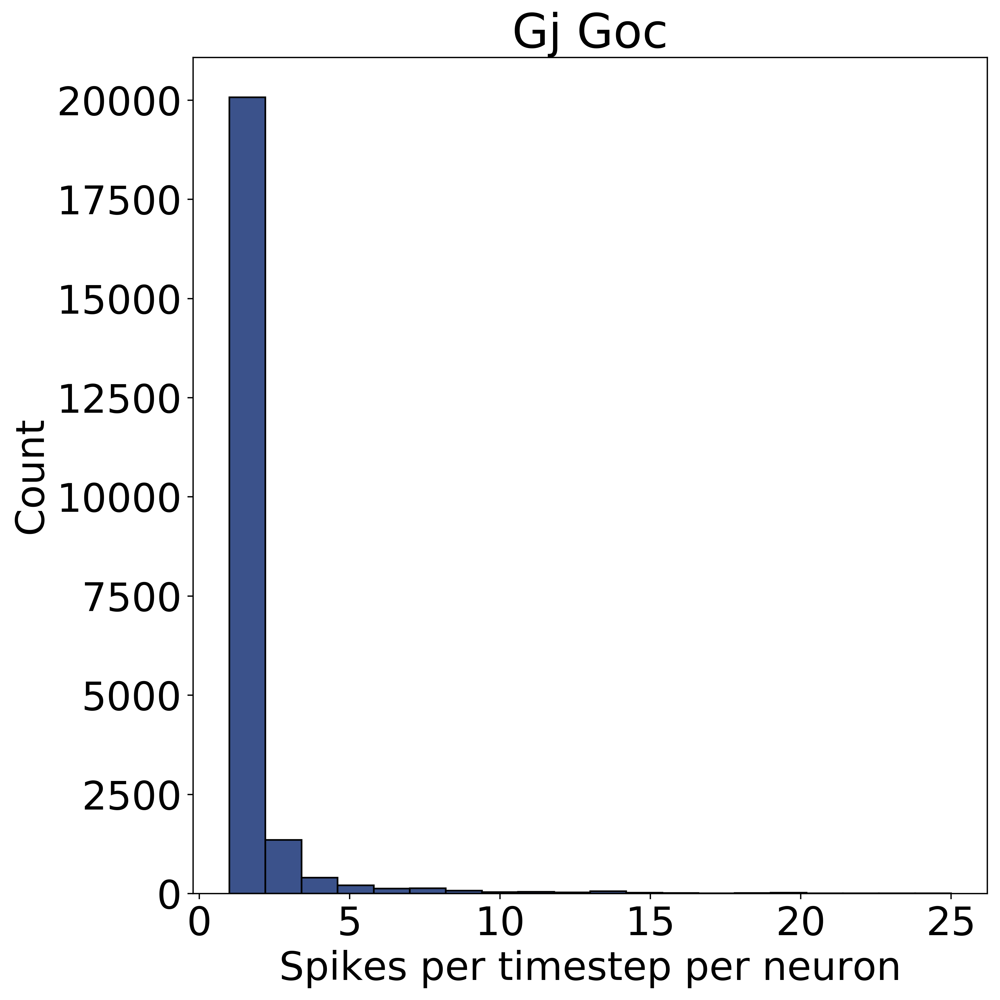

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_pf_goc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_pf_goc.png


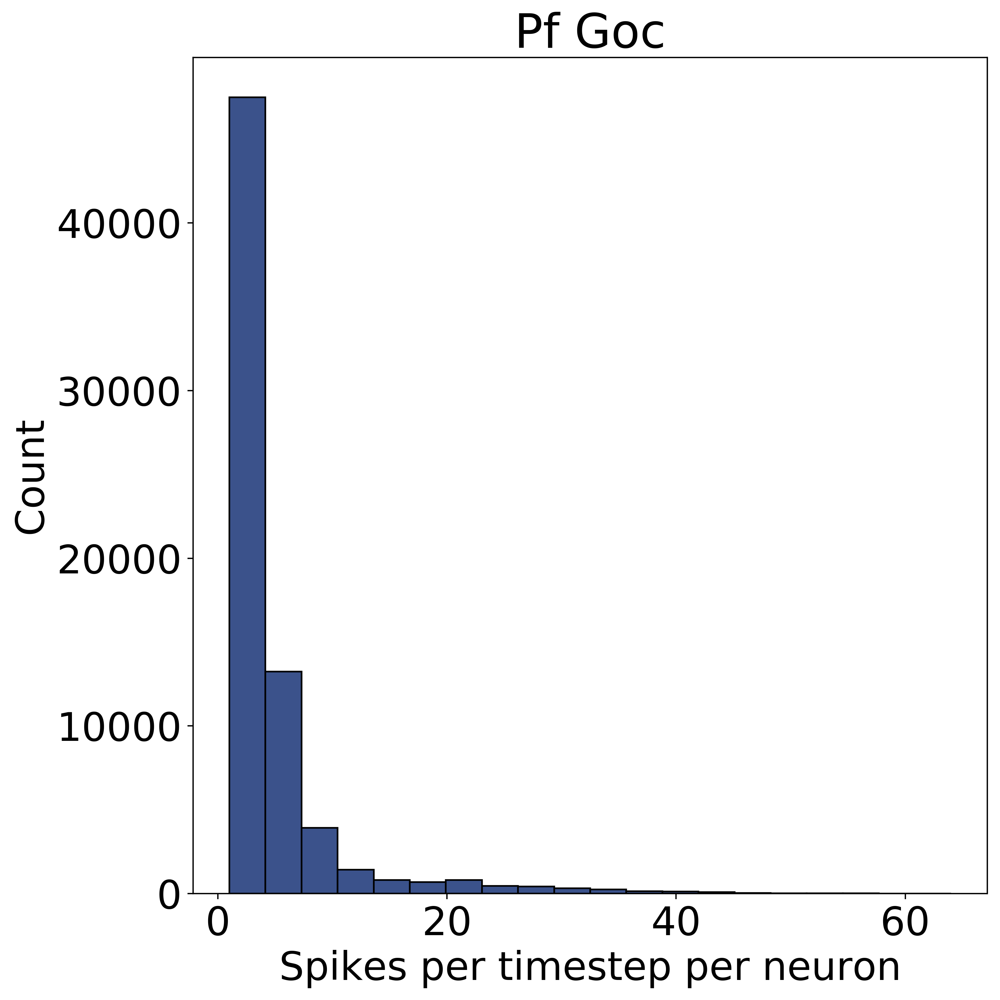

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_glom_goc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_glom_goc.png


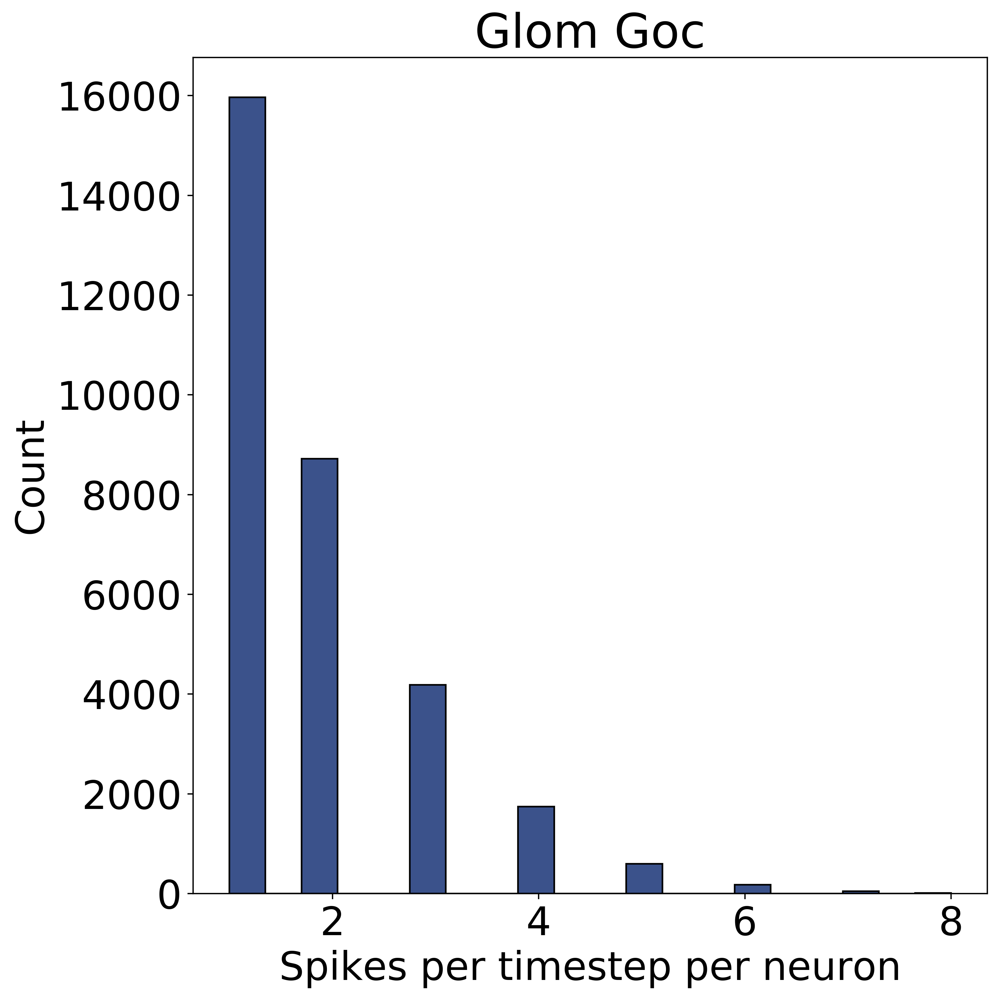

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_pf_sc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_pf_sc.png


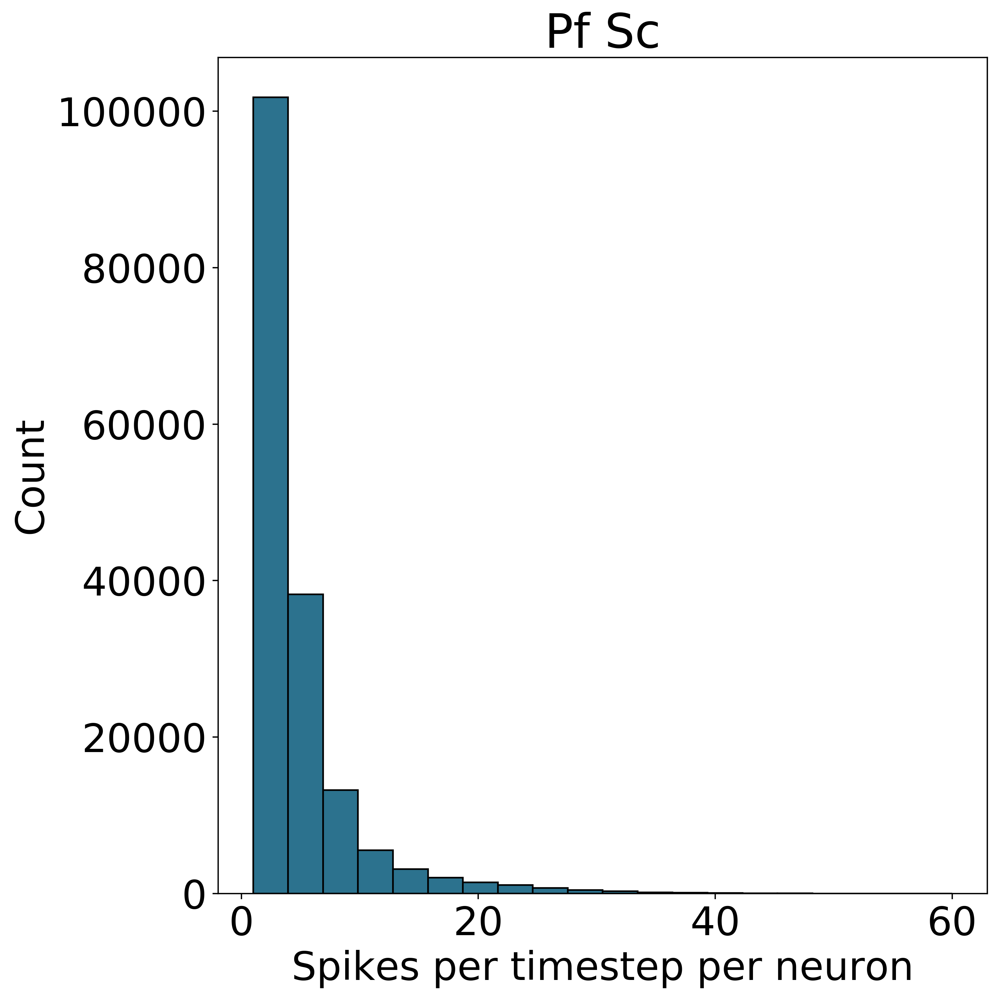

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_gj_sc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_gj_sc.png


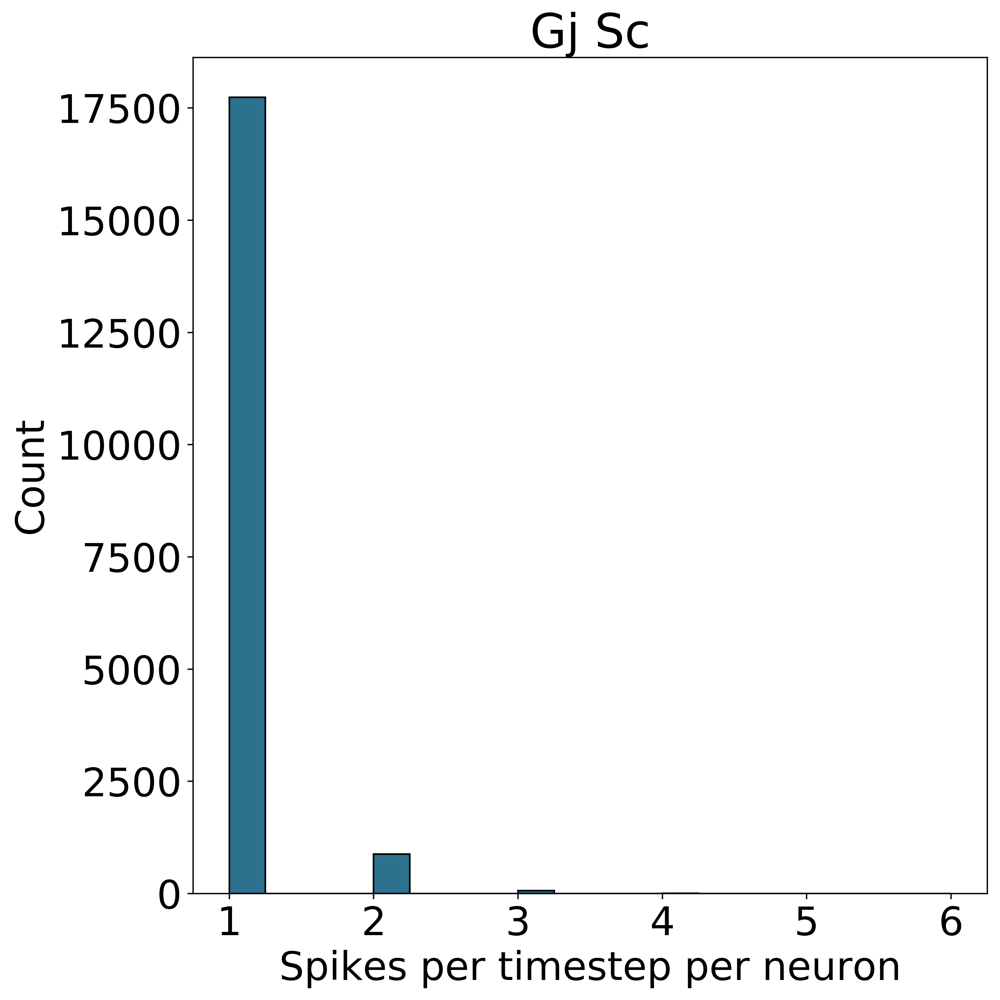

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_gj_bc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_gj_bc.png


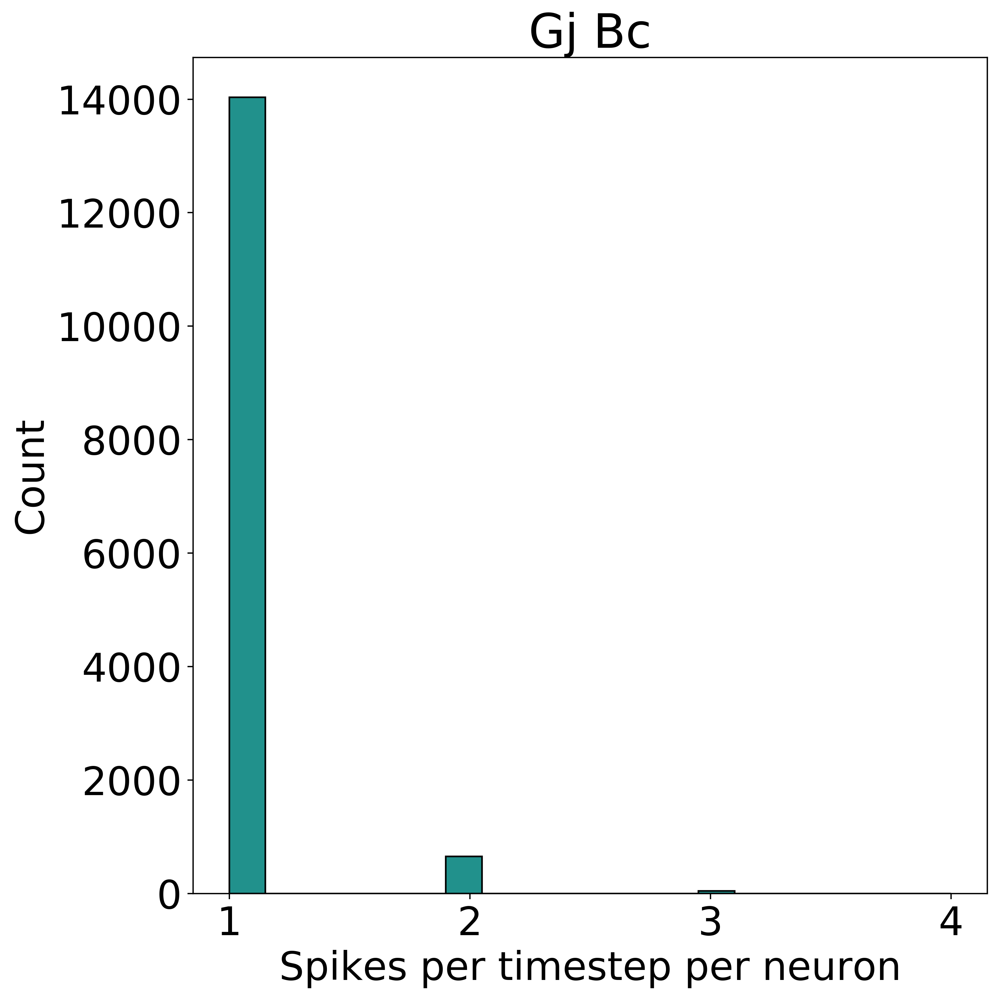

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_pf_bc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_pf_bc.png


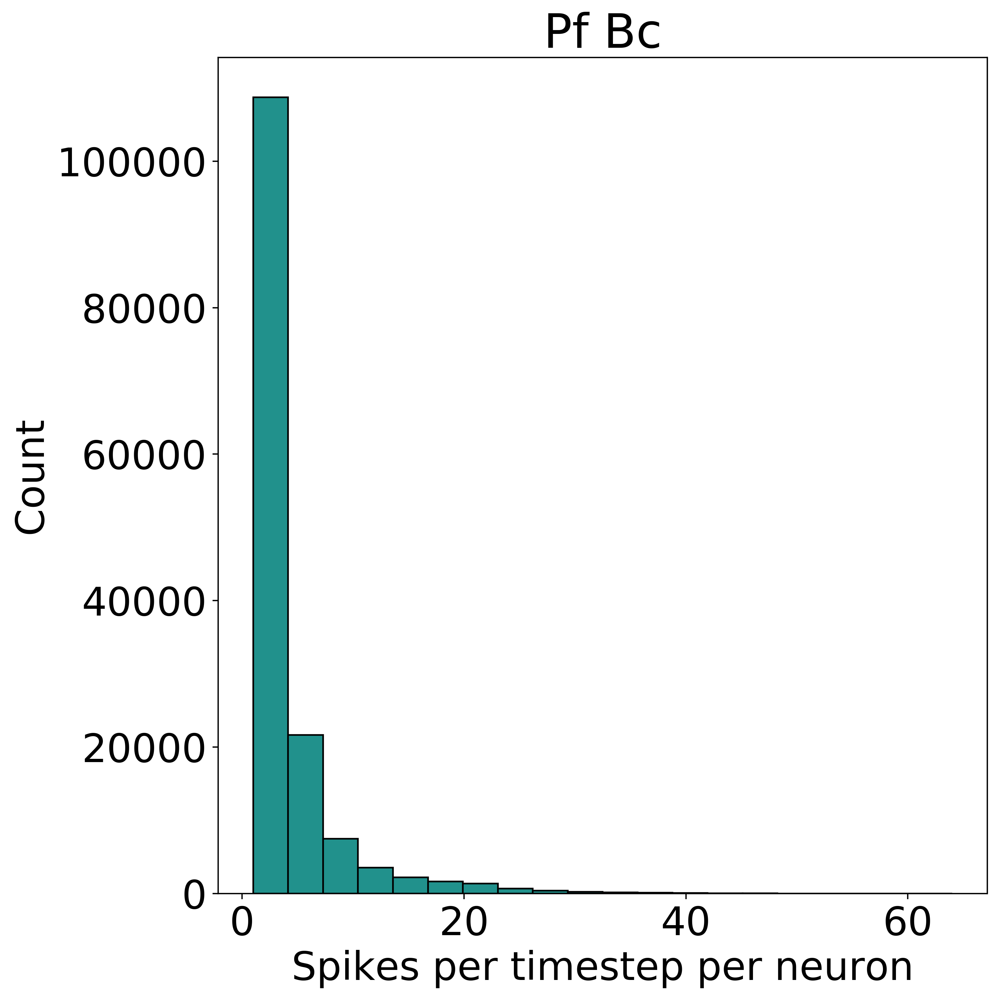

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_pf_pc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_pf_pc.png


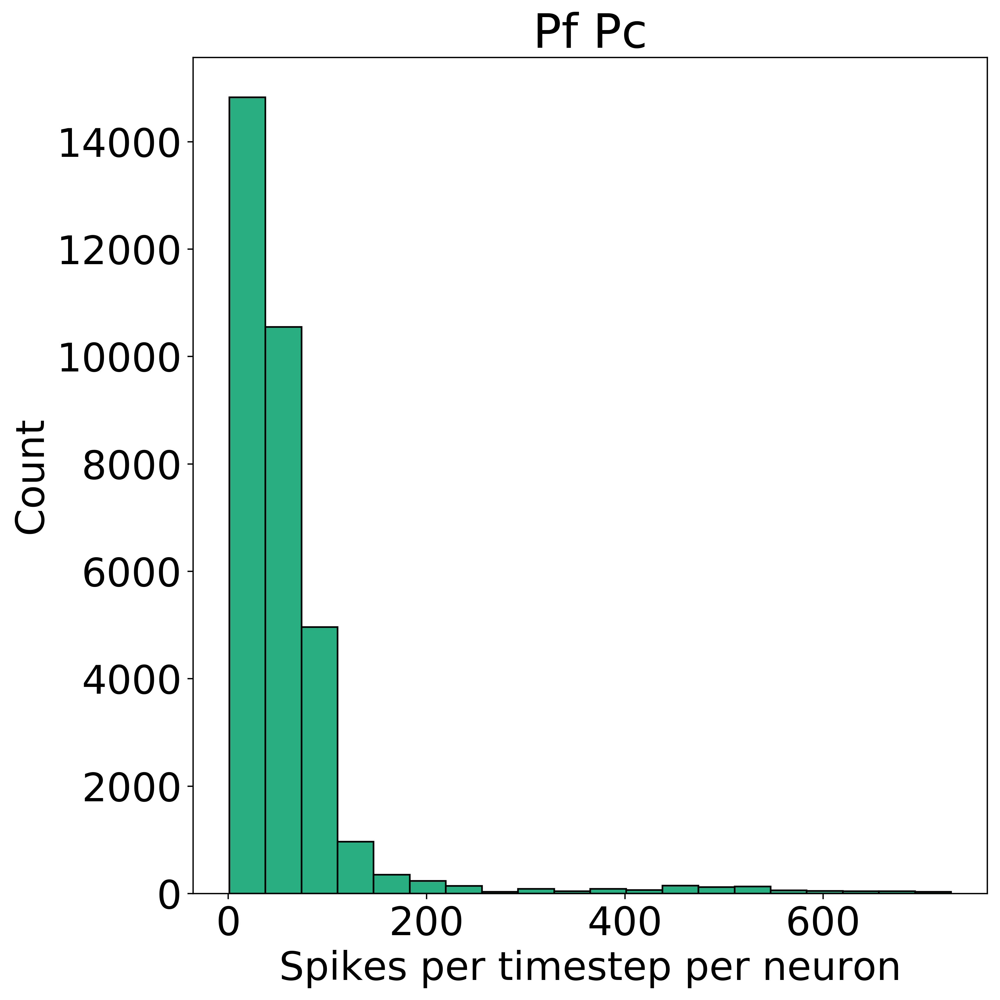

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_aa_pc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_aa_pc.png


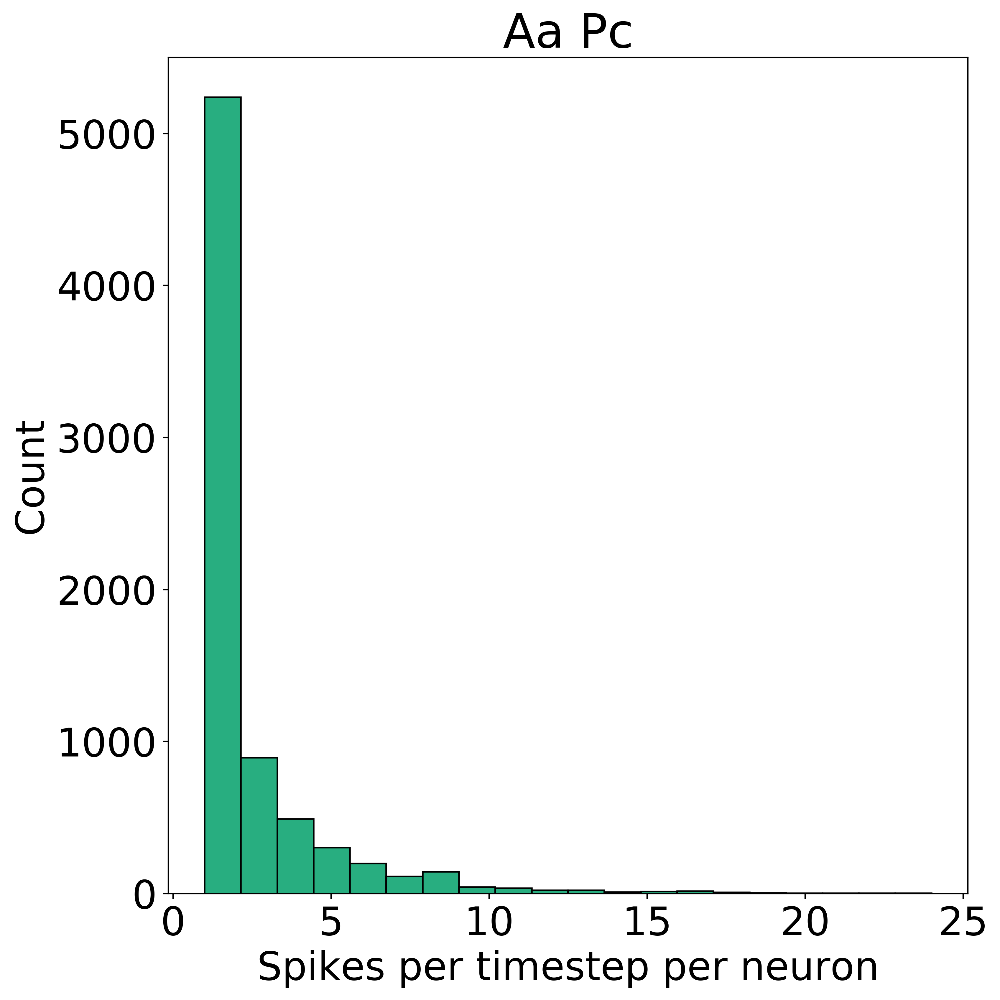

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_bc_pc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_bc_pc.png


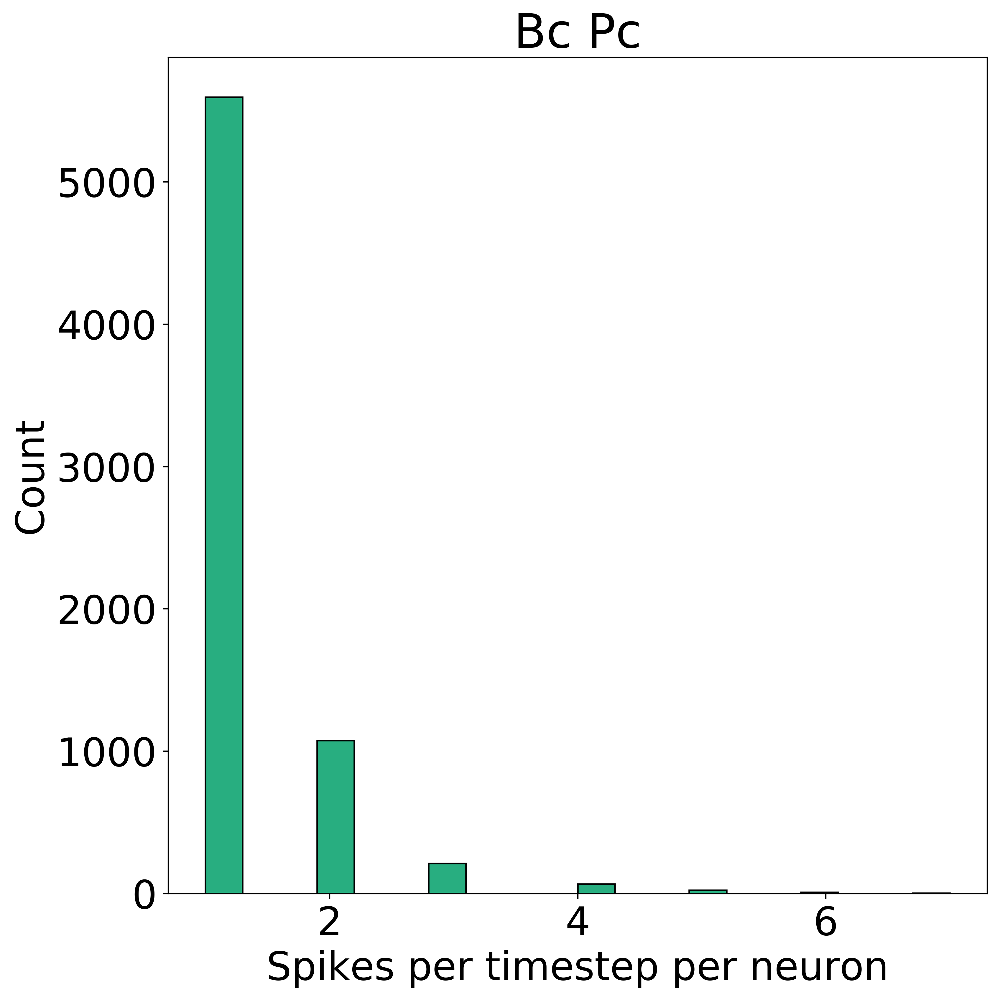

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_sc_pc.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_sc_pc.png


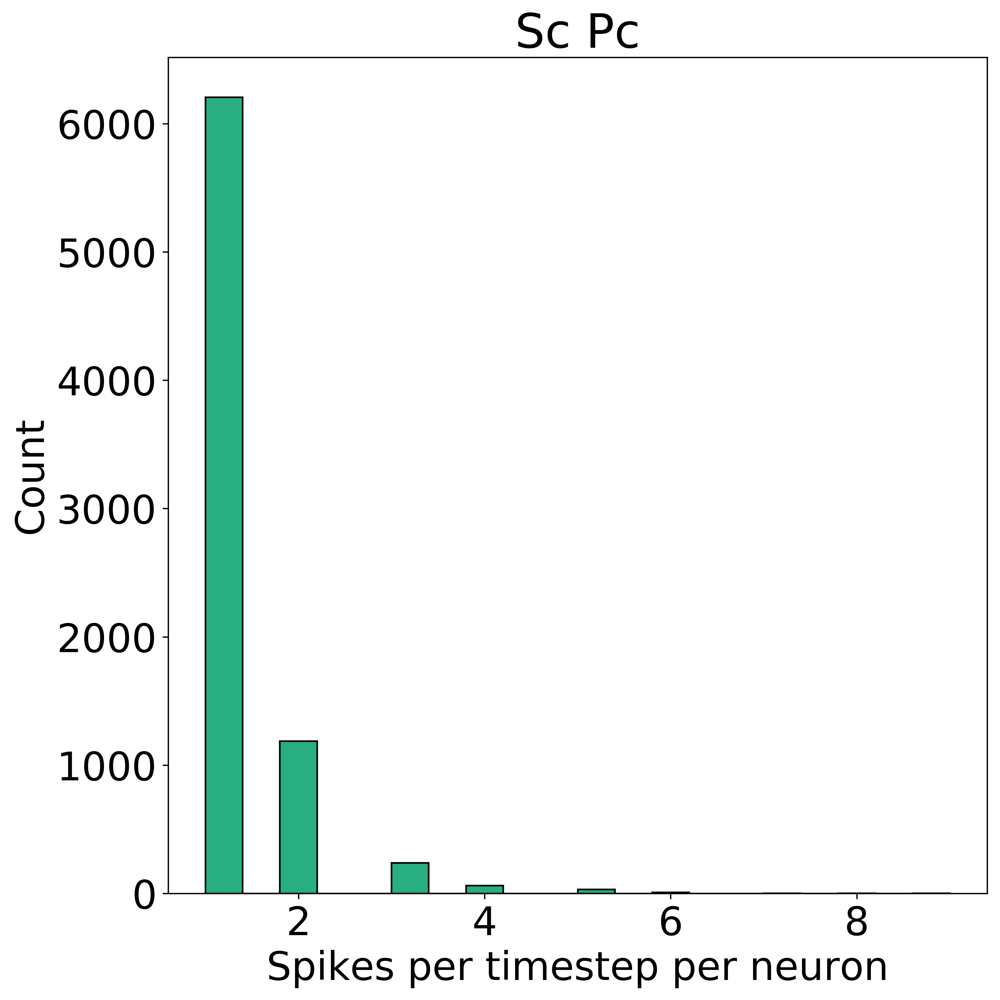

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_glom_dcn.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_glom_dcn.png


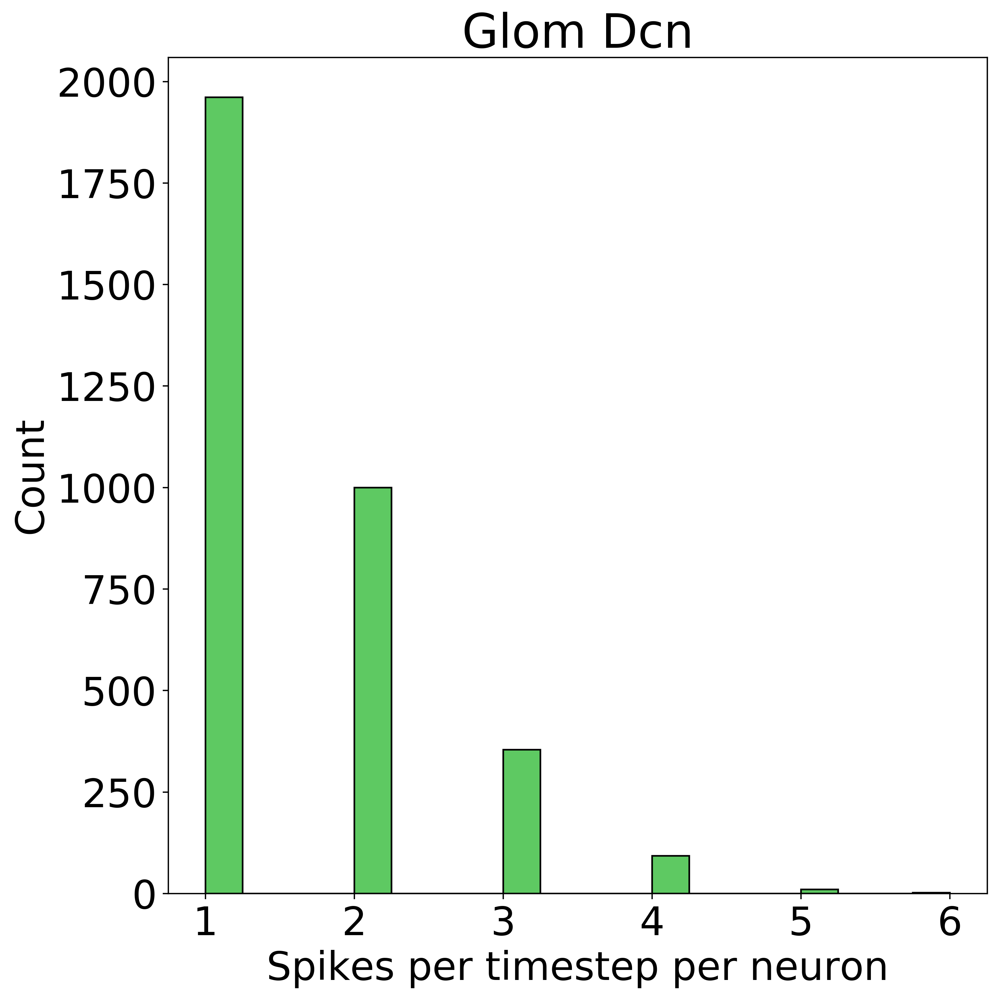

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_pc_dcn.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/spike_count_hist_pc_dcn.png


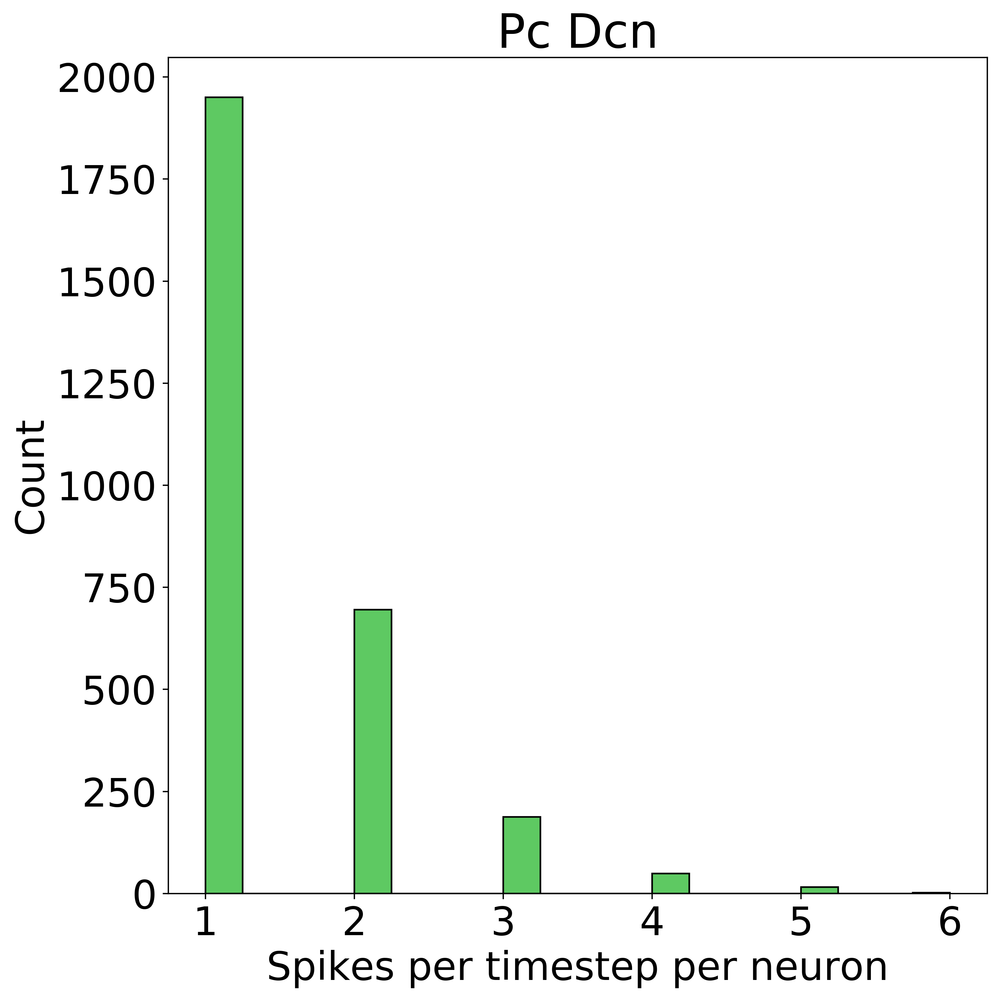

In [268]:
# Looking at number of spikes received per neuron for the purpose of computing Ring-Buffer left shifts to appropriately accomodate all (or most) spikes
# Need to compute max, mean, 0.1 percentile and 99 percentile DURING STIMULUS PHASE -- Is this useful?
spikes_per_proj_nutshell = {}
if conn_exists and worst_case:
    excel_filename = "per_projection_inc_spikes_description.xlsx"
    writer = pd.ExcelWriter(
    excel_filename,
    engine='xlsxwriter')
    for index, pop in enumerate(plot_order):
        for proj, worst_spikes  in per_conn_worst_spikes[pop].items():
            # need to filter worst spikes by timestep. Max wouldn't be affected, but all the other metrics would
            account_for_lack_of_delays = conn_params[proj]['delay'] * time_to_bin_conversion
            interval_of_interest = np.array(worst_spikes[:, 
                                                         int(stim_period_start[pop]*time_to_bin_conversion - account_for_lack_of_delays) :
                                                         int(stim_period_end[pop]*time_to_bin_conversion - account_for_lack_of_delays)])
            # remove zeros from this
            filterd_without_zeros = interval_of_interest[interval_of_interest!=0]
            percentile_01 = np.nanpercentile(filterd_without_zeros.ravel(), q=1)
            percentile_99 = np.nanpercentile(filterd_without_zeros.ravel(), q=99)
            mean = np.mean(filterd_without_zeros.ravel())
            std = np.std(filterd_without_zeros.ravel())
            maximums = np.max(filterd_without_zeros.ravel())
            spikes_per_proj_nutshell[proj] = [maximums, mean, std, percentile_01, percentile_99]
            
            # Also save a histogram
            f = plt.figure(1, figsize=(9, 9), dpi=400)
            plt.hist(filterd_without_zeros, bins=20, color=viridis_cmap(index / (n_plots + 1)),
                     rasterized=True,
                     edgecolor='k')

            plt.title(use_display_name(proj))

            plt.ylabel("Count")
            plt.xlabel("Spikes per timestep per neuron")
            plt.tight_layout()
            save_figure(
                plt,
                os.path.join(sim_fig_folder,
                             "spike_count_hist_{}").format(proj),
                extensions=[".pdf", ".png",])
            plt.show()
            plt.close(f)
            
    names =['max', 'mean', 'std', '1st percentile', '99th percentile'] 
    df = pd.DataFrame(spikes_per_proj_nutshell, index=names)
    df.to_excel(writer, sheet_name="per_proj_inc_spikes_description")
    writer.save()
    # SANITY CHECK! Do I get the same results if using Pandas describe() function?


# Try out networkx here

In [211]:
options = {
     'node_color': 'black',
     'node_size': 100,
     'width': 3,
}

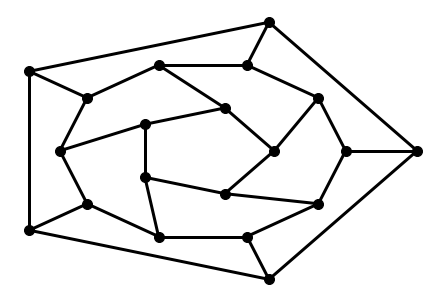

In [213]:
# Test that networkx (nx) works
G = nx.dodecahedral_graph()
shells = [[2, 3, 4, 5, 6], [8, 1, 0, 19, 18, 17, 16, 15, 14, 7], [9, 10, 11, 12, 13]]
nx.draw_shell(G, nlist=shells, **options)

In [245]:
# test that I can make the connection from PC to DCN (need to start smaller than PF-PC)
circuit_graph = nx.MultiDiGraph()

node_pc = nx.Graph()
node_pc.add_nodes_from(np.arange(all_neurons['purkinje']))
circuit_graph.add_nodes_from(node_pc)
node_dcnc = nx.Graph()
node_dcnc.add_nodes_from(np.arange(all_neurons['dcn']) + all_neurons['purkinje'])

circuit_graph.add_nodes_from(node_dcnc)

In [246]:
node_dcnc.nodes

NodeView((69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80))

In [247]:
node_dcnc.edges()

EdgeView([])

In [248]:
circuit_graph.number_of_nodes()

81

In [249]:
node_dcnc.number_of_edges()

0

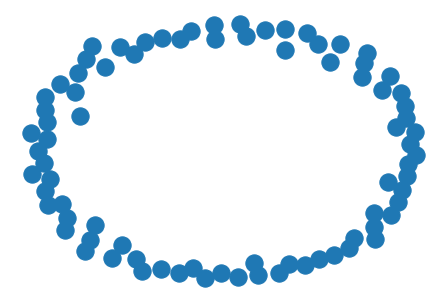

In [250]:
nx.draw(circuit_graph)

# Looking at individual neuron's afferents

In [621]:
def imshow_hist(x, ax, ax_histx, ax_histy):
    # no labels
    ax_histx.tick_params(axis="x", labelbottom=False)
    ax_histy.tick_params(axis="y", labelleft=False)

    # the scatter plot:
#     ax.scatter(x, y)
    ax.imshow(x)

    # now determine nice limits by hand:
    binwidth = 1
    xymax = np.nanmax(np.nanmax(np.abs(x)))
    lim = (int(xymax/binwidth) + 1) * binwidth

    bins = np.arange(-lim, lim + binwidth, binwidth)
    ax_histx.bar(np.arange(l), 
        height=np.nansum(x, axis=0), 
        width=1., 
#         edgecolor='black'
       )
    ax_histy.barh(np.arange(l), 
        height=1., 
        width=np.nansum(x, axis=1), 
#         edgecolor='black'
       )
    ax.set_xlim([0, x.shape[1]])
    ax.set_ylim([0, x.shape[0]])



In [376]:
per_neuron_figs = os.path.join(sim_fig_folder, "per_neuron_figs")
if not os.path.isdir(per_neuron_figs) and not os.path.exists(per_neuron_figs):
    os.mkdir(per_neuron_figs)

POST glomerulus
POST granule
	PROJ glom_grc
	PRE glomerulus
--------------------------------------------------------------------------------


Traceback (most recent call last):
  File "<ipython-input-377-866c6fdf50f5>", line 42, in <module>
    str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
AssertionError: 4vs.5.0


Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_74179_from_proj_glom_grc.png


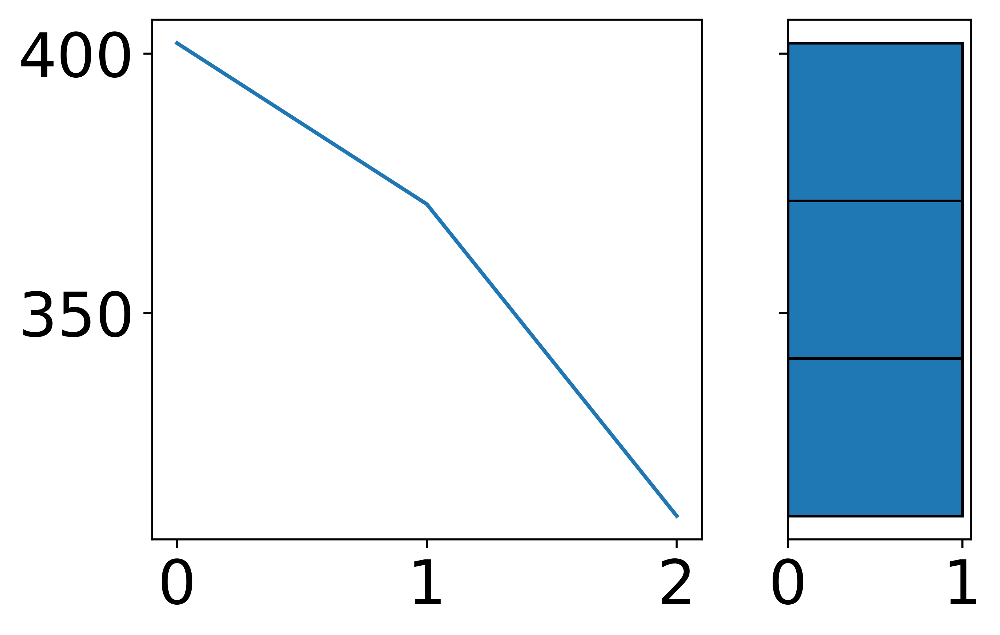

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_74179_from_proj_glom_grc.png


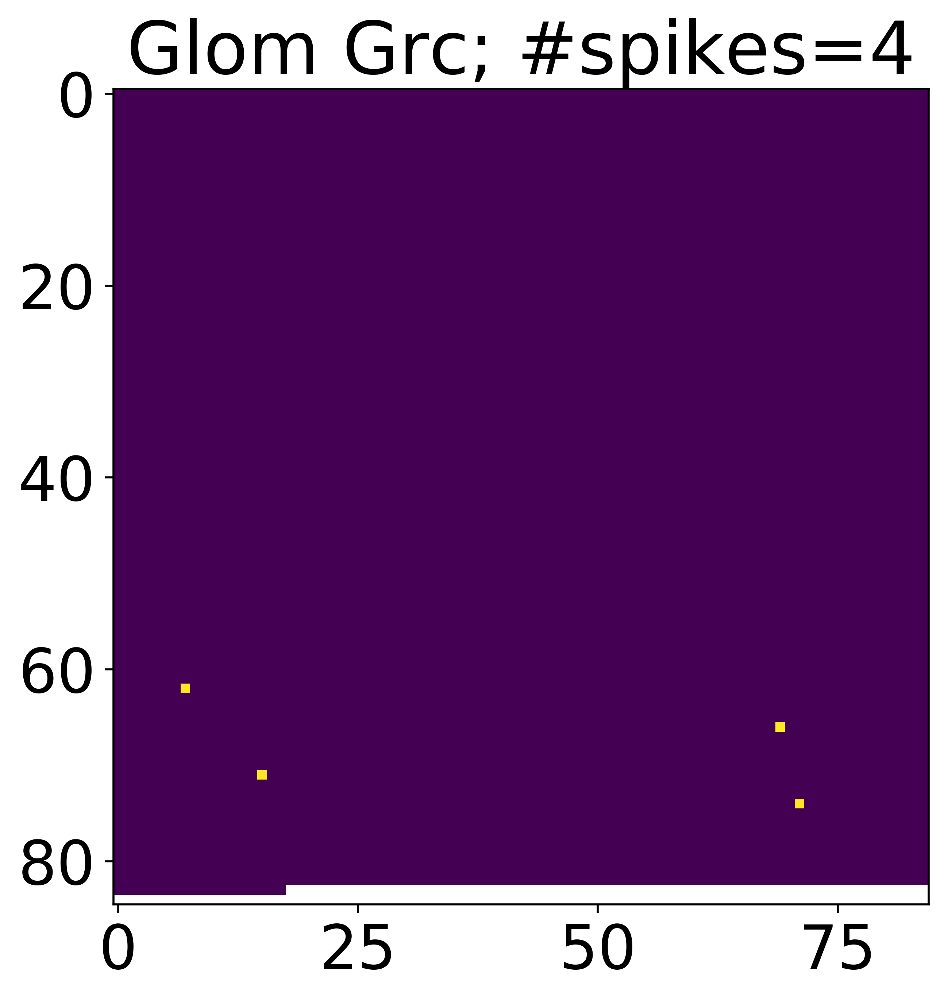

Traceback (most recent call last):
  File "<ipython-input-377-866c6fdf50f5>", line 42, in <module>
    str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
AssertionError: 3vs.4.0


Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_74180_from_proj_glom_grc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_74180_from_proj_glom_grc.png


Traceback (most recent call last):
  File "<ipython-input-377-866c6fdf50f5>", line 42, in <module>
    str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
AssertionError: 2vs.4.0


Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_36705_from_proj_glom_grc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_36705_from_proj_glom_grc.png


Traceback (most recent call last):
  File "<ipython-input-377-866c6fdf50f5>", line 42, in <module>
    str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
AssertionError: 3vs.4.0


Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_32818_from_proj_glom_grc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_32818_from_proj_glom_grc.png


Traceback (most recent call last):
  File "<ipython-input-377-866c6fdf50f5>", line 42, in <module>
    str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
AssertionError: 2vs.4.0


Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_64715_from_proj_glom_grc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_64715_from_proj_glom_grc.png
	PROJ goc_grc
	PRE golgi
--------------------------------------------------------------------------------
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_84422_from_proj_goc_grc.png


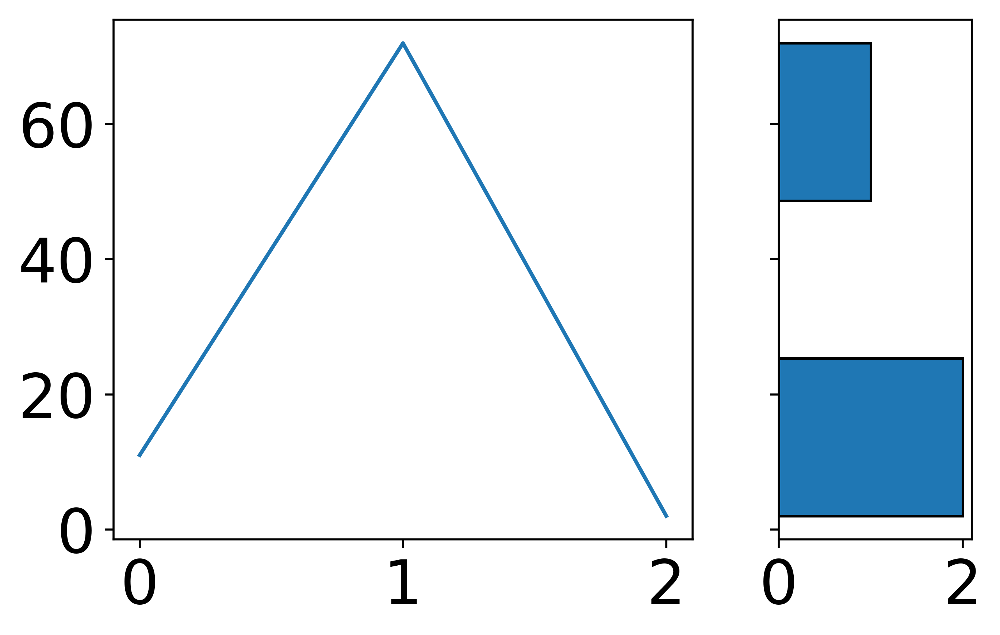

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_84422_from_proj_goc_grc.png


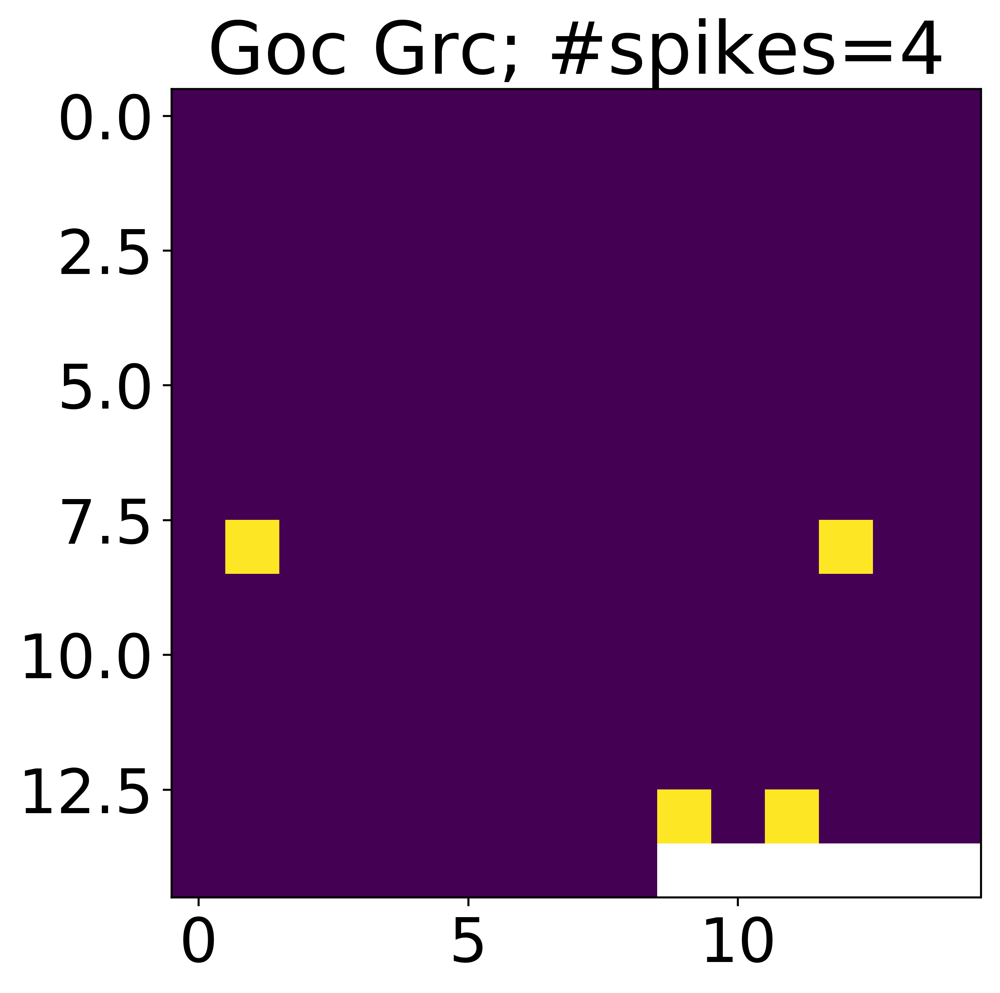

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_58159_from_proj_goc_grc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_58159_from_proj_goc_grc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_73579_from_proj_goc_grc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_73579_from_proj_goc_grc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_30677_from_proj_goc_grc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_30677_from_proj_goc_grc

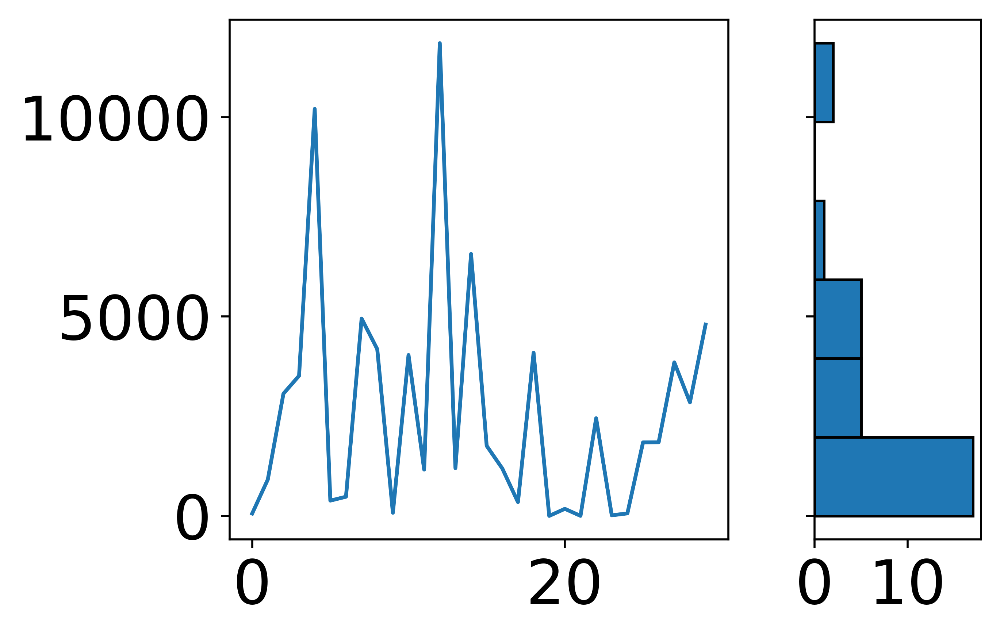

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_141_from_proj_aa_goc.png


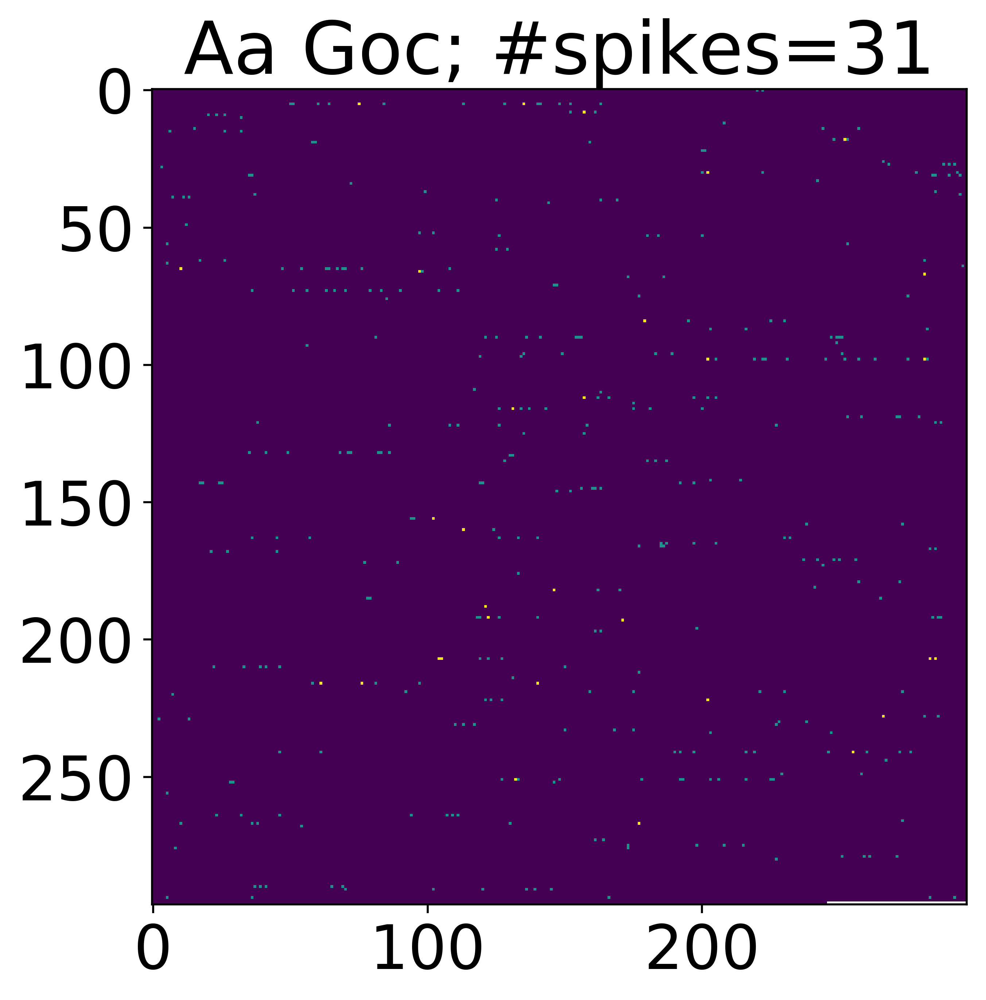

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_0_from_proj_aa_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_0_from_proj_aa_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_168_from_proj_aa_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_168_from_proj_aa_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_196_from_proj_aa_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_196_from_proj_aa_goc.png
Plotting         

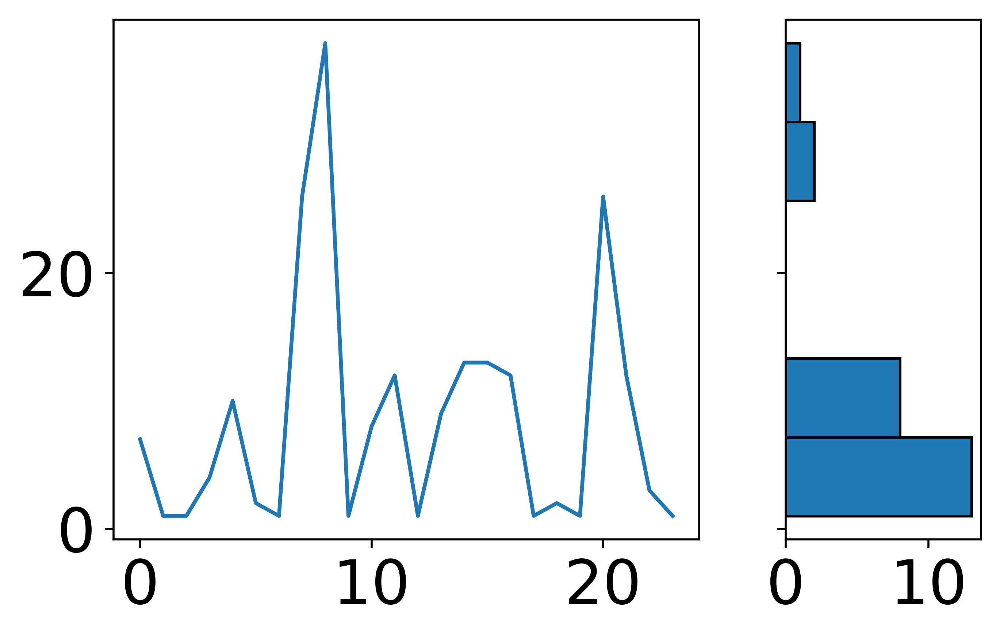

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_166_from_proj_gj_goc.png


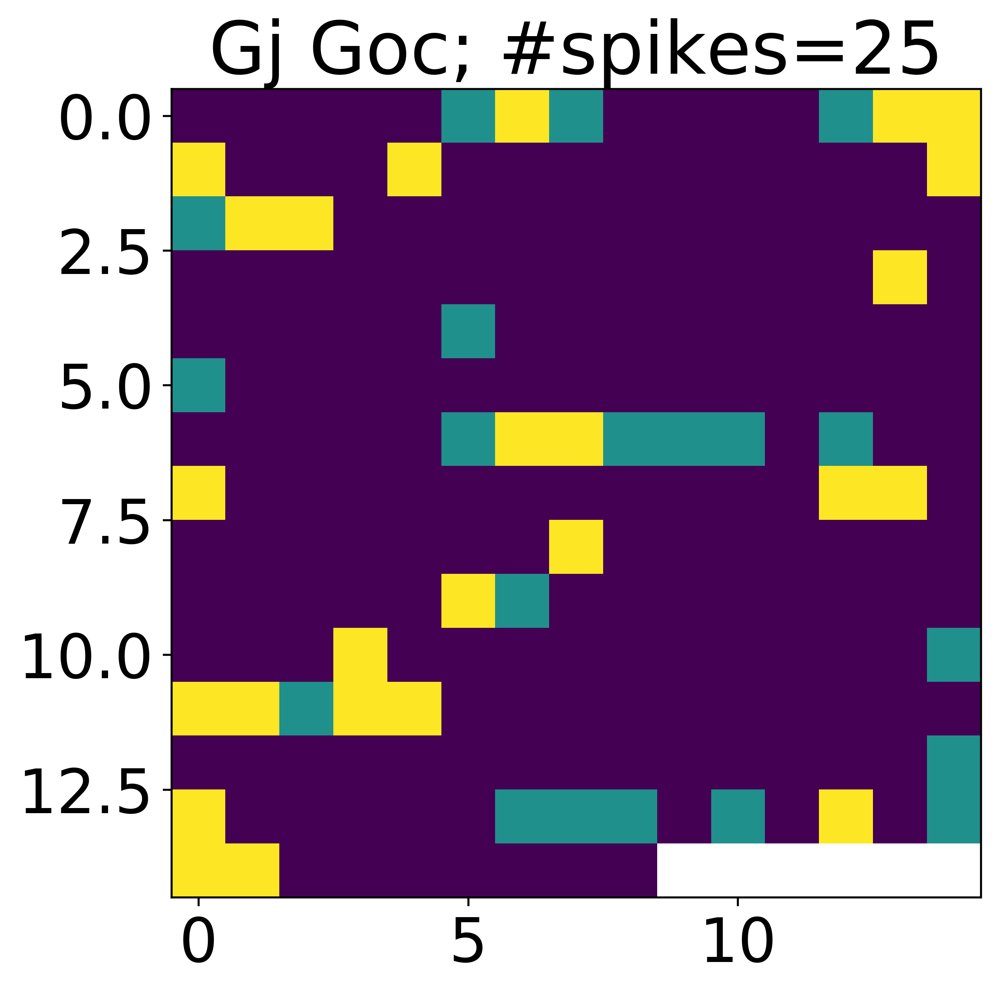

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_194_from_proj_gj_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_194_from_proj_gj_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_96_from_proj_gj_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_96_from_proj_gj_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_30_from_proj_gj_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_30_from_proj_gj_goc.png
Plotting         

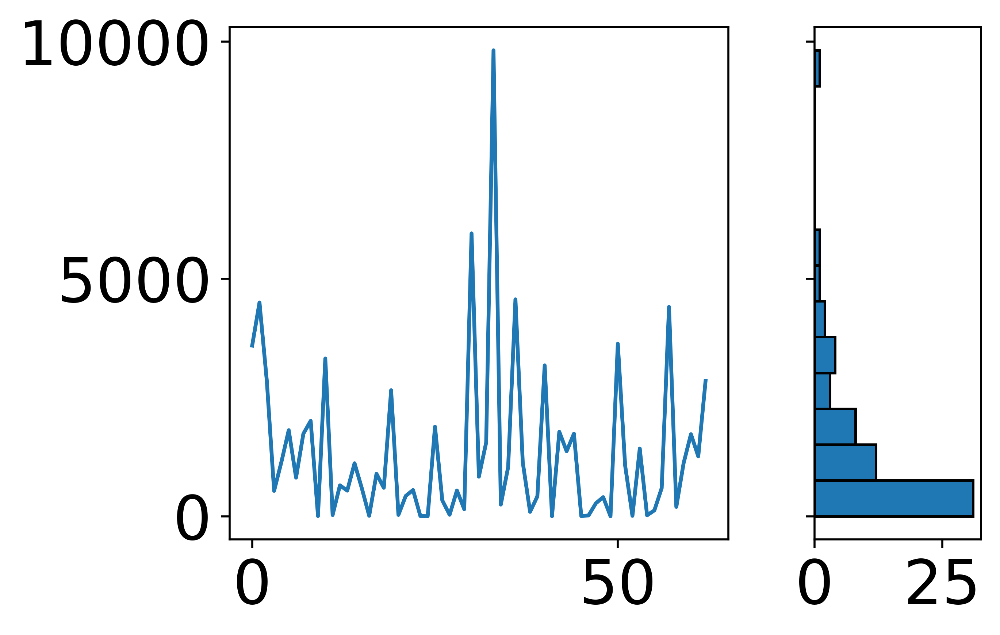

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_30_from_proj_pf_goc.png


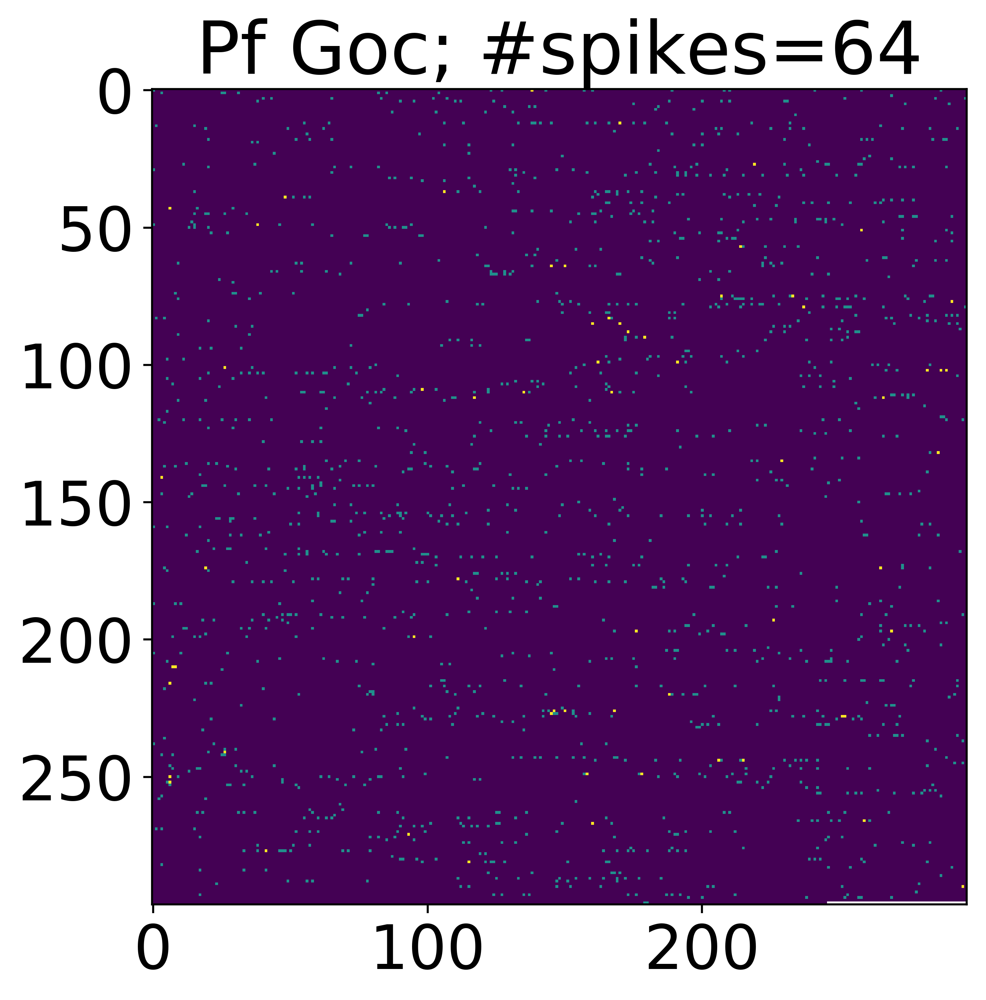

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_97_from_proj_pf_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_97_from_proj_pf_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_210_from_proj_pf_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_210_from_proj_pf_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_141_from_proj_pf_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_141_from_proj_pf_goc.png
Plotting       

Traceback (most recent call last):
  File "<ipython-input-377-866c6fdf50f5>", line 42, in <module>
    str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
AssertionError: 7vs.8.0


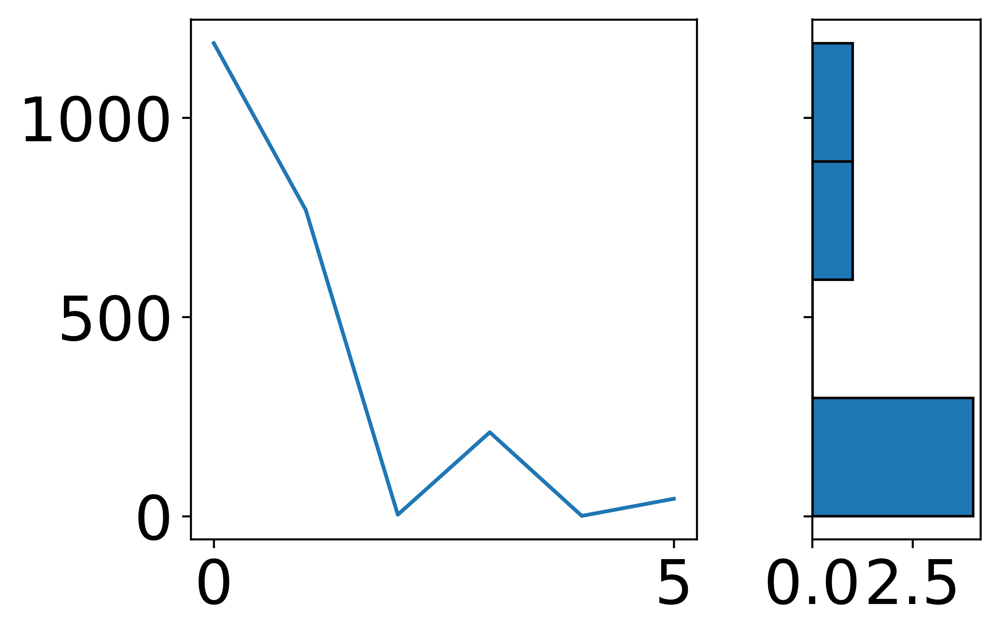

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_140_from_proj_glom_goc.png


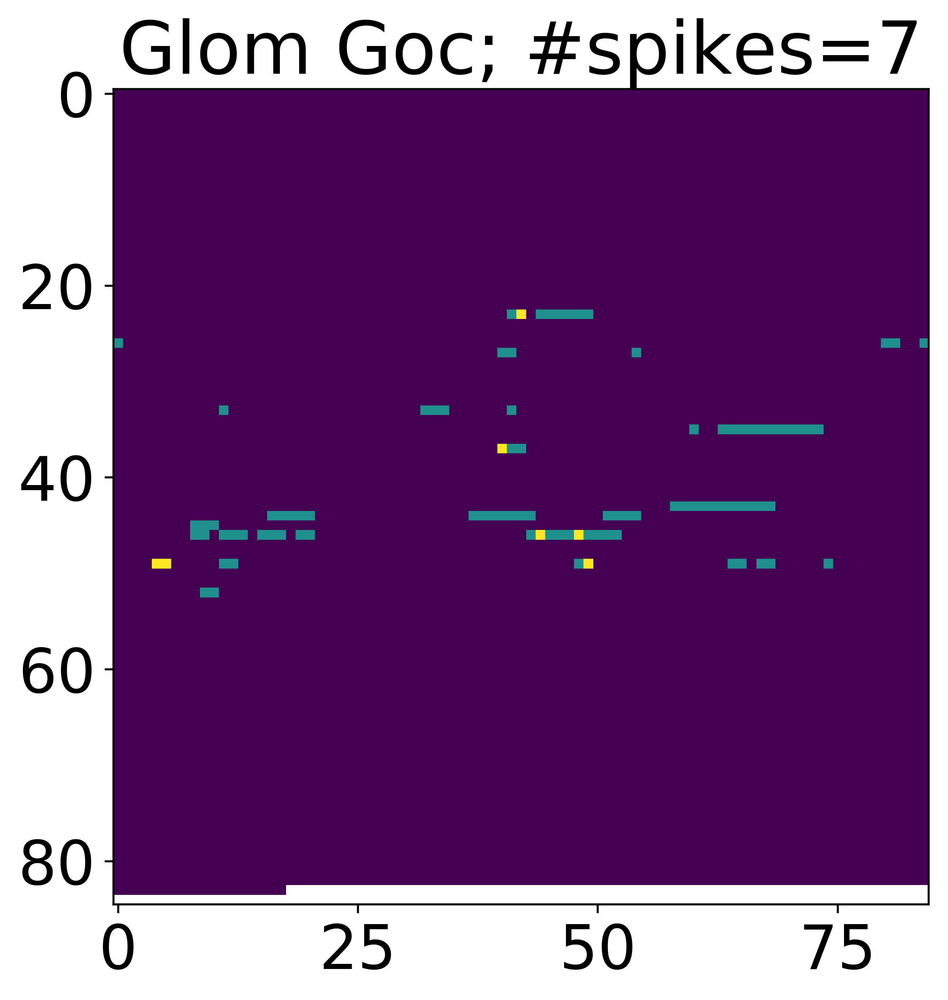

Traceback (most recent call last):
  File "<ipython-input-377-866c6fdf50f5>", line 42, in <module>
    str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
AssertionError: 7vs.8.0


Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_115_from_proj_glom_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_115_from_proj_glom_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_117_from_proj_glom_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_117_from_proj_glom_goc.png


Traceback (most recent call last):
  File "<ipython-input-377-866c6fdf50f5>", line 42, in <module>
    str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
AssertionError: 7vs.8.0


Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_120_from_proj_glom_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_120_from_proj_glom_goc.png


Traceback (most recent call last):
  File "<ipython-input-377-866c6fdf50f5>", line 42, in <module>
    str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
AssertionError: 7vs.8.0


Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_127_from_proj_glom_goc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_127_from_proj_glom_goc.png
POST stellate
	PROJ pf_sc
	PRE granule
--------------------------------------------------------------------------------
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_22_from_proj_pf_sc.png


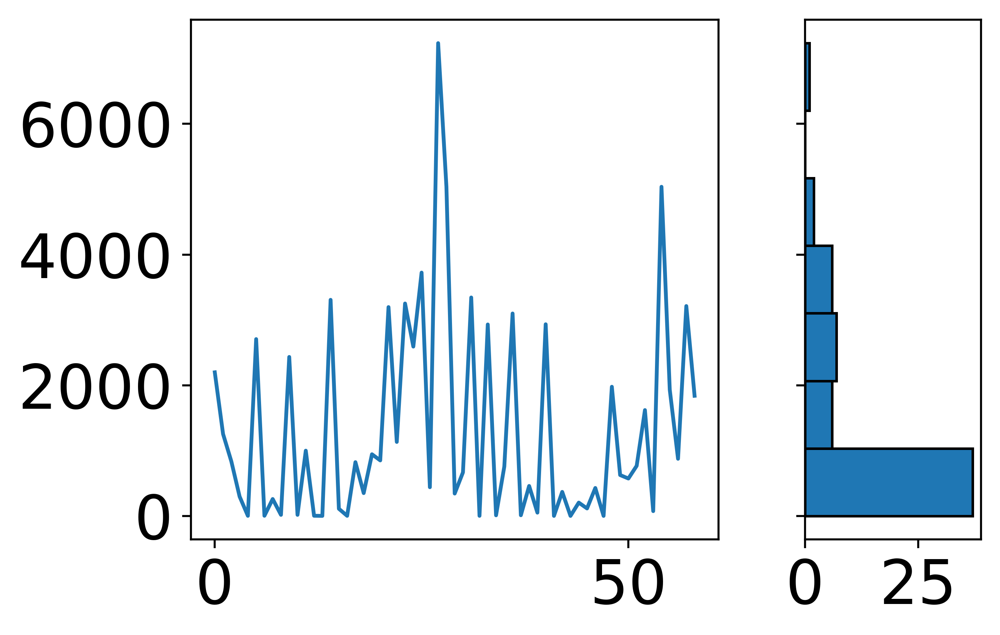

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_22_from_proj_pf_sc.png


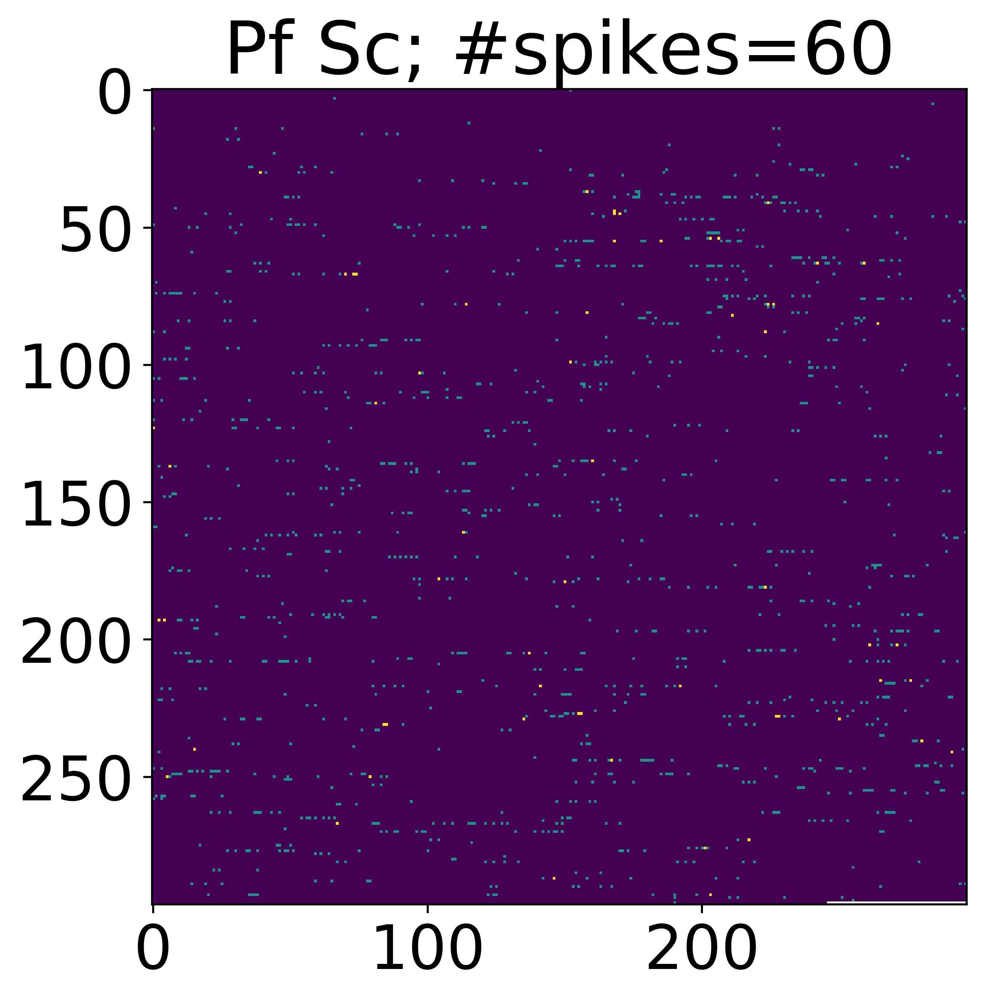

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_28_from_proj_pf_sc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_28_from_proj_pf_sc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_32_from_proj_pf_sc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_32_from_proj_pf_sc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_109_from_proj_pf_sc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_109_from_proj_pf_sc.png
Plotting               

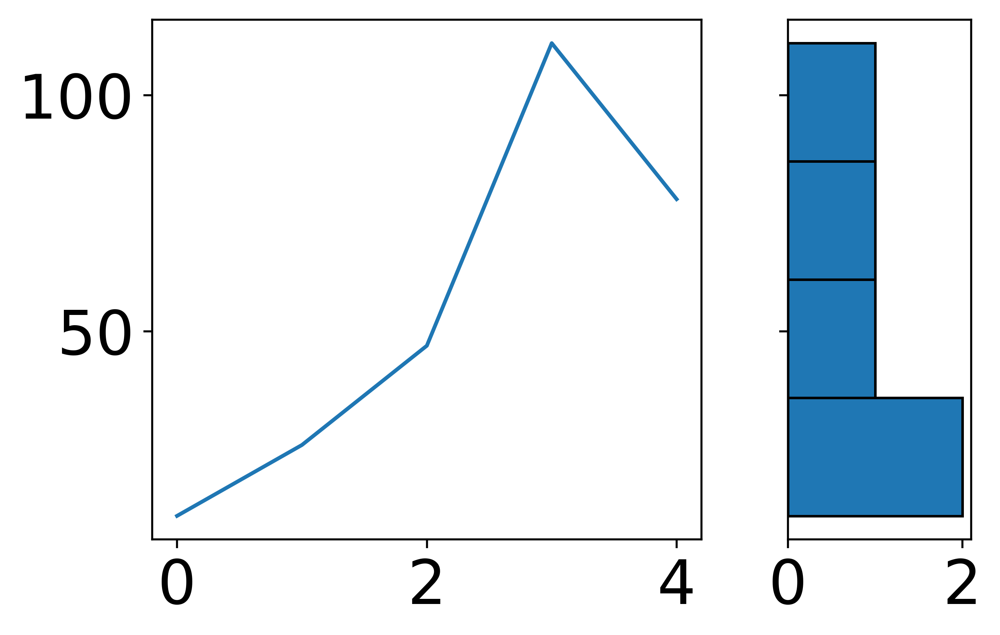

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_16_from_proj_gj_sc.png


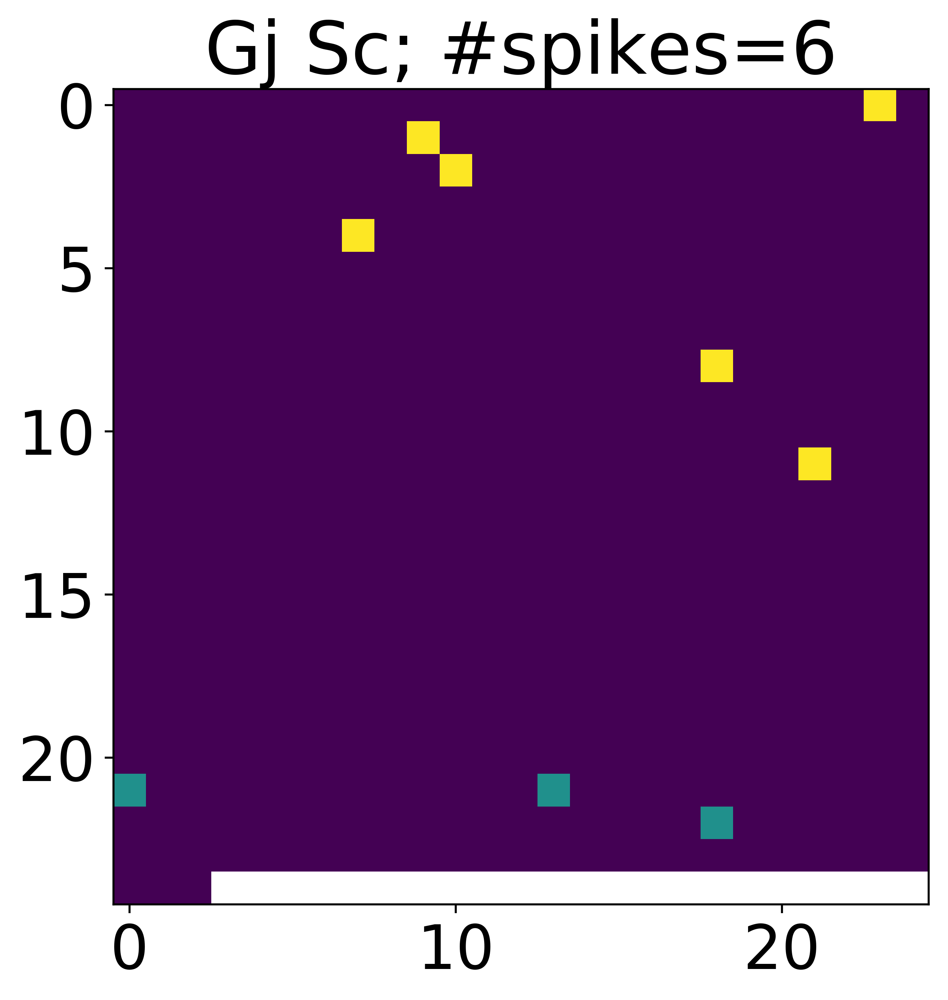

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_538_from_proj_gj_sc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_538_from_proj_gj_sc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_55_from_proj_gj_sc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_55_from_proj_gj_sc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_310_from_proj_gj_sc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_310_from_proj_gj_sc.png
Plotting             

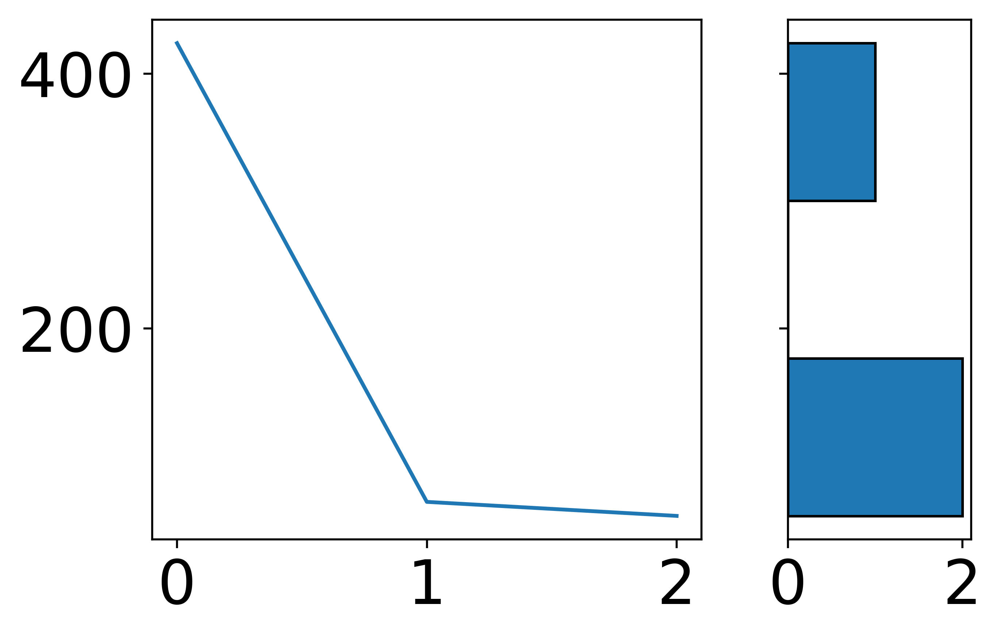

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_463_from_proj_gj_bc.png


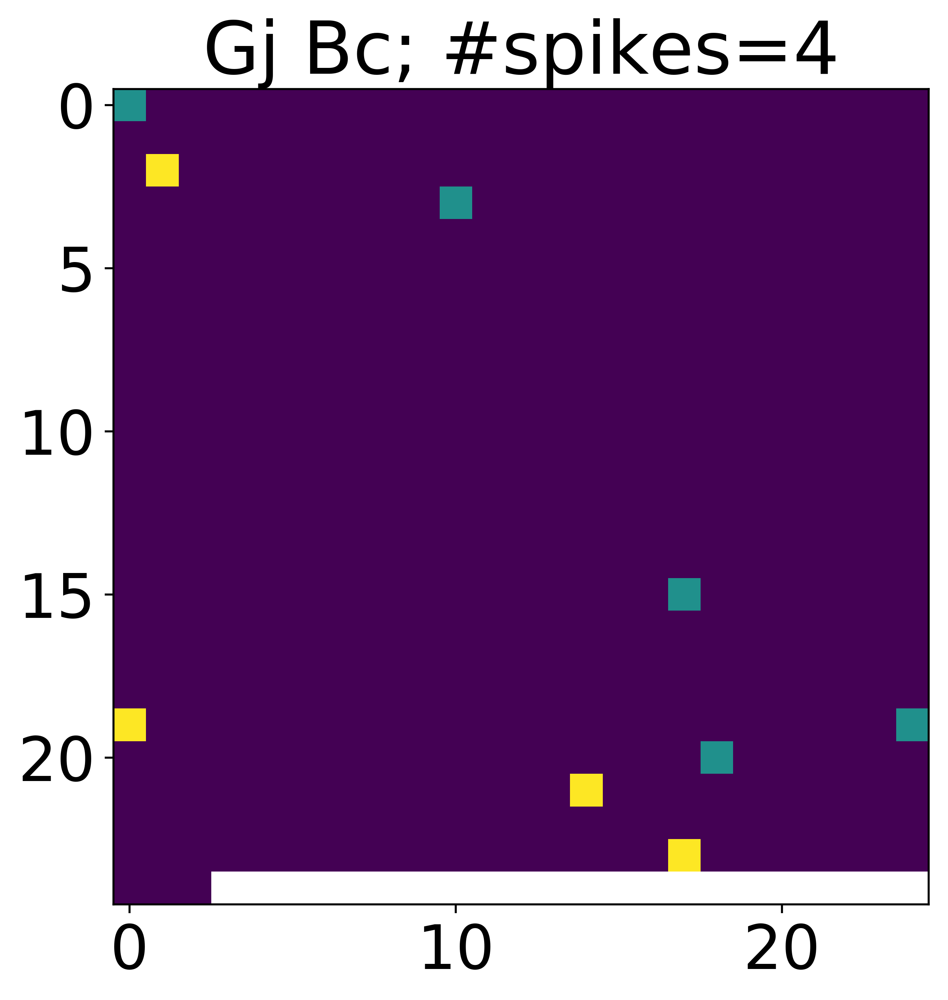

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_184_from_proj_gj_bc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_184_from_proj_gj_bc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_94_from_proj_gj_bc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_94_from_proj_gj_bc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_494_from_proj_gj_bc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_494_from_proj_gj_bc.png
Plotting             

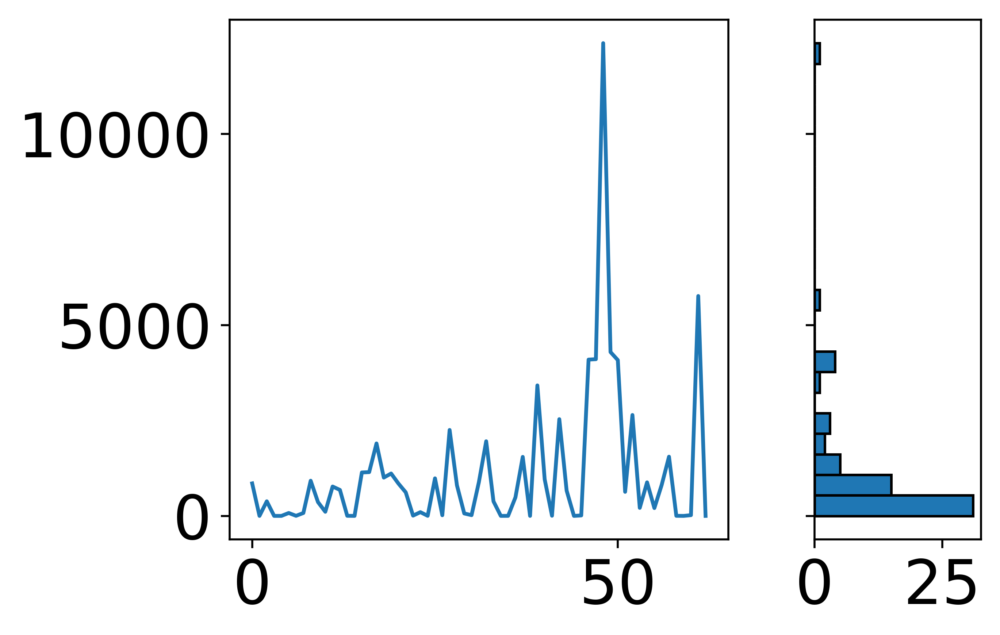

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_581_from_proj_pf_bc.png


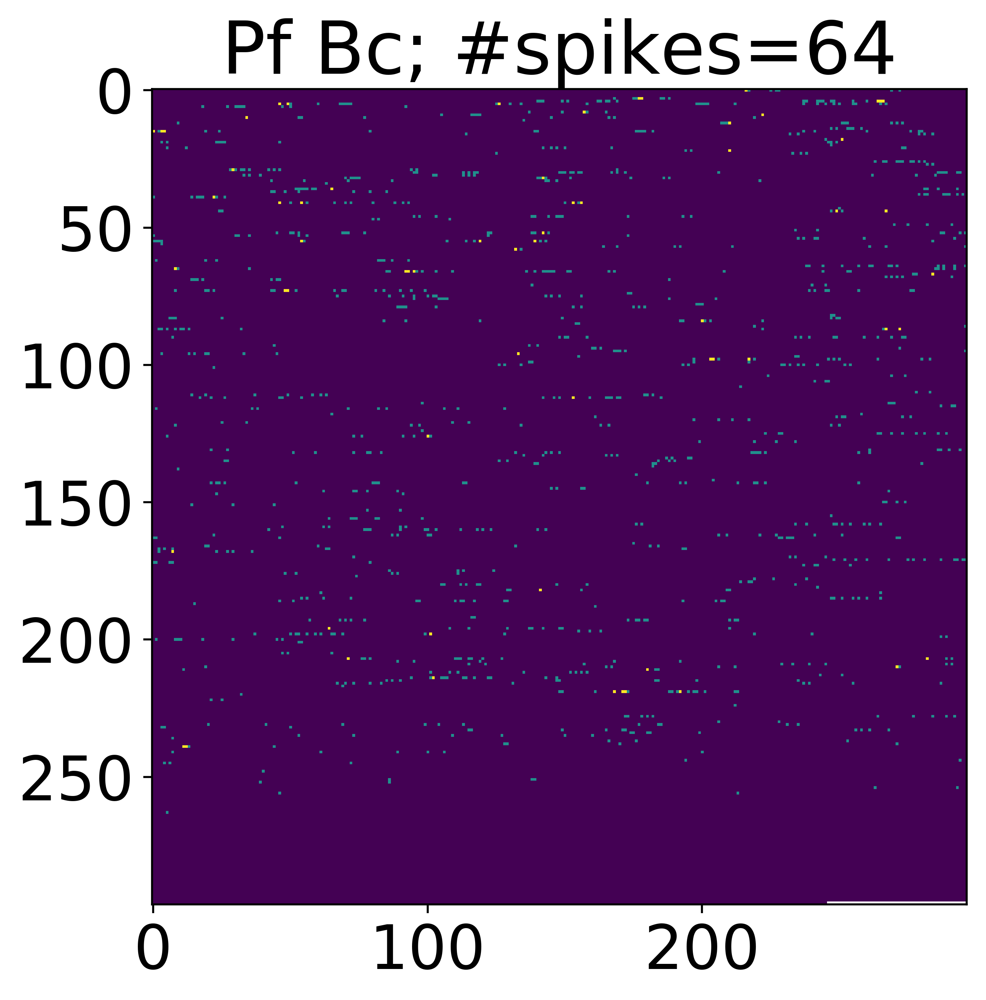

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_420_from_proj_pf_bc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_420_from_proj_pf_bc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_418_from_proj_pf_bc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_418_from_proj_pf_bc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_416_from_proj_pf_bc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_416_from_proj_pf_bc.png
Plotting           

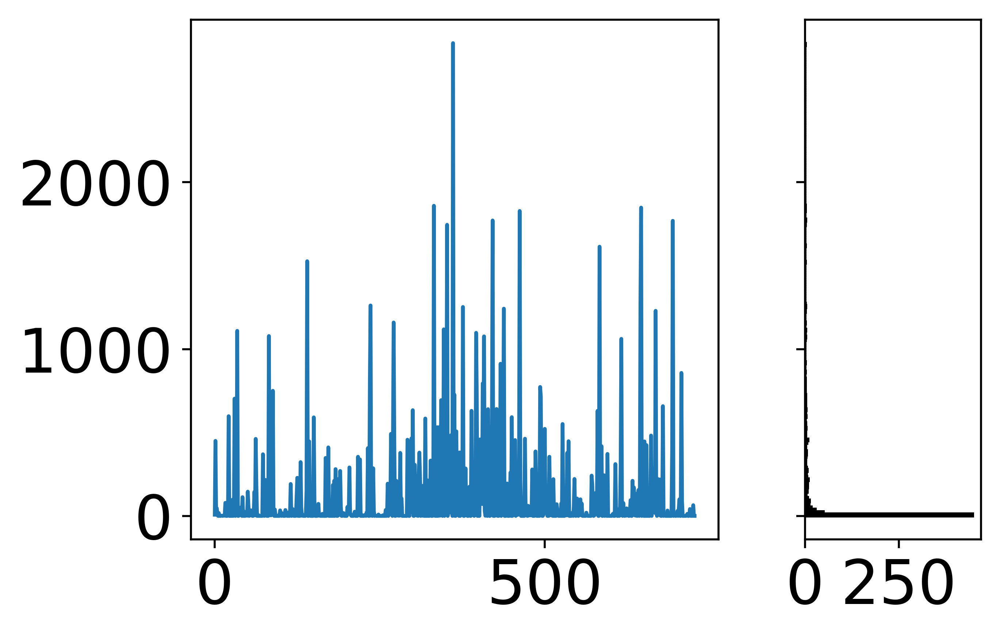

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_40_from_proj_pf_pc.png


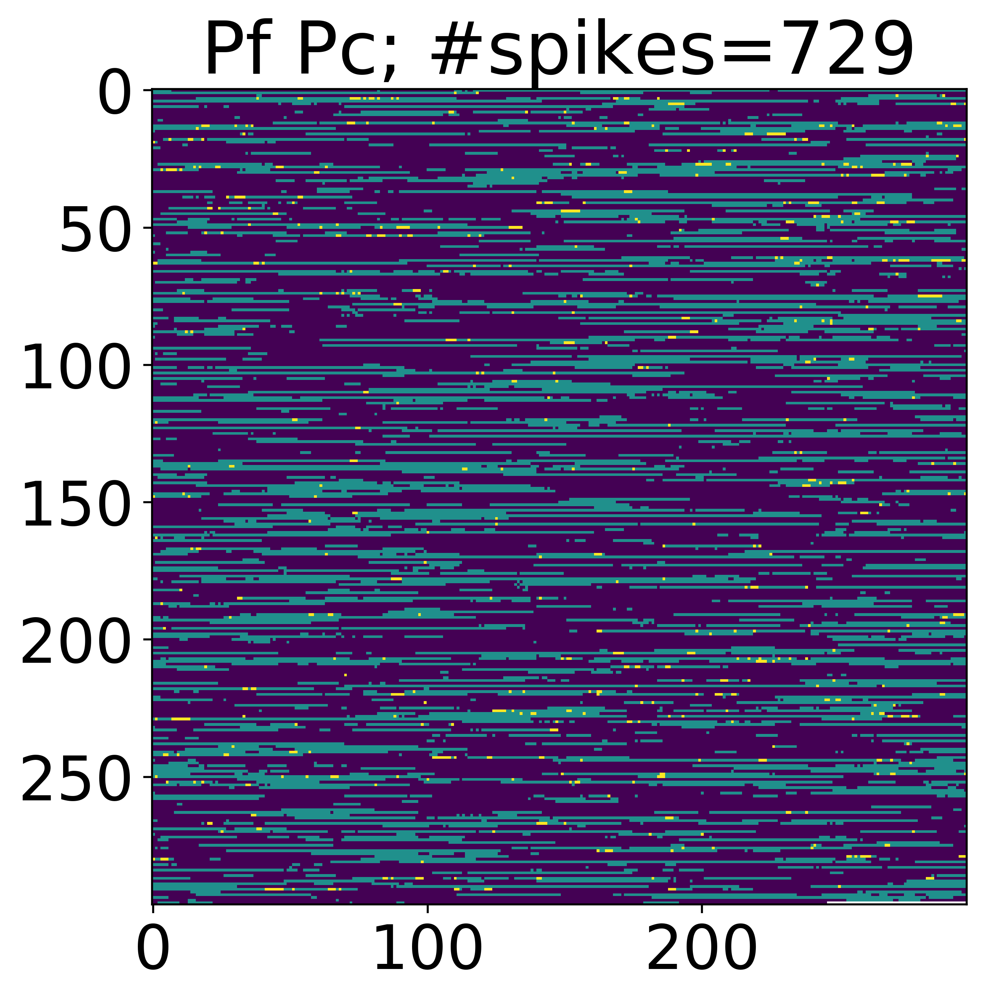

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_43_from_proj_pf_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_43_from_proj_pf_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_37_from_proj_pf_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_37_from_proj_pf_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_52_from_proj_pf_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_52_from_proj_pf_pc.png
Plotting                 

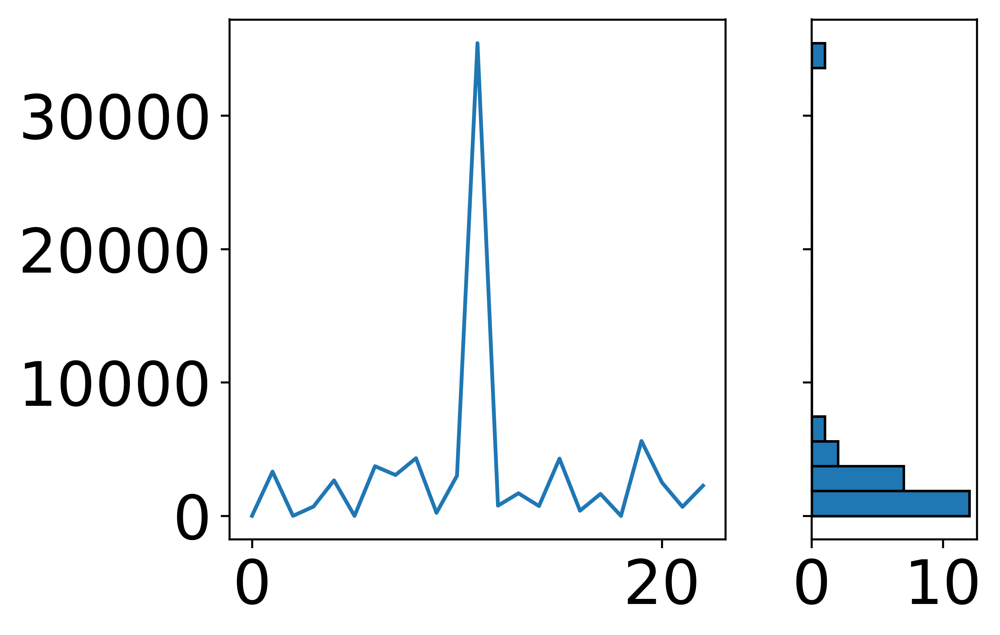

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_37_from_proj_aa_pc.png


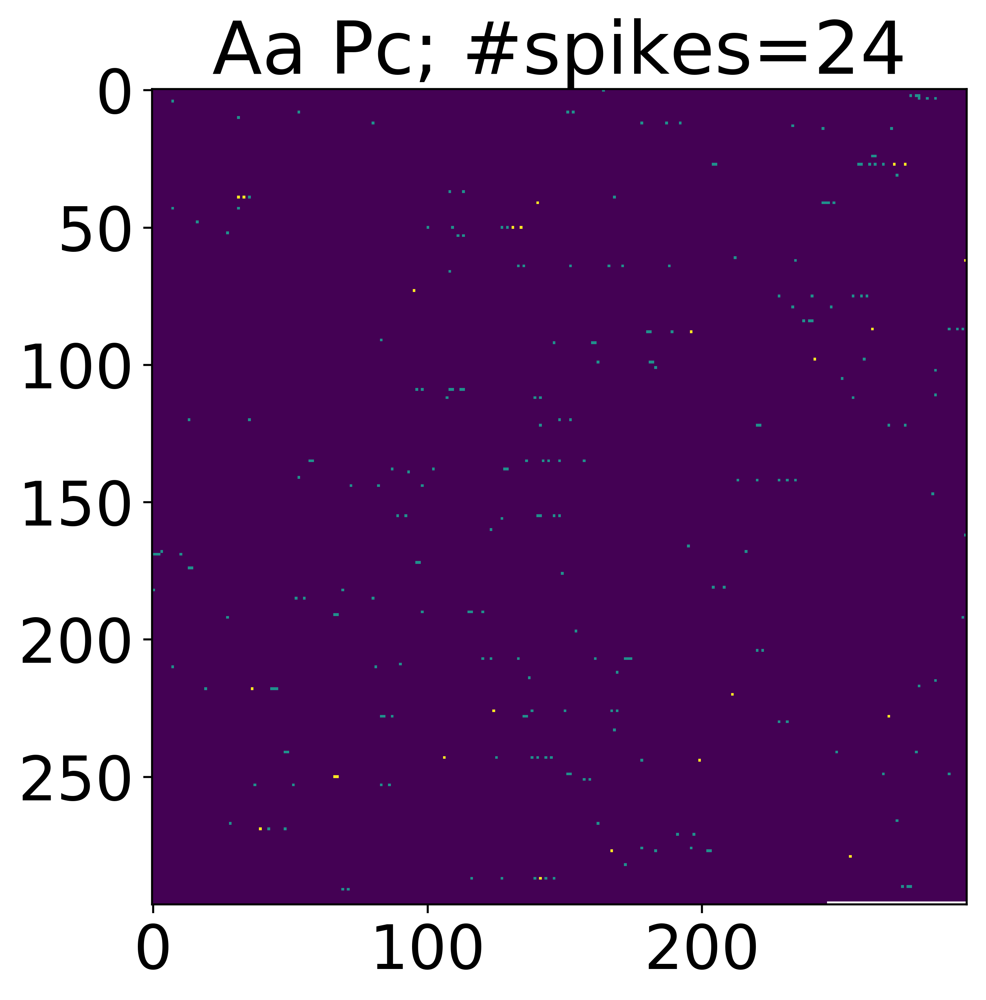

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_34_from_proj_aa_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_34_from_proj_aa_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_5_from_proj_aa_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_5_from_proj_aa_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_31_from_proj_aa_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_31_from_proj_aa_pc.png
Plotting                   

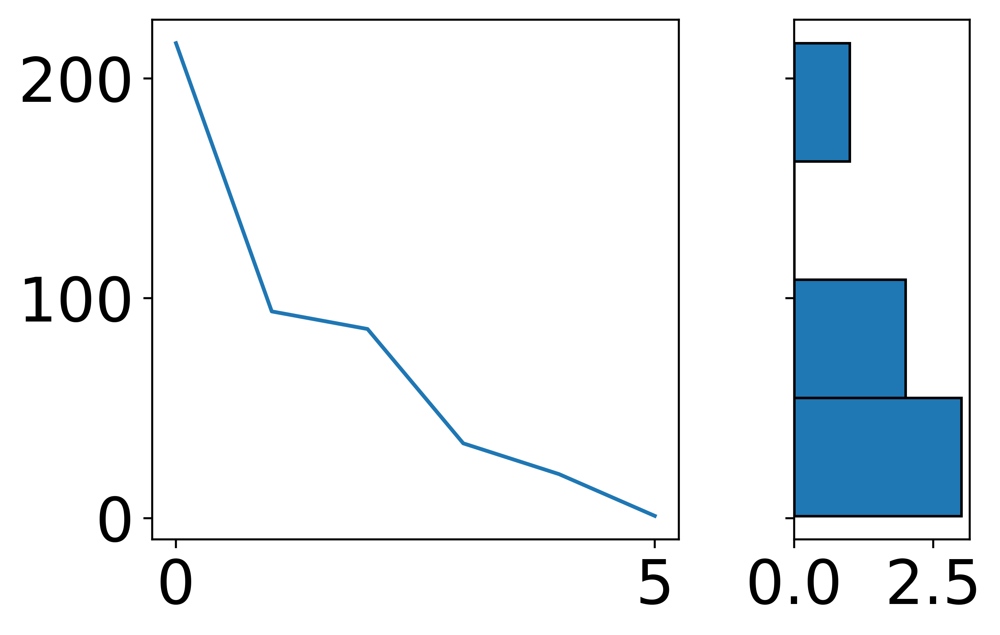

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_22_from_proj_bc_pc.png


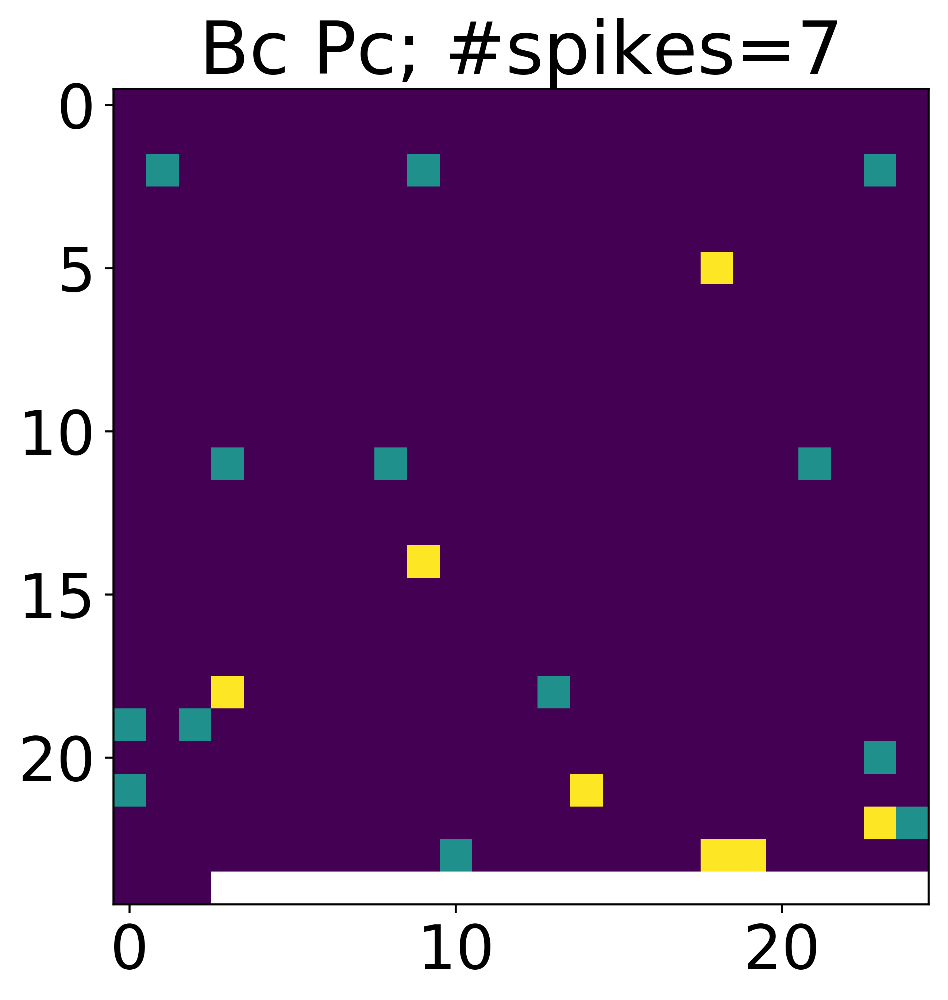

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_35_from_proj_bc_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_35_from_proj_bc_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_1_from_proj_bc_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_1_from_proj_bc_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_4_from_proj_bc_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_4_from_proj_bc_pc.png
Plotting                     

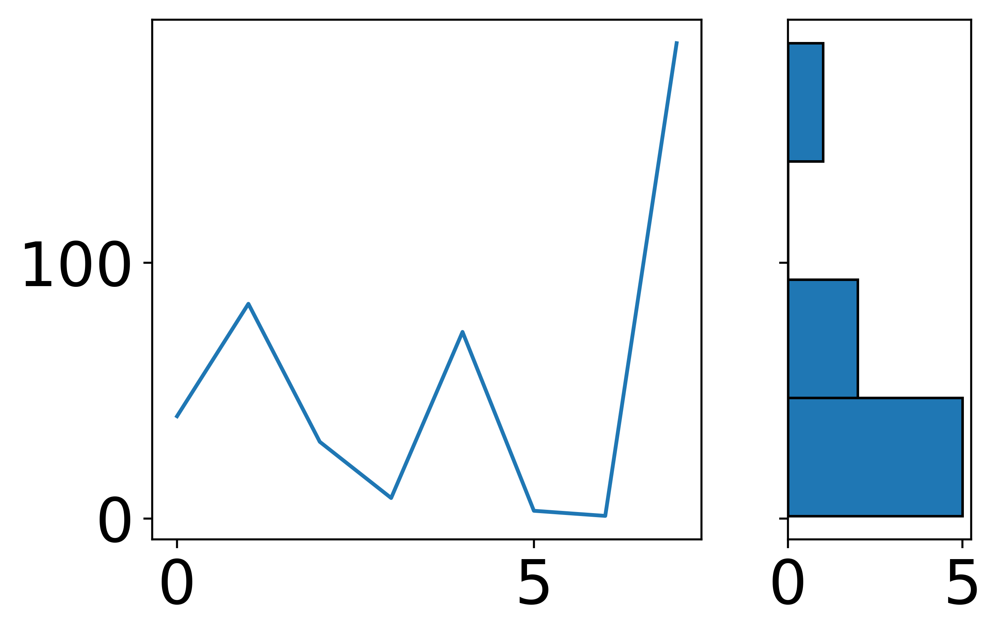

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_17_from_proj_sc_pc.png


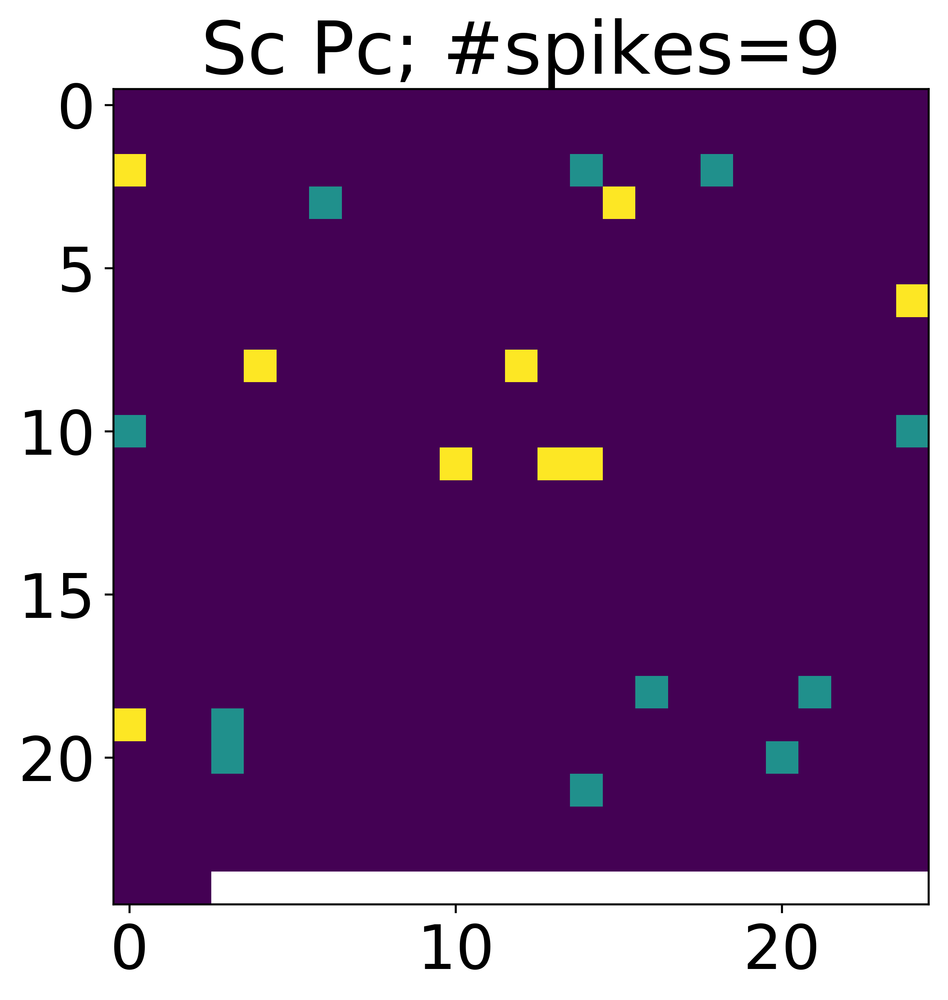

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_59_from_proj_sc_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_59_from_proj_sc_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_14_from_proj_sc_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_14_from_proj_sc_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_15_from_proj_sc_pc.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_15_from_proj_sc_pc.png
Plotting                 

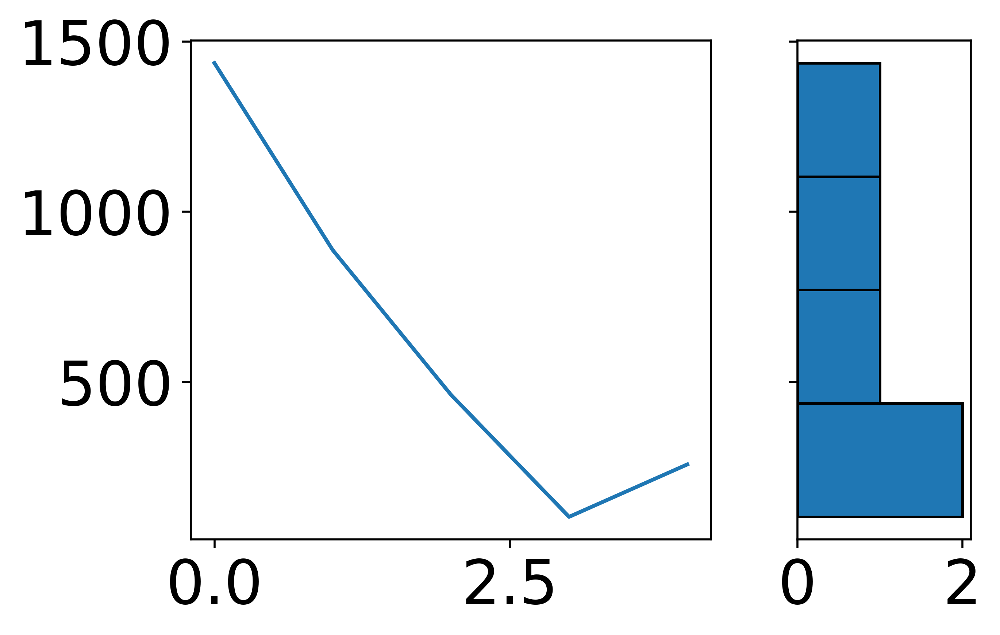

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_10_from_proj_glom_dcn.png


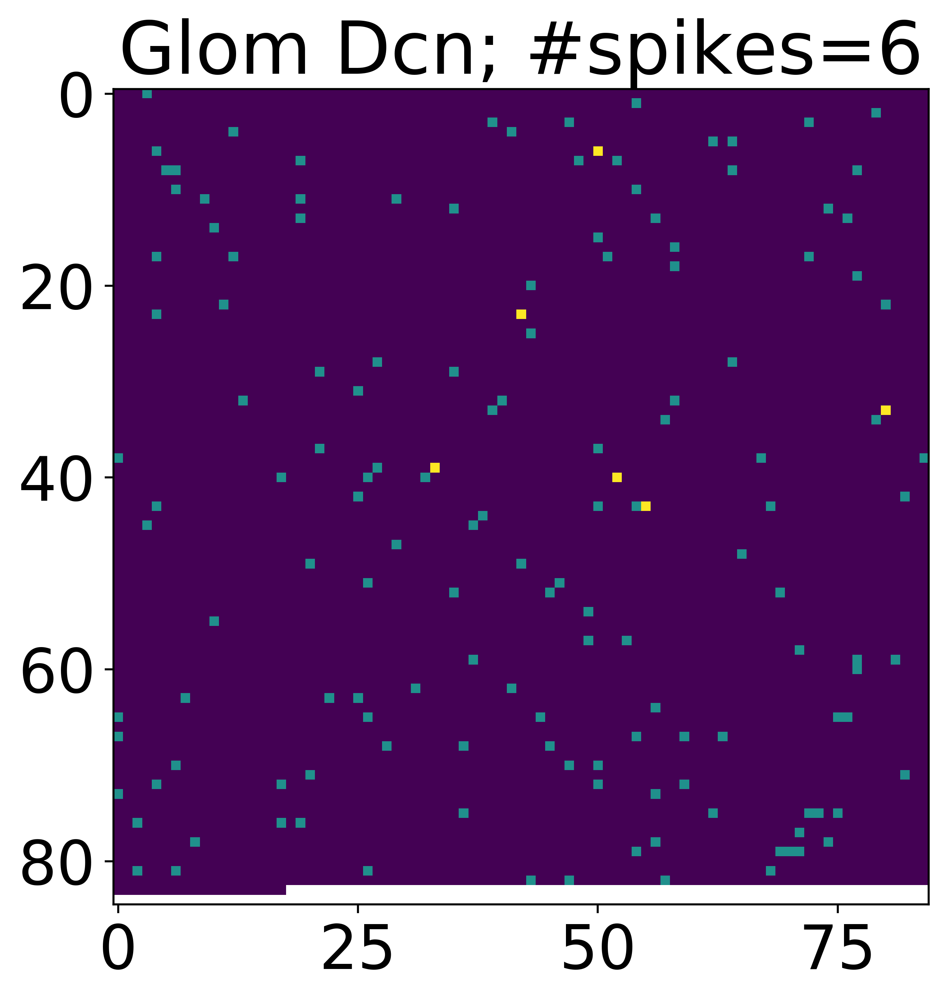

Traceback (most recent call last):
  File "<ipython-input-377-866c6fdf50f5>", line 42, in <module>
    str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
AssertionError: 5vs.6.0


Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_7_from_proj_glom_dcn.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_7_from_proj_glom_dcn.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_4_from_proj_glom_dcn.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_4_from_proj_glom_dcn.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_11_from_proj_glom_dcn.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_11_from_proj_glom_dcn.png
Plotting   

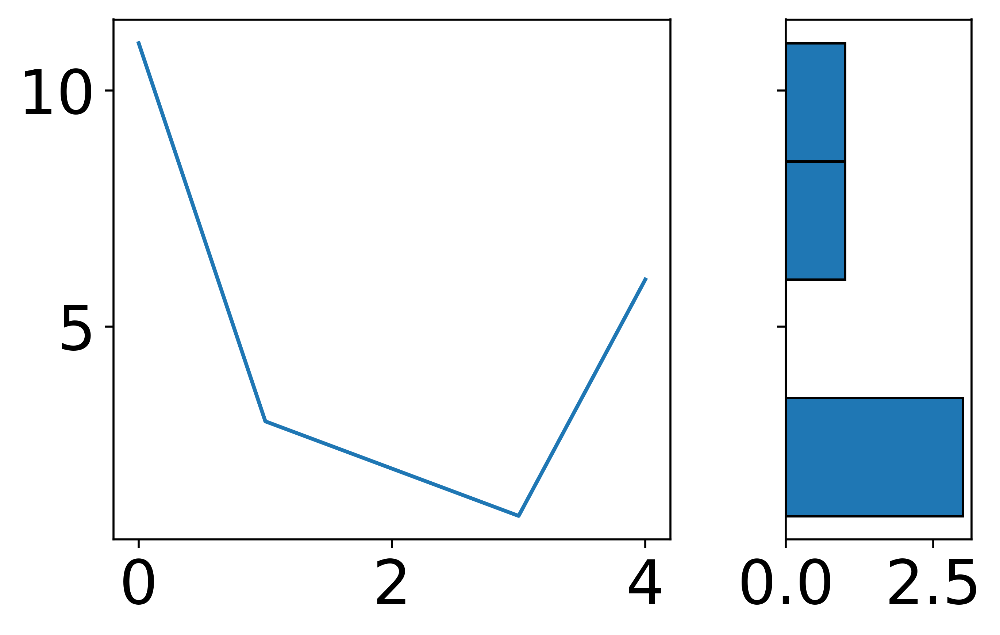

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_10_from_proj_pc_dcn.png


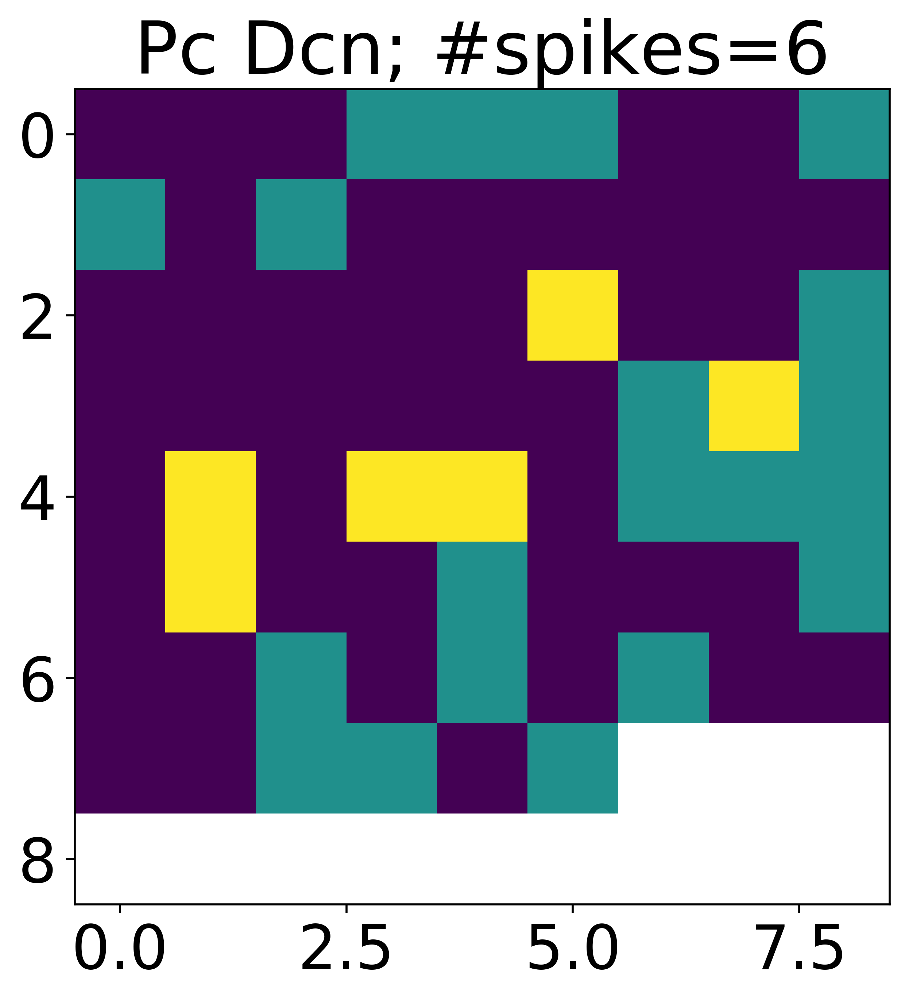

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_9_from_proj_pc_dcn.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_9_from_proj_pc_dcn.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_7_from_proj_pc_dcn.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_7_from_proj_pc_dcn.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/diff_6_from_proj_pc_dcn.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_neuron_6_from_proj_pc_dcn.png
Plotting                 

In [377]:
# Select projection
# proj = "pf_pc"
for pop in plot_order:
    print("POST", pop)
    for proj, worst_spikes in per_conn_worst_spikes[pop].items():
        # Retrieve additional needed info
        # pop = conn_params[proj]['post']
        print("\tPROJ", proj)
        pre = conn_params[proj]['pre']
        print("\tPRE", pre)
        print("-"*80)
        source_spikes = all_spikes[pre]
        curr_conn = final_connectivity[proj]
        spike_count_for_proj = per_conn_worst_spikes[pop][proj]
        no_pre_neurons = all_neurons[pre]
        # Order neurons (rows) in decreasing order of worst activity (see the highest peak)
        worst_per_neuron = np.max(spike_count_for_proj, axis=1)
        ordered_neuron_ids = np.argsort(worst_per_neuron)[::-1]

        for i in range(5):
            # Select a neuron
            selected_neuron = int(ordered_neuron_ids[i])

            # For the selected neuron, order timesteps in decreasing order of spikes received  (in it)
            ordered_timesteps = np.argsort(spike_count_for_proj[selected_neuron])[::-1]

            # Select a timestep
            selected_timestep = ordered_timesteps[0]

            # Transform timestep to time
            selected_time = selected_timestep * timestep

            # Where are those spikes coming from? Replay spikes once again.
            coincident_pre_neuron_ids = source_spikes[np.isclose(source_spikes[:, 1], (selected_time/ms))][:, 0]
            # Intersect coincident_pre_neuron_ids with possible sources for the selected_neuron
            incoming_connections_to_selected_neuron = curr_conn[curr_conn[:, 1].astype(int)==selected_neuron][:, 0].astype(int)
            responsible_pre_neuron_ids = np.intersect1d(coincident_pre_neuron_ids, incoming_connections_to_selected_neuron).astype(int)

            # SANITY CHECK! Are we getting the same number of responsible neurons as originally counted?
            try:
                assert responsible_pre_neuron_ids.size ==  spike_count_for_proj[selected_neuron, selected_timestep], \
                    str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
            except AssertionError as ae:
                traceback.print_exc()
#                 continue

            # Plot diff (distance 1D) between subsequent  neuron ids
            diff_ids = np.diff(responsible_pre_neuron_ids)
            f, (ax0, ax1) = plt.subplots(1, 2, figsize=(6, 4), dpi=500, sharey=True, gridspec_kw={'width_ratios': [3, 1]})
            ax0.plot(diff_ids)
#             ax0.set_xlabel("Neuron ID")
#             ax0.set_ylabel("Difference")
            ax1.hist(diff_ids, bins="auto", orientation="horizontal",edgecolor='black')
            plt.tight_layout()
            save_figure(plt, os.path.join(per_neuron_figs,
                                          "diff_{}_from_proj_{}".format(selected_neuron, proj)),
                        extensions=['.png', ])
            if i==0:
                plt.show()
            plt.close(f)
            # Plot 1D map 
            
            # Plot 2D map
            l = int(np.ceil(np.sqrt(no_pre_neurons)))
            activity_map = np.ones((l,l))*np.nan
            # Plot using 3 colours: 0 = neuron, 0.5 = neuron present in source list, 1.0 = neuron fired this timestep
            for nid in np.arange(no_pre_neurons):
                colour = 0
                if nid in responsible_pre_neuron_ids:
                    colour = 1.0
                elif nid in incoming_connections_to_selected_neuron:
                    colour = 0.5
                activity_map[np.unravel_index(nid, activity_map.shape)] = colour

            f = plt.figure(1, figsize=(6, 6), dpi=500)
            im = plt.imshow(activity_map,
                            interpolation='none', vmin=0, vmax=1
            #                 origin='lower'
                           )
            # ax = plt.gca()
            # ax.set_aspect('auto')
            # divider = make_axes_locatable(ax)
            # cax = divider.append_axes("right", "5%", pad="3%")
            # cbar = plt.colorbar(im, cax=cax)
            # cbar.set_label(ylabel)

            # ax = plt.gca()
            # divider = make_axes_locatable(ax)
            # cax = divider.append_axes("right", "5%", pad="3%")
            # cbar = plt.colorbar(im, cax=cax)
            # cbar.ax.set_yticks([0, 0.5, 1.0])
            # cbar.ax.set_yticklabels(["Neuron in {}".format(use_display_name(pre)), "Neuron in afferent list", "Neuron spiked"])
            plt.title(use_display_name(proj) + "; #spikes=" + str(responsible_pre_neuron_ids.size))
            ax.set_xlabel("Neuron ID")
            ax.set_ylabel("Neuron ID")
            save_figure(plt, os.path.join(per_neuron_figs,
                                          "activity_for_neuron_{}_from_proj_{}".format(selected_neuron, proj)),
                        extensions=['.png', ])
            if i==0:
                plt.show()
            plt.close(f)

            # Plot using actual 3D positions

# Looking at the peak activity of each population when plotted in 2D 

In [379]:

# # Order neurons (rows) in decreasing order of worst activity (see the highest peak)
# ordered_neuron_ids = np.argsort(worst_per_neuron)[::-1]

# for i in range(5):
# # Select a neuron
# selected_neuron = int(ordered_neuron_ids[i])

# # For the selected neuron, order timesteps in decreasing order of spikes received  (in it)
# ordered_timesteps = np.argsort(spike_count_for_proj[selected_neuron])[::-1]

# # Select a timestep
# selected_timestep = ordered_timesteps[0]

# # Transform timestep to time
# selected_time = selected_timestep * timestep

# # Where are those spikes coming from? Replay spikes once again.
# coincident_pre_neuron_ids = source_spikes[np.isclose(source_spikes[:, 1], (selected_time/ms))][:, 0]
# # Intersect coincident_pre_neuron_ids with possible sources for the selected_neuron
# incoming_connections_to_selected_neuron = curr_conn[curr_conn[:, 1].astype(int)==selected_neuron][:, 0].astype(int)
# responsible_pre_neuron_ids = np.intersect1d(coincident_pre_neuron_ids, incoming_connections_to_selected_neuron).astype(int)

# # SANITY CHECK! Are we getting the same number of responsible neurons as originally counted?
# try:
#     assert responsible_pre_neuron_ids.size ==  spike_count_for_proj[selected_neuron, selected_timestep], \
#         str(responsible_pre_neuron_ids.size) + "vs." + str(spike_count_for_proj[selected_neuron, selected_timestep])
# except AssertionError as ae:
#     traceback.print_exc()
# #                 continue

# # Plot diff (distance 1D) between subsequent  neuron ids
# diff_ids = np.diff(responsible_pre_neuron_ids)
# f, (ax0, ax1) = plt.subplots(1, 2, figsize=(6, 4), dpi=500, sharey=True, gridspec_kw={'width_ratios': [3, 1]})
# ax0.plot(diff_ids)
# #             ax0.set_xlabel("Neuron ID")
# #             ax0.set_ylabel("Difference")
# ax1.hist(diff_ids, bins="auto", orientation="horizontal",edgecolor='black')
# plt.tight_layout()
# save_figure(plt, os.path.join(per_neuron_figs,
#                               "diff_{}_from_proj_{}".format(selected_neuron, proj)),
#             extensions=['.png', ])
# if i==0:
#     plt.show()
# plt.close(f)
# # Plot 1D map 

# # Plot 2D map
# l = int(np.ceil(np.sqrt(no_pre_neurons)))
# activity_map = np.ones((l,l))*np.nan
# # Plot using 3 colours: 0 = neuron, 0.5 = neuron present in source list, 1.0 = neuron fired this timestep
# for nid in np.arange(no_pre_neurons):
#     colour = 0
#     if nid in responsible_pre_neuron_ids:
#         colour = 1.0
#     elif nid in incoming_connections_to_selected_neuron:
#         colour = 0.5
#     activity_map[np.unravel_index(nid, activity_map.shape)] = colour

# f = plt.figure(1, figsize=(6, 6), dpi=500)
# im = plt.imshow(activity_map,
#                 interpolation='none', vmin=0, vmax=1
#                )

# plt.title(use_display_name(proj) + "; #spikes=" + str(responsible_pre_neuron_ids.size))
# ax.set_xlabel("Neuron ID")
# ax.set_ylabel("Neuron ID")
# save_figure(plt, os.path.join(per_neuron_figs,
#                               "activity_for_neuron_{}_from_proj_{}".format(selected_neuron, proj)),
#             extensions=['.png', ])
# if i==0:
#     plt.show()
# plt.close(f)

# Plot using actual 3D positions

In [474]:
import matplotlib.gridspec as gridspec

POP glomerulus
--------------------------------------------------------------------------------
# neurons 7073
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/cummulative_activity_for_population_glomerulus.png


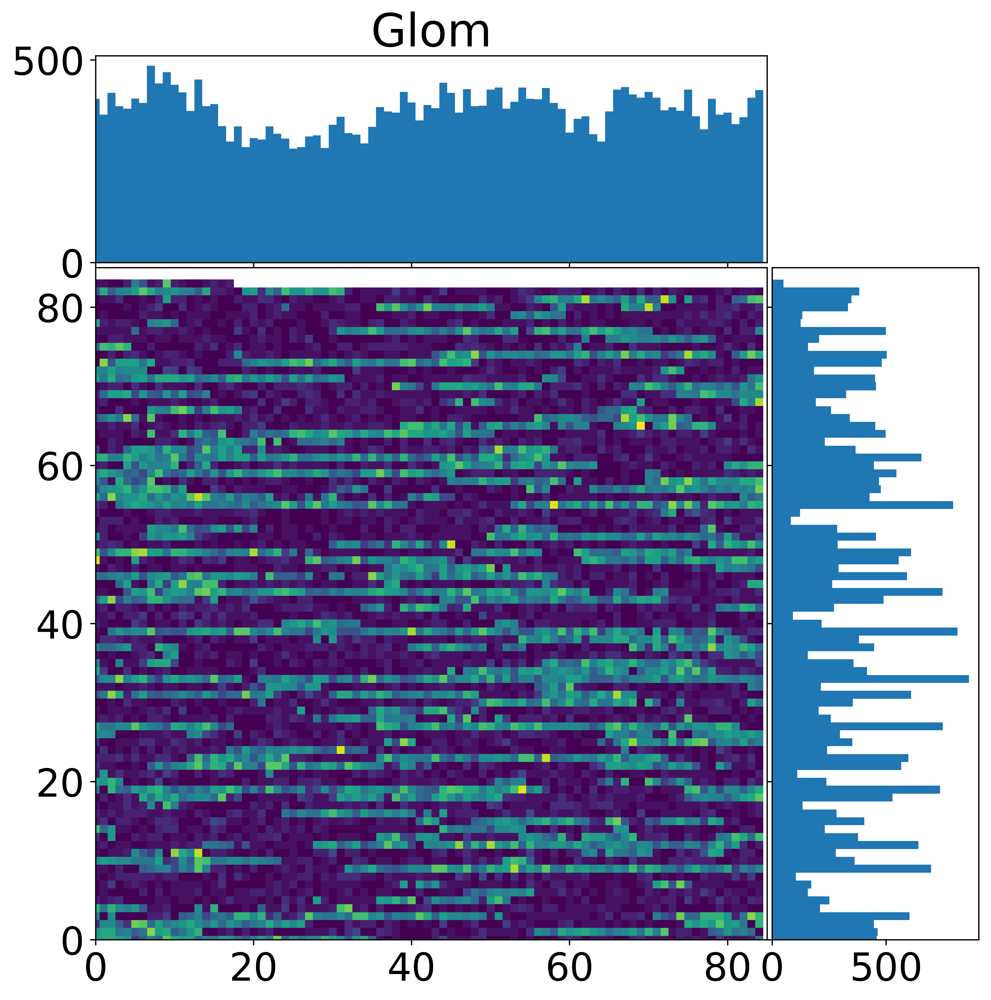

Selected timestep 3414
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_glomerulus_at_timestep_3414.png


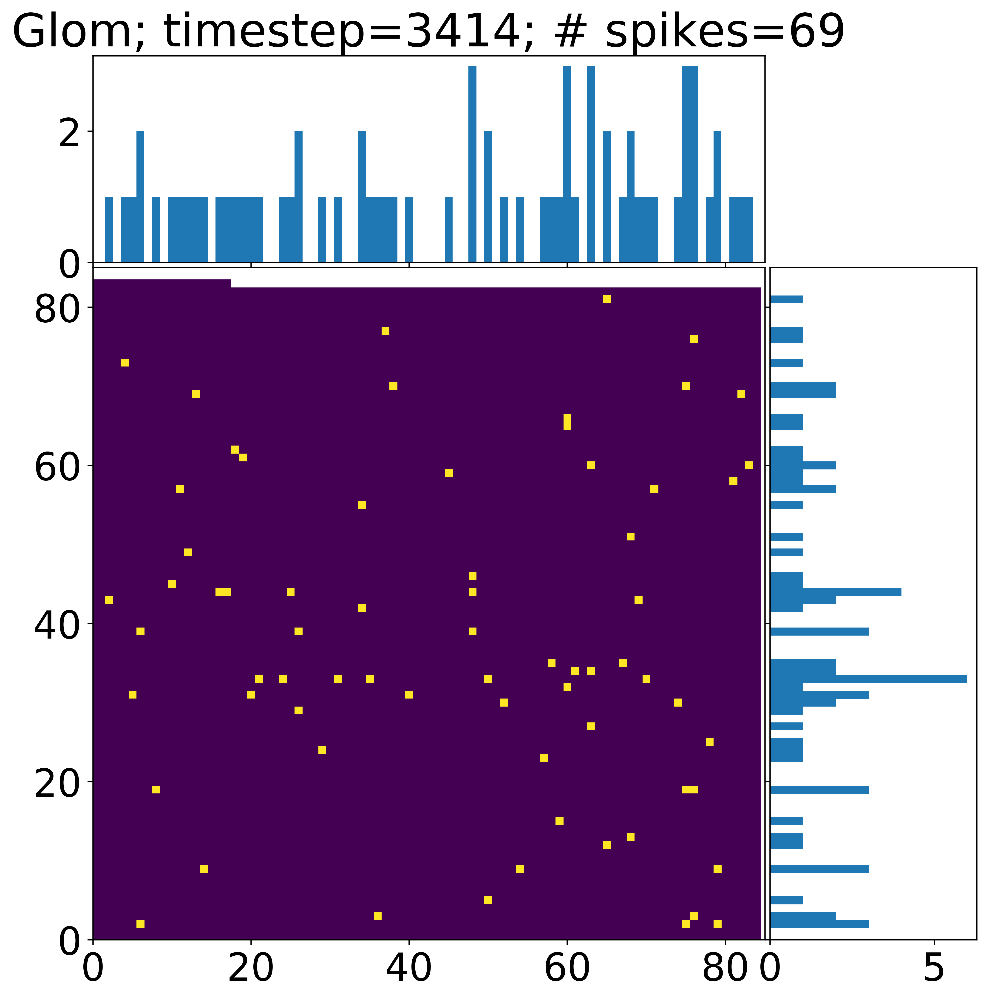

interval start 3000
interval end 3500
--------------------------------------------------------------------------------


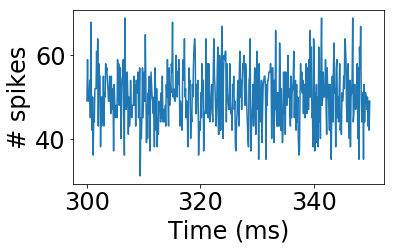

Selected timestep 3469
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_glomerulus_at_timestep_3469.png
interval start 3000
interval end 3500
--------------------------------------------------------------------------------
Selected timestep 3067
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_glomerulus_at_timestep_3067.png
interval start 3000
interval end 3500
--------------------------------------------------------------------------------
Selected timestep 3151
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_glomerulus_at_timestep_3151.png
interval start 3000
interval end 3500
--------------------------------------------------------------------------------
Selected timestep 3007
Pl

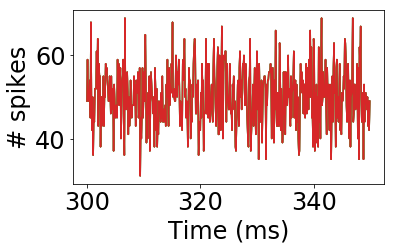

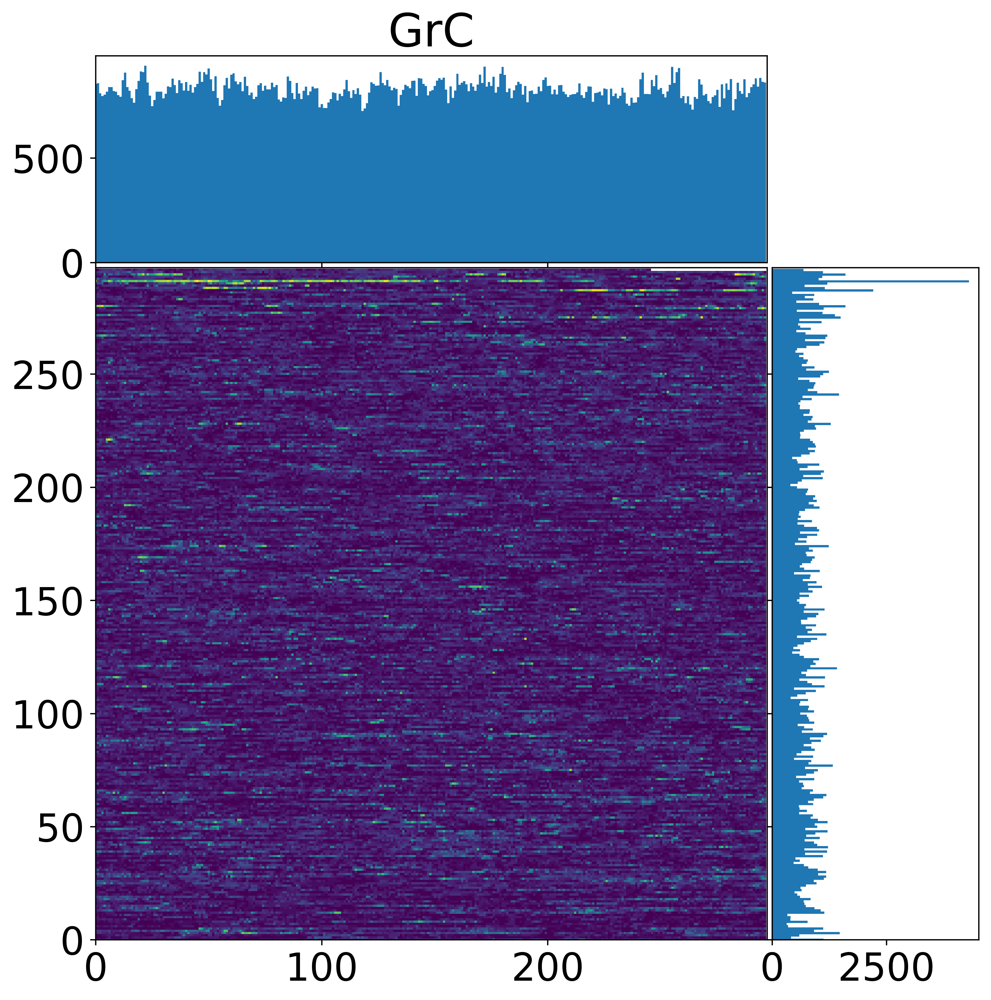

Selected timestep 3046
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_granule_at_timestep_3046.png


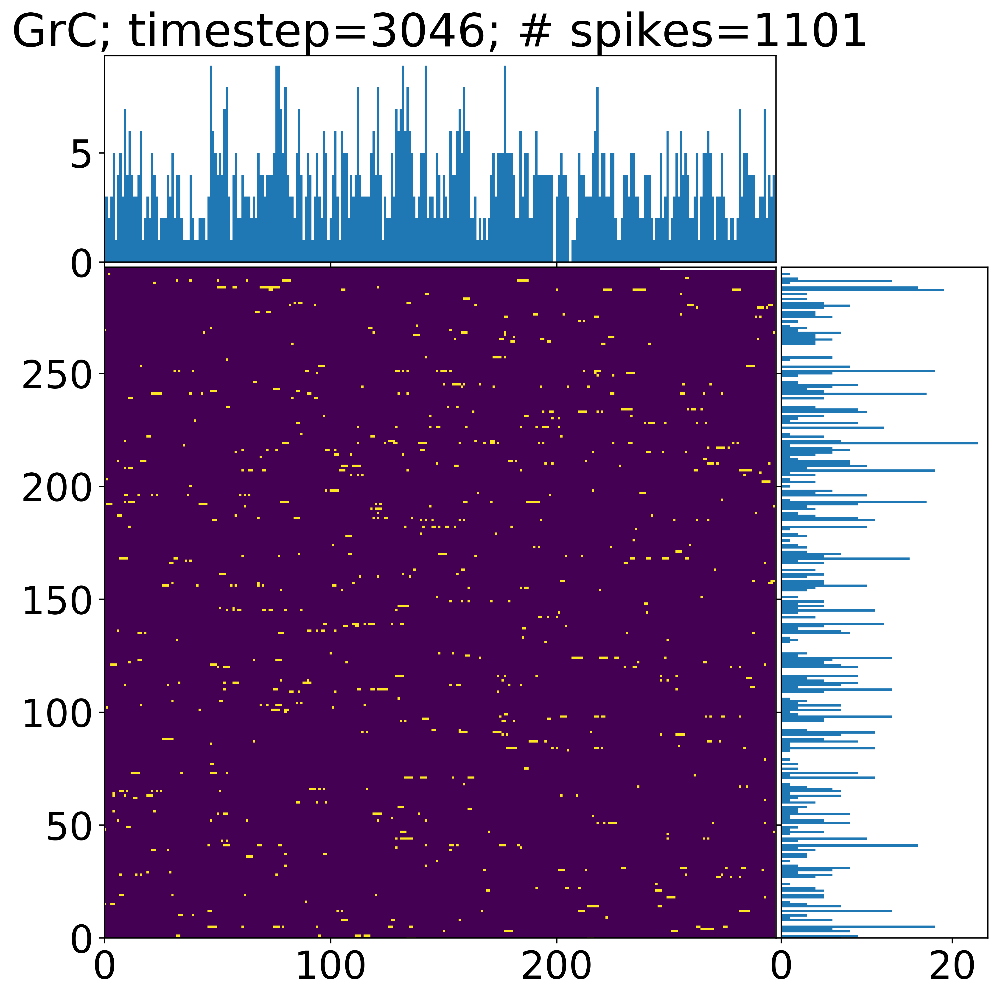

interval start 3040
interval end 3540
--------------------------------------------------------------------------------


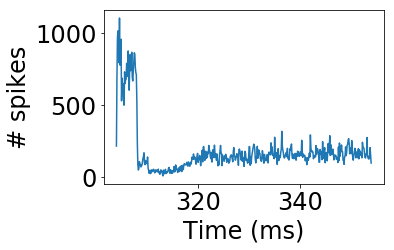

Selected timestep 3043
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_granule_at_timestep_3043.png
interval start 3040
interval end 3540
--------------------------------------------------------------------------------
Selected timestep 3042
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_granule_at_timestep_3042.png
interval start 3040
interval end 3540
--------------------------------------------------------------------------------
Selected timestep 3049
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_granule_at_timestep_3049.png
interval start 3040
interval end 3540
--------------------------------------------------------------------------------
Selected timestep 3044
Plotting   

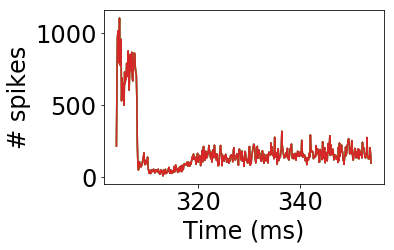

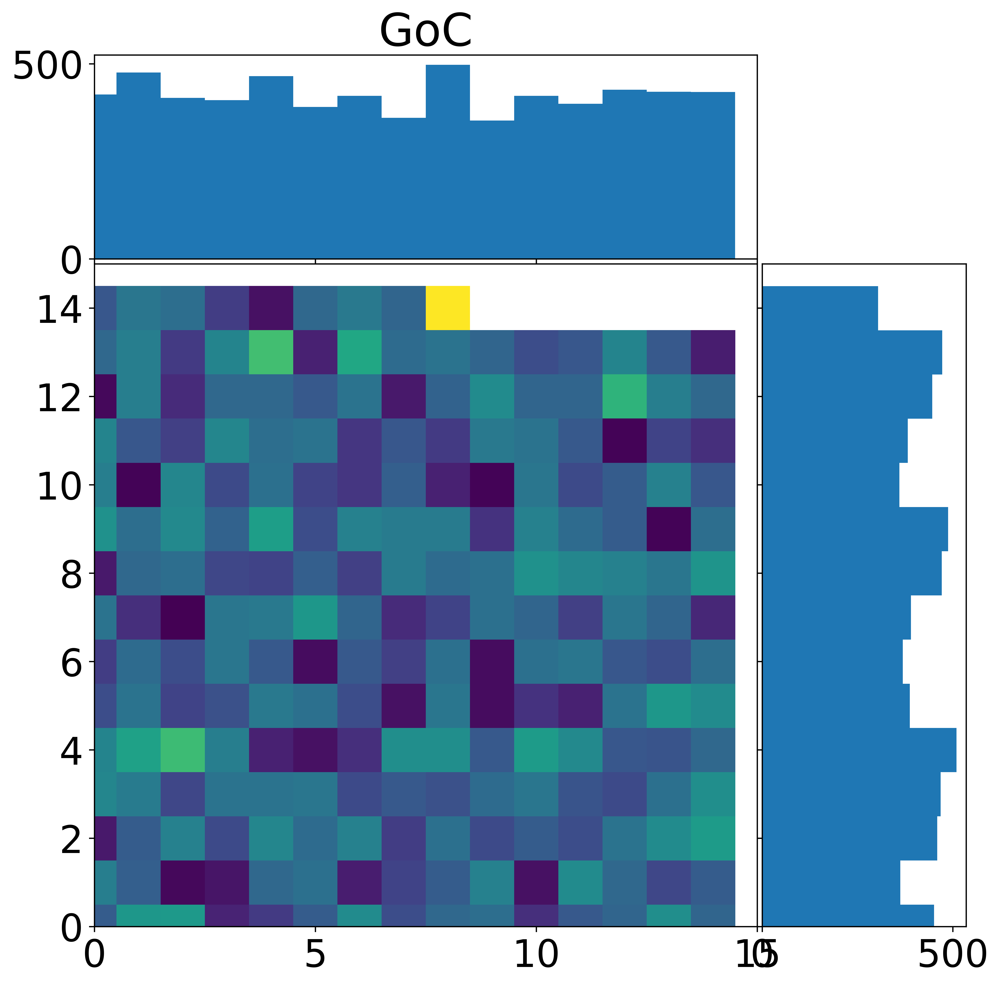

Selected timestep 3061
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_golgi_at_timestep_3061.png


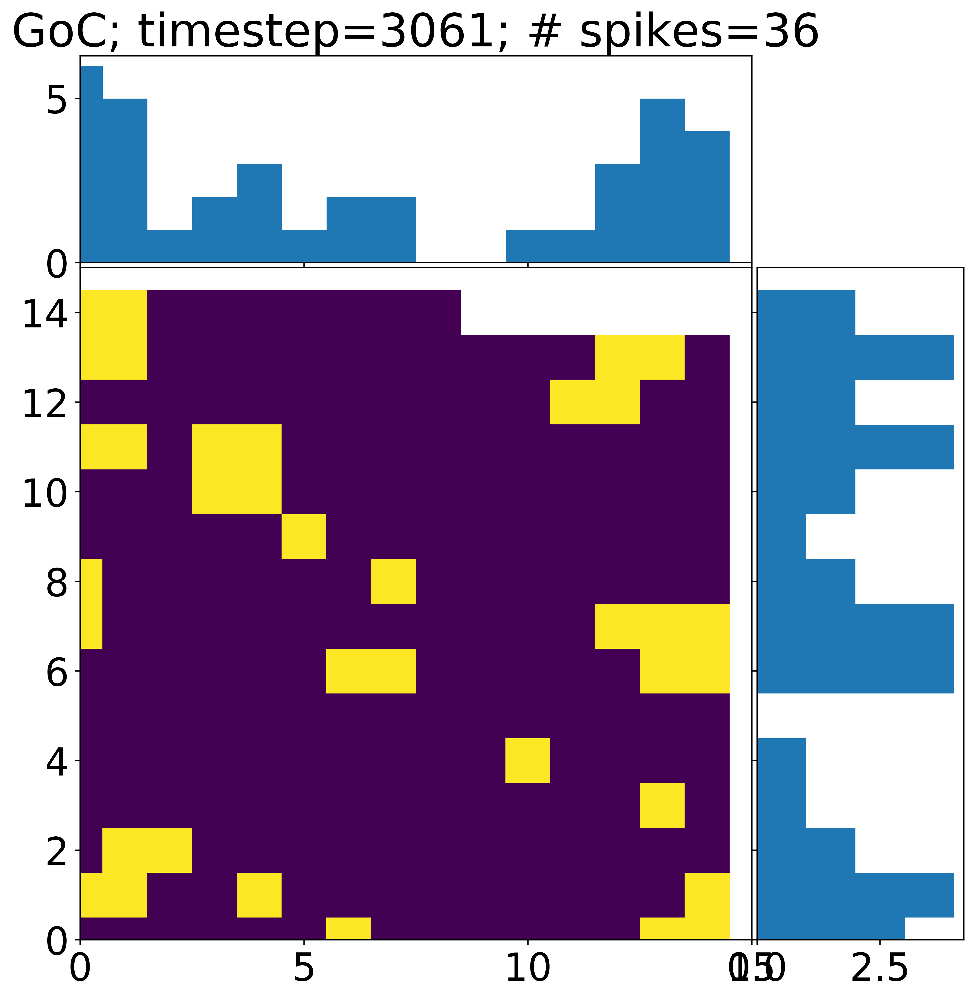

interval start 3040
interval end 3540
--------------------------------------------------------------------------------


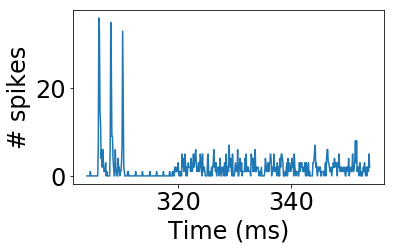

Selected timestep 3082
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_golgi_at_timestep_3082.png
interval start 3040
interval end 3540
--------------------------------------------------------------------------------
Selected timestep 3103
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_golgi_at_timestep_3103.png
interval start 3040
interval end 3540
--------------------------------------------------------------------------------
Selected timestep 3062
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_golgi_at_timestep_3062.png
interval start 3040
interval end 3540
--------------------------------------------------------------------------------
Selected timestep 3083
Plotting         

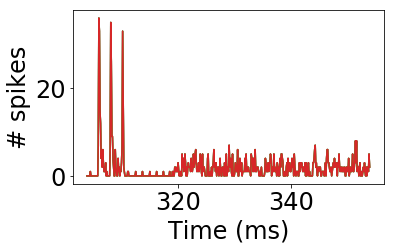

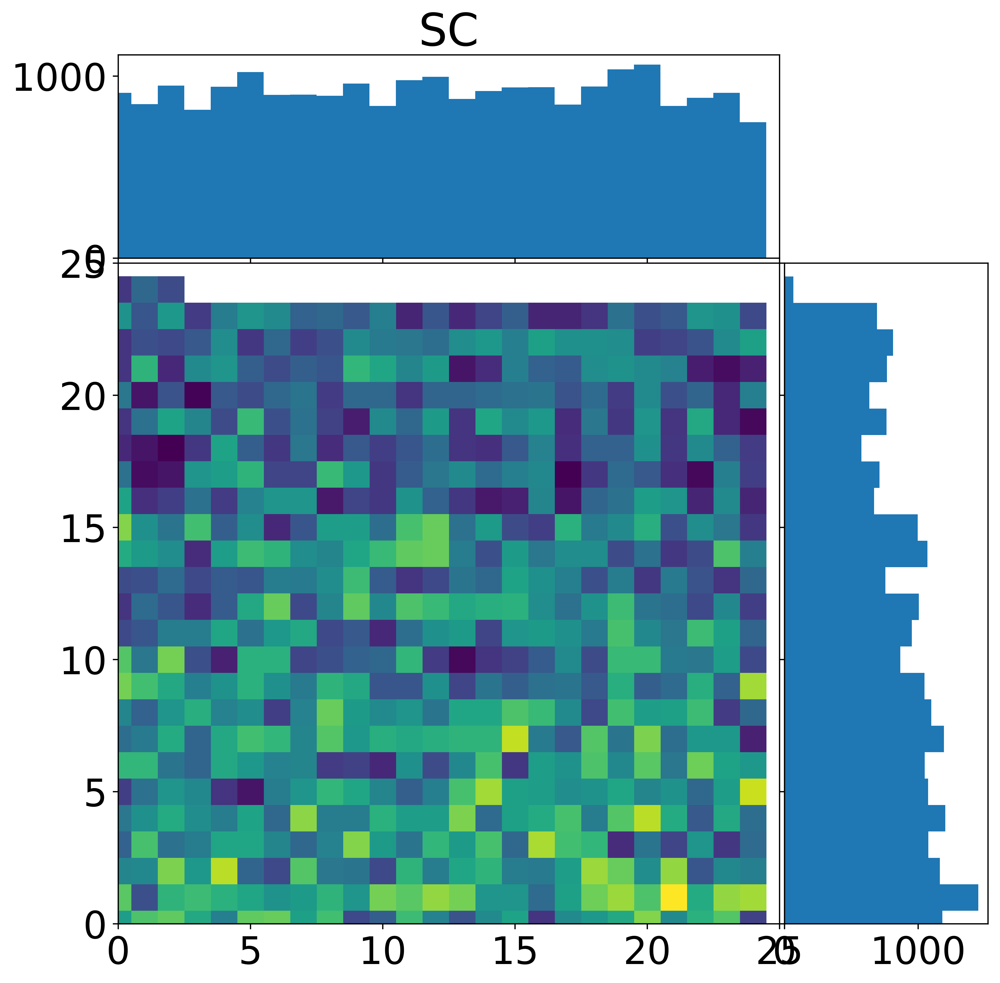

Selected timestep 3094
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_stellate_at_timestep_3094.png


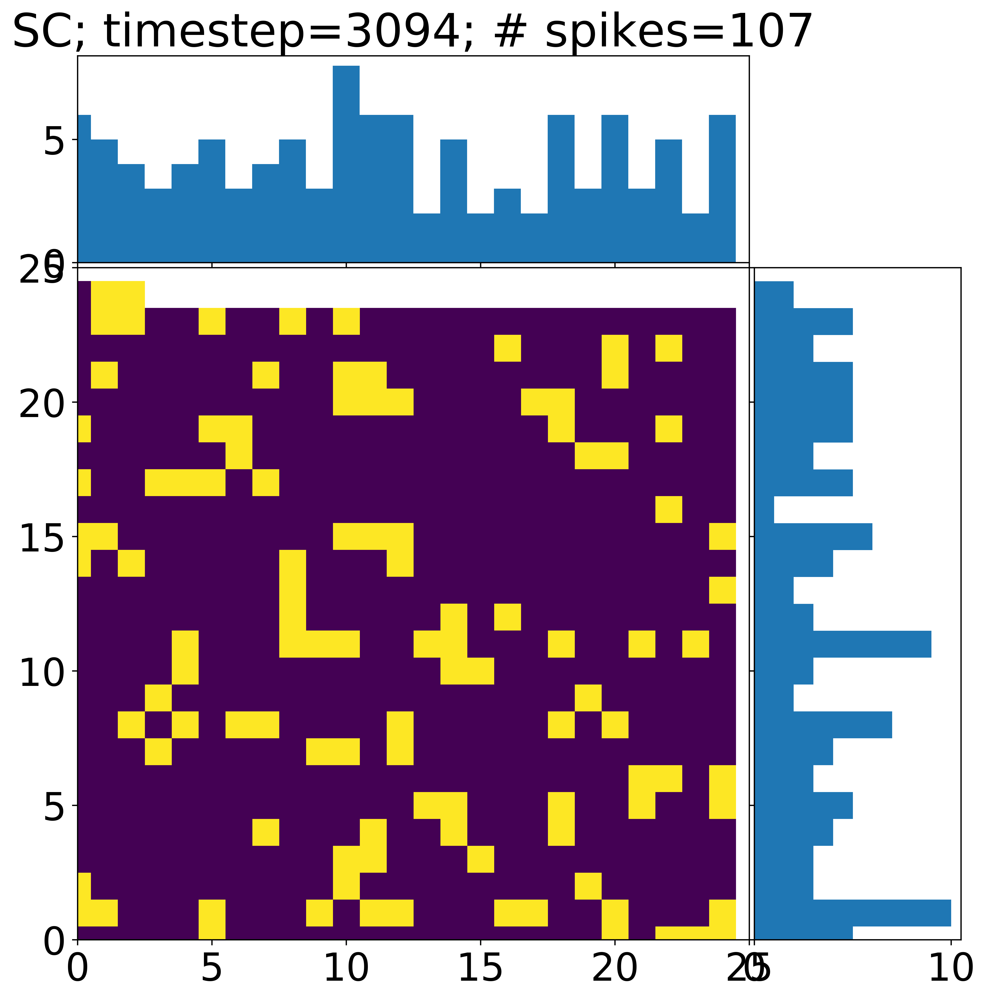

interval start 3090
interval end 3590
--------------------------------------------------------------------------------


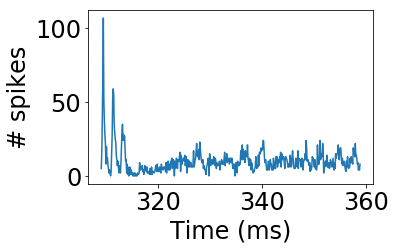

Selected timestep 3093
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_stellate_at_timestep_3093.png
interval start 3090
interval end 3590
--------------------------------------------------------------------------------
Selected timestep 3113
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_stellate_at_timestep_3113.png
interval start 3090
interval end 3590
--------------------------------------------------------------------------------
Selected timestep 3114
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_stellate_at_timestep_3114.png
interval start 3090
interval end 3590
--------------------------------------------------------------------------------
Selected timestep 3112
Plotting

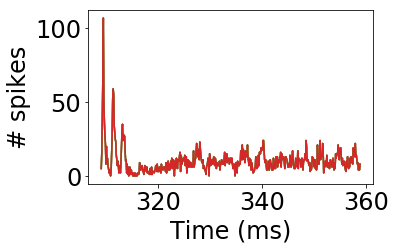

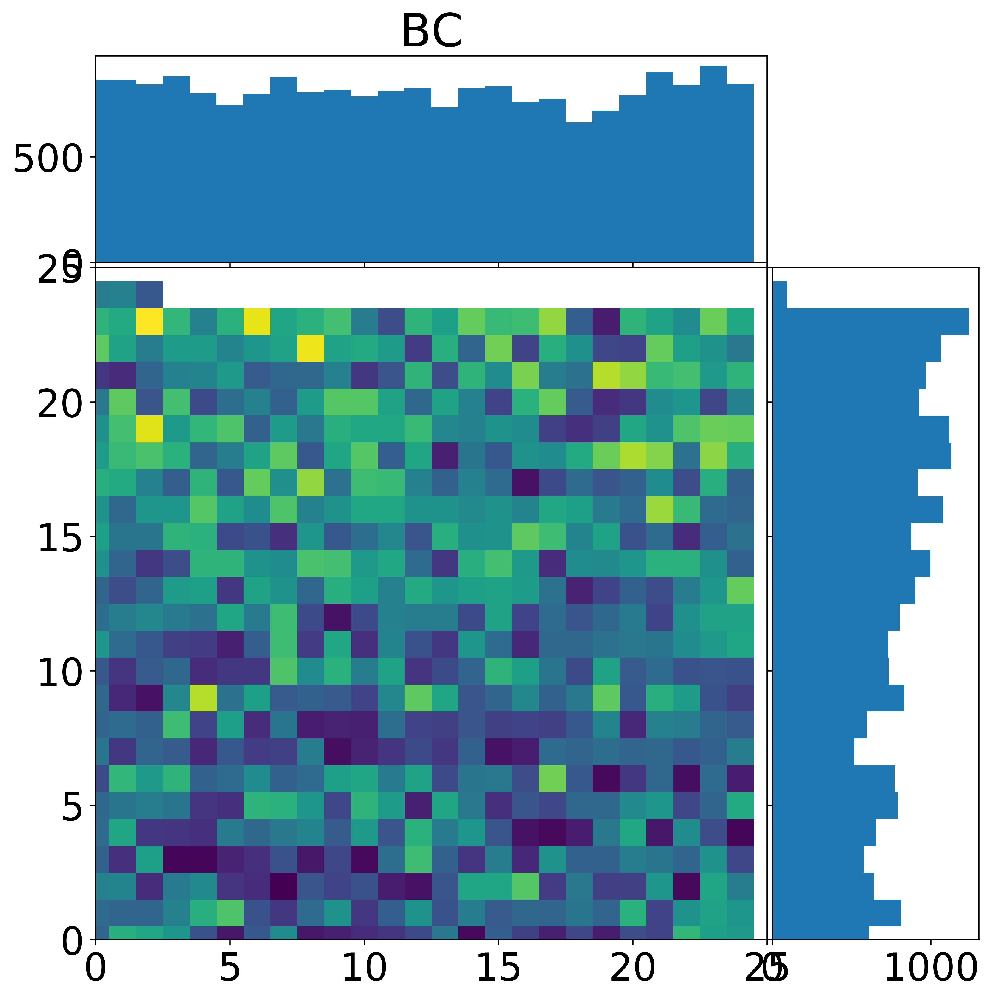

Selected timestep 3094
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_basket_at_timestep_3094.png


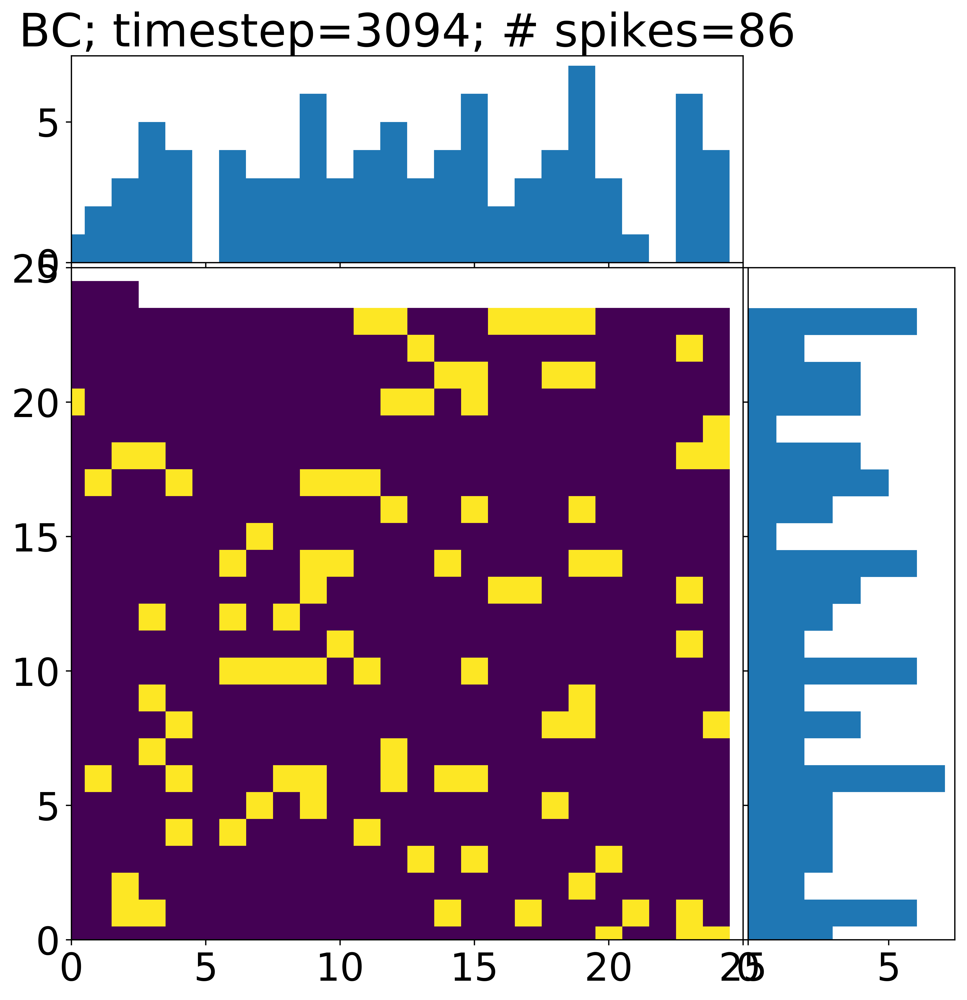

interval start 3090
interval end 3590
--------------------------------------------------------------------------------


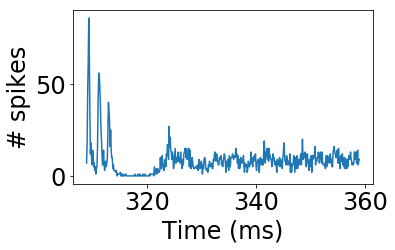

Selected timestep 3095
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_basket_at_timestep_3095.png
interval start 3090
interval end 3590
--------------------------------------------------------------------------------
Selected timestep 3093
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_basket_at_timestep_3093.png
interval start 3090
interval end 3590
--------------------------------------------------------------------------------
Selected timestep 3113
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_basket_at_timestep_3113.png
interval start 3090
interval end 3590
--------------------------------------------------------------------------------
Selected timestep 3112
Plotting      

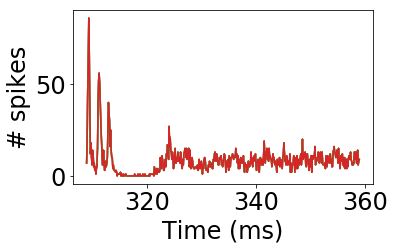

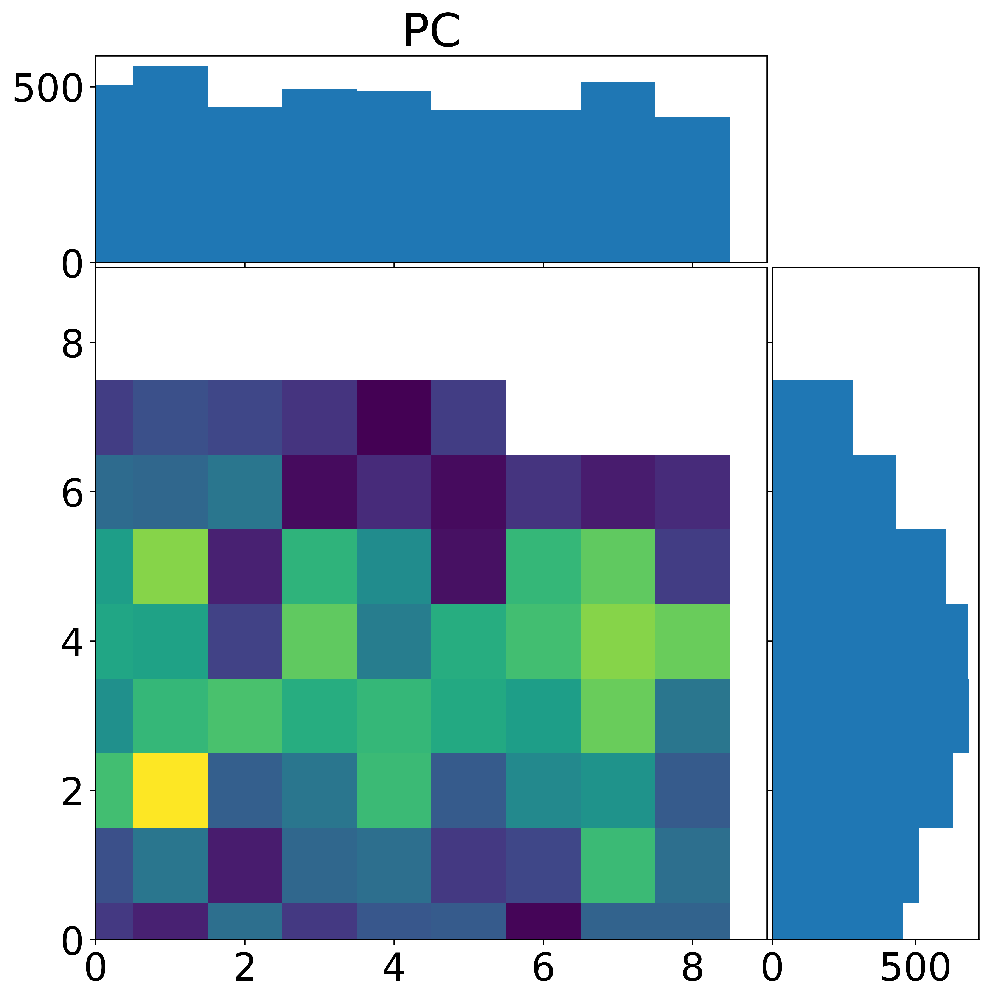

Selected timestep 3098
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_purkinje_at_timestep_3098.png


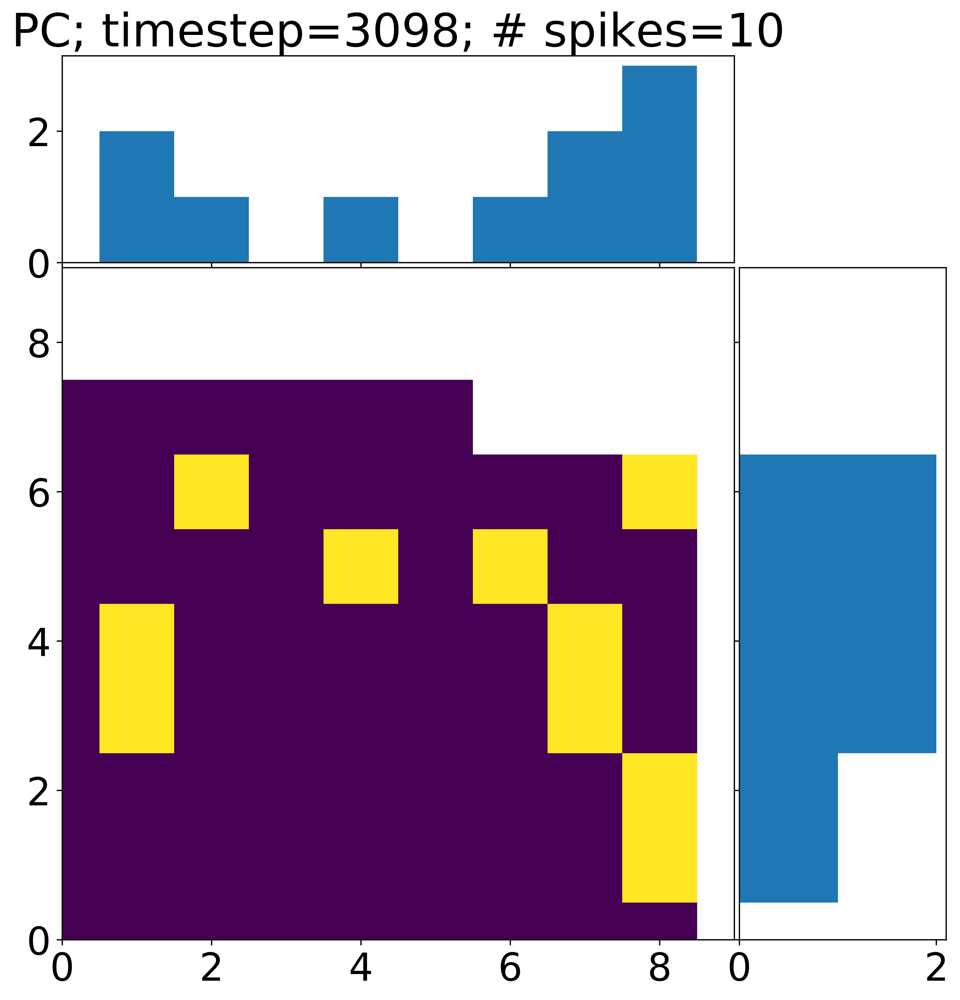

interval start 3060
interval end 3560
--------------------------------------------------------------------------------


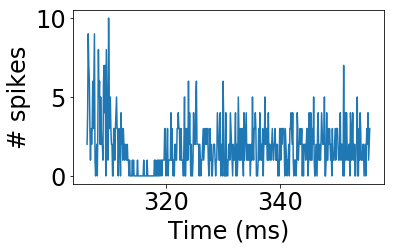

Selected timestep 3073
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_purkinje_at_timestep_3073.png
interval start 3060
interval end 3560
--------------------------------------------------------------------------------
Selected timestep 3062
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_purkinje_at_timestep_3062.png
interval start 3060
interval end 3560
--------------------------------------------------------------------------------
Selected timestep 3080
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_purkinje_at_timestep_3080.png
interval start 3060
interval end 3560
--------------------------------------------------------------------------------
Selected timestep 3094
Plotting

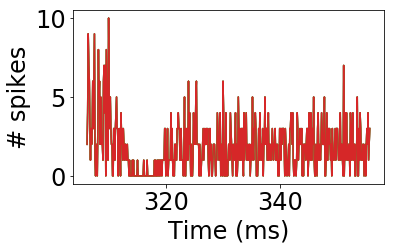

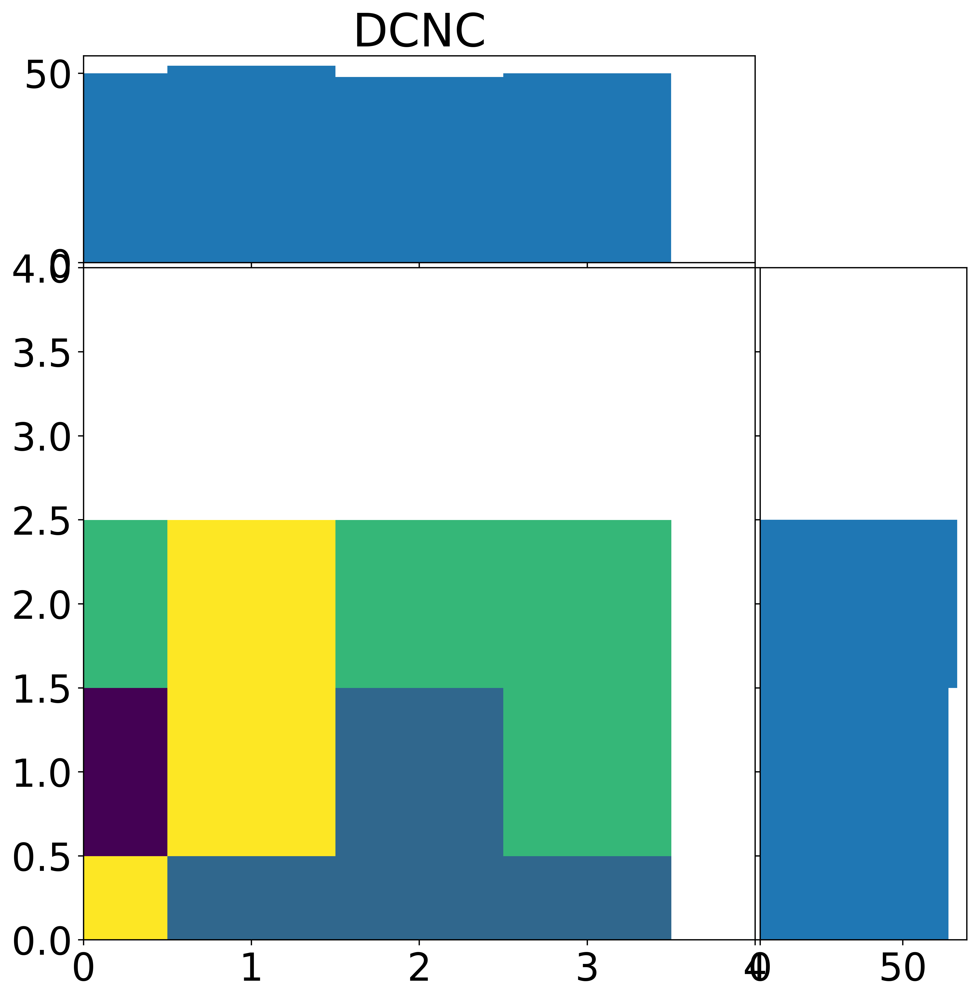

Selected timestep 904
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_dcn_at_timestep_904.png


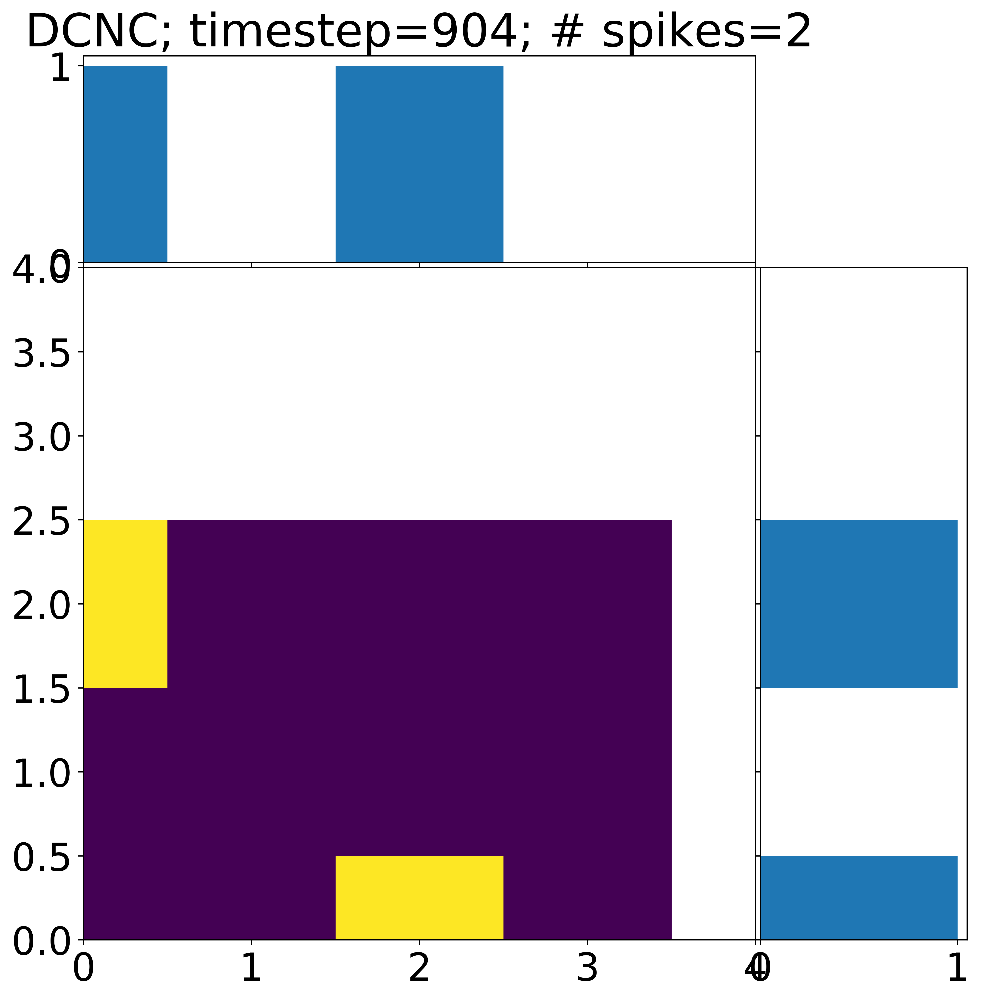

interval start 3100
interval end 3600
--------------------------------------------------------------------------------


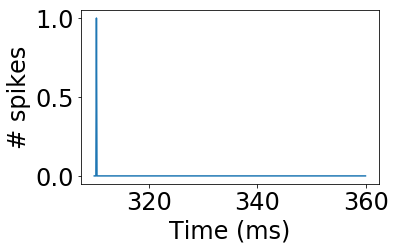

Selected timestep 2463
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_dcn_at_timestep_2463.png
interval start 3100
interval end 3600
--------------------------------------------------------------------------------
Selected timestep 9243
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_dcn_at_timestep_9243.png
interval start 3100
interval end 3600
--------------------------------------------------------------------------------
Selected timestep 6895
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_neuron_figs/activity_for_population_dcn_at_timestep_6895.png
interval start 3100
interval end 3600
--------------------------------------------------------------------------------
Selected timestep 6890
Plotting               

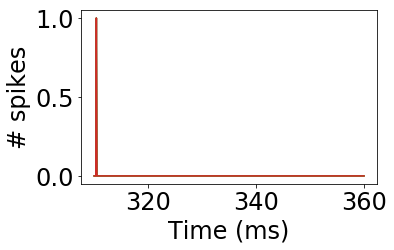

In [620]:
# Select projection
# proj = "pf_pc"
# pop="glomerulus"


left, width = 0.1, 0.65
bottom, height = 0.1, 0.65
spacing = 0.005

rect_scatter = [left, bottom, width, height]
rect_histx = [left, bottom + height + spacing, width, 0.2]
rect_histy = [left + width + spacing, bottom, 0.2, height]

for pop in plot_order:
    print("POP", pop)
    print("-"*80)
    source_spikes = copy.deepcopy(np.array(all_spikes[pop]))
    no_pre_neurons = all_neurons[pop]
    print("# neurons", all_neurons[pop])

    # Count number of spikes generated in each timestep
    ## Transform spike time into timestep (multiply by time_to_bin_conversion)
    source_spikes[:, 1] *= time_to_bin_conversion
    source_spikes = source_spikes.astype(int)

    ## Create (no neurons, timesteps) matrix and record spikes generated at each timestep
    spike_matrix = np.zeros((no_pre_neurons, int(simtime/timestep))).astype(int)
    spike_matrix[source_spikes[:, 0], source_spikes[:, 1]] = 1
    spike_matrix = spike_matrix
    
    ##### Plot the total matrix 
    cummulative_total_matrix = np.sum(spike_matrix, axis=1)
    l = int(np.ceil(np.sqrt(no_pre_neurons)))
    padded_slice = np.concatenate((cummulative_total_matrix, [np.nan] * (l**2-cummulative_total_matrix.size)))
    activity_map = padded_slice.reshape((l,l))

    ###### PLOTTING STUFF
    # start with a square Figure
    fig = plt.figure(figsize=(9, 9), dpi=500)

    ax = fig.add_axes(rect_scatter)
    ax_histx = fig.add_axes(rect_histx, sharex=ax)
    ax_histy = fig.add_axes(rect_histy, sharey=ax)
    ax_histx.set_title(use_display_name(pop))
    # use the previously defined function
    # scatter_hist(x, y, ax, ax_histx, ax_histy)
    imshow_hist(activity_map, ax, ax_histx, ax_histy)
    save_figure(plt, os.path.join(per_neuron_figs,
                                  "cummulative_activity_for_population_{}".format(pop)),
                extensions=['.png', ])

    plt.show()    
    plt.close(fig)
    
    ## Sum over the second dimension to get number of spikes per timestep
    spike_sum = np.sum(spike_matrix, axis=0)

    # Order timesteps in decreasing order of number of spikes
    ordered_timesteps = np.argsort(spike_sum)[::-1]
    for i in range(5):
        # Plot the activity of the worst timesteps
        selected_timestep = ordered_timesteps[i]
        selected_slice = copy.deepcopy(spike_matrix[:,selected_timestep])
        print("Selected timestep", selected_timestep)
        # Plot 2D map
        l = int(np.ceil(np.sqrt(no_pre_neurons)))
        padded_slice = np.concatenate((selected_slice, [np.nan] * (l**2-selected_slice.size)))
        activity_map = padded_slice.reshape((l,l))

        ###### PLOTTING STUFF
        # start with a square Figure
        fig = plt.figure(figsize=(9, 9), dpi=500)

        ax = fig.add_axes(rect_scatter)
        ax_histx = fig.add_axes(rect_histx, sharex=ax)
        ax_histy = fig.add_axes(rect_histy, sharey=ax)
        ax_histx.set_title(use_display_name(pop) + "; timestep=" + str(selected_timestep) + "; # spikes=" + str(spike_sum[selected_timestep]))
        # use the previously defined function
        # scatter_hist(x, y, ax, ax_histx, ax_histy)
        imshow_hist(activity_map, ax, ax_histx, ax_histy)
        save_figure(plt, os.path.join(per_neuron_figs,
                                      "activity_for_population_{}_at_timestep_{}".format(pop, selected_timestep)),
                    extensions=['.png', ])

        if i == 0:
            plt.show()    
        plt.close(fig)

        # Plot activity per timestep for the population
        interval_start = int(stim_period_start[pop]*time_to_bin_conversion)
        interval_end = int(stim_period_end[pop]*time_to_bin_conversion)
        print("interval start", interval_start)
        print("interval end", interval_end)
        interval_of_interest = np.array(spike_sum[interval_start:interval_end])
        print("-"*80)
        plt.plot(np.arange(interval_start, interval_end) * (timestep/ms), interval_of_interest)
        plt.xlabel("Time (ms)")
        plt.ylabel("# spikes")
        if i == 0:
            plt.show()  


In [612]:
activity_map.shape

(85, 85)

In [585]:
np.arange(10).reshape(2, 5).sum(axis=0)

array([ 5,  7,  9, 11, 13])

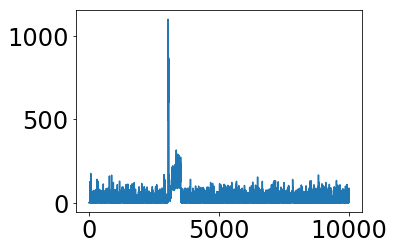

In [471]:
plt.plot(spike_sum)

# Trying to unpack recorded number of postsynaptic hits

In [202]:
def unpack_abcd(sh_exc, sh_exc_2):
    a = ((sh_exc) & 0xFFFF)
    b = ((sh_exc >> 16) & 0xFFFF)

    c = ((sh_exc_2) & 0xFFFF)
    d = ((sh_exc_2 >> 16) & 0xFFFF)
    return a, b, c, d

In [204]:
# save required csv
excel_filename = "abcd_recordings_per_core.xlsx"

writer = pd.ExcelWriter(
    excel_filename,
    engine='xlsxwriter')
per_core_abcd = {}
for index, pop in enumerate(plot_order):
    if pop not in all_post_hits.keys():
        continue
    print("POPULATION", pop)
    zipper = zip((other_recordings[pop]['v'].segments[0].filter(name='v')[0].magnitude.T * 2 ** 15).astype(int), 
                 (other_recordings[pop]['gsyn_exc'].segments[0].filter(name='gsyn_exc')[0].magnitude.T * 2 ** 15).astype(int))
    
    abcd_data = []
    abcd_totals = []
    abcd_argmax = []
    for sh_exc, sh_exc_2 in zipper:
        x = np.asarray(unpack_abcd(sh_exc, sh_exc_2))
        total_x = np.sum(x, axis=0)
        max_x = np.argmax(total_x)
        abcd_data.append(x[:, max_x])
        abcd_totals.append(total_x)
        abcd_argmax.append(max_x)
    abcd_argmax =  np.array(abcd_argmax)
    abcd_data =  np.array(abcd_data)
    abcd_totals =  np.array(abcd_totals)
    print("Number of cores", abcd_data.shape[0])
    names =['a', 'b', 'c', 'd']  # N
#     value = np.array(abcd_data, dtype=names)  # Note to self: numpy structured arrays are fucking broken
    array_for_pd = {name:abcd_data[:, col_id] for col_id, name in enumerate(names)}
    df = pd.DataFrame(array_for_pd)
    per_core_abcd[pop] = df
    df.to_excel(writer, sheet_name=pop)
    

writer.save()

POPULATION granule
Number of cores 1378
POPULATION golgi
Number of cores 4
POPULATION stellate
Number of cores 10
POPULATION basket
Number of cores 10
POPULATION purkinje
Number of cores 69
POPULATION dcn
Number of cores 1


Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_core_abcd_granule.pdf


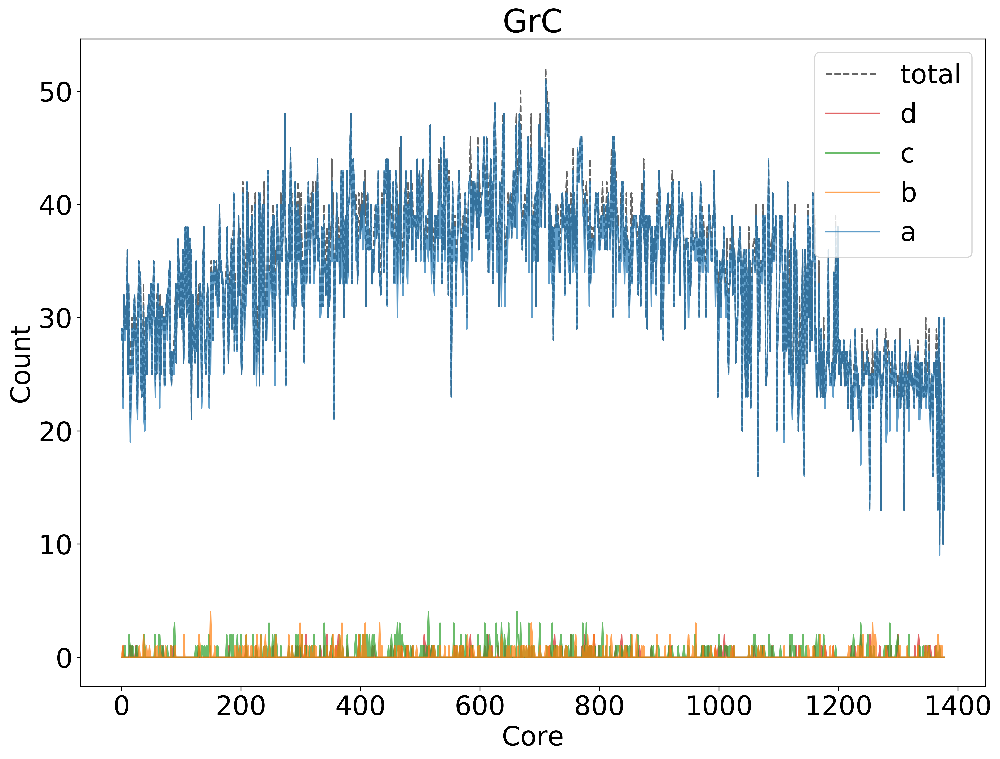

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_core_abcd_golgi.pdf


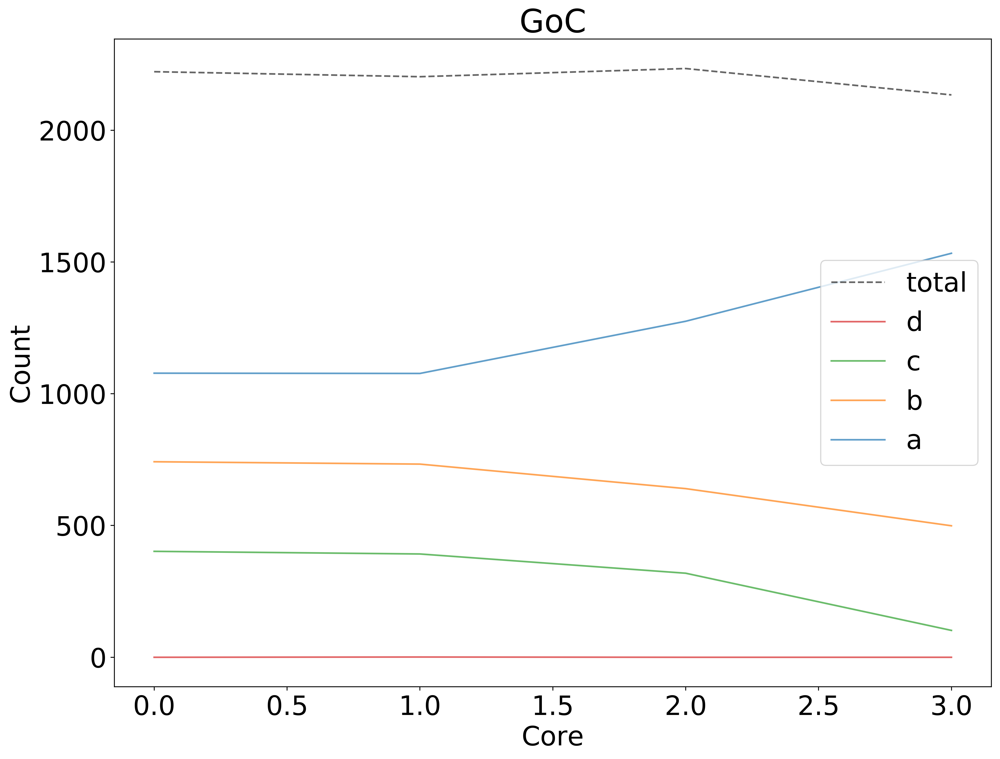

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_core_abcd_stellate.pdf


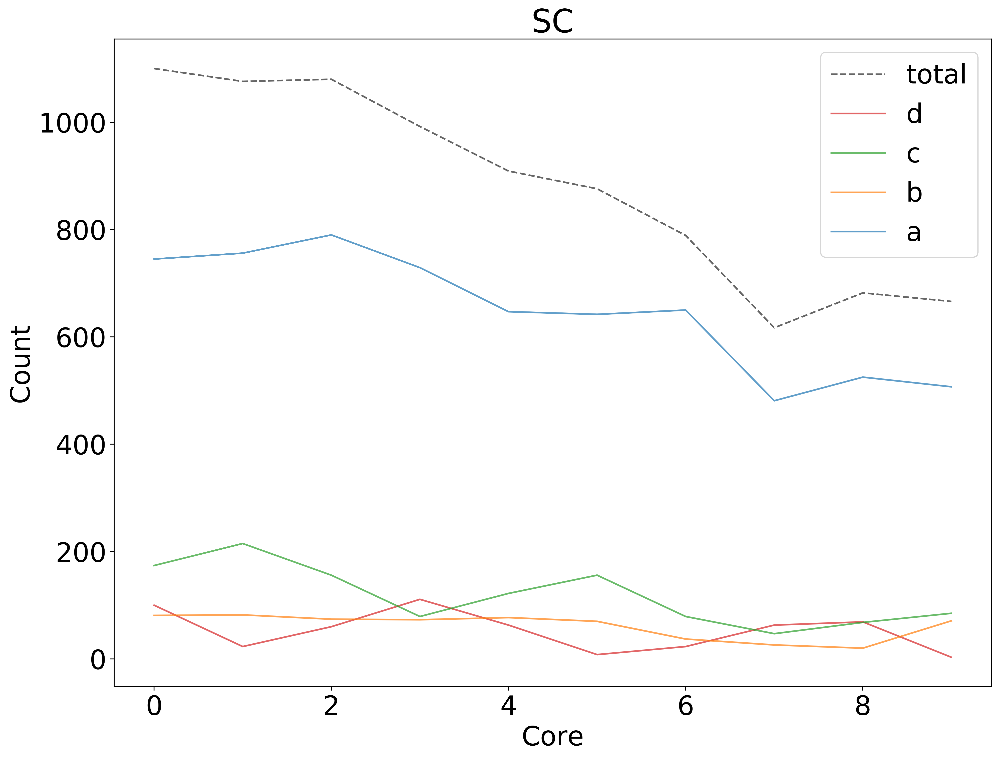

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_core_abcd_basket.pdf


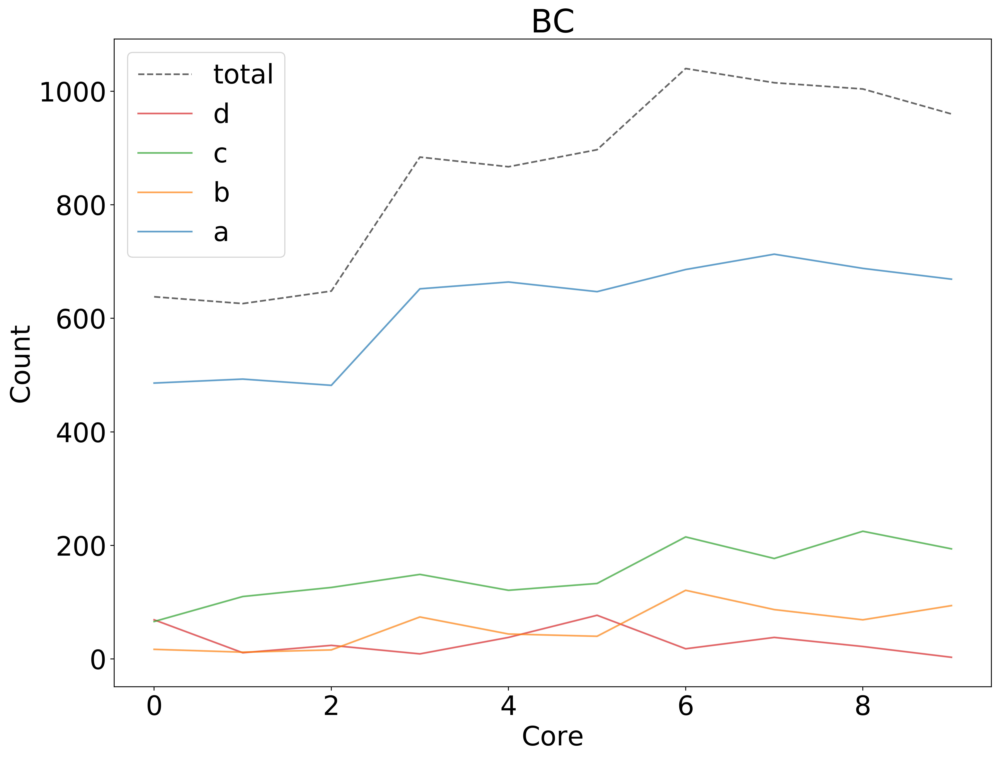

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_core_abcd_purkinje.pdf


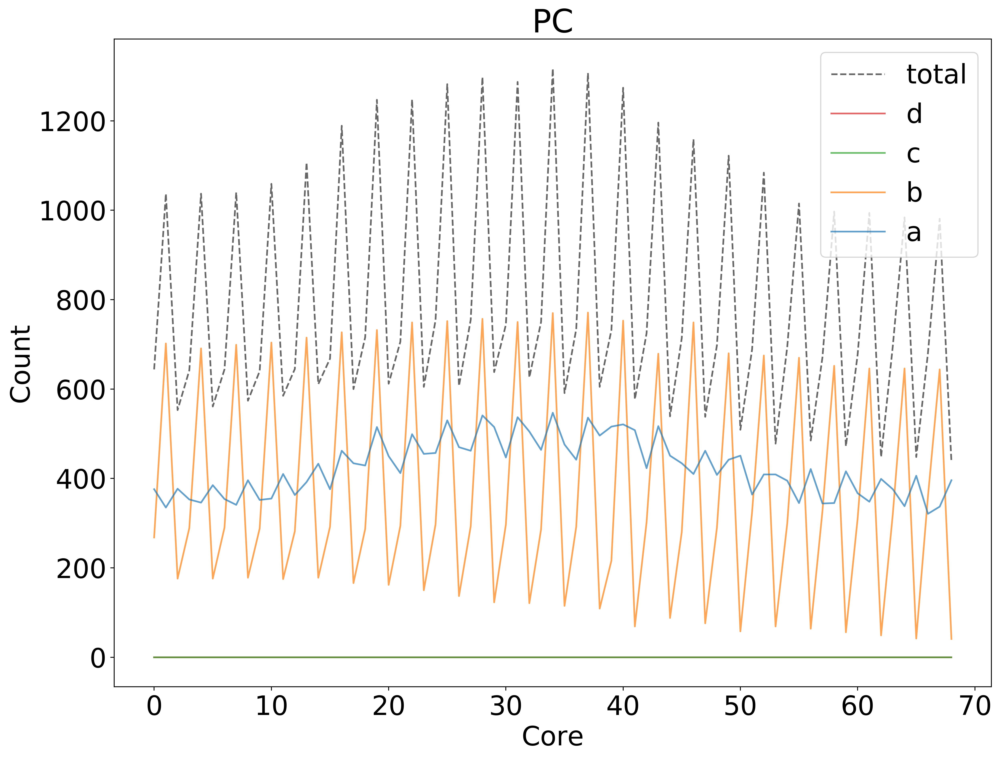

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/per_core_abcd_dcn.pdf


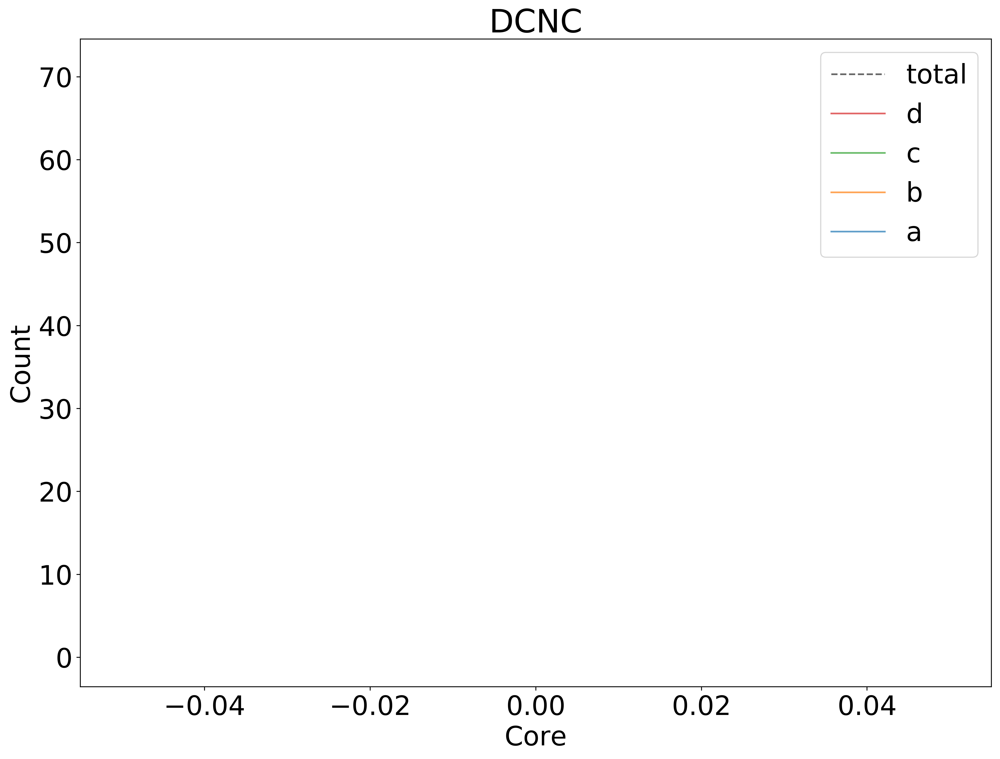

In [205]:
l = 10
transparency_lvl = .7
for core_id , pop in enumerate(plot_order):
    if pop not in per_core_abcd.keys():
#         f = plt.figure(1, figsize=(l, l), dpi=400)
#         plt.close(f)
        continue
    f = plt.figure(1, figsize=(13, 10), dpi=400)
    abcd_df = per_core_abcd[pop]

    plt.plot(abcd_df[['a', 'b','c','d']].sum(axis=1), label='total', c="k", ls="--", alpha=.6)
    plt.plot(abcd_df.d.values, label='d', c="C3", alpha=transparency_lvl)
    plt.plot(abcd_df.c.values, label='c', c="C2", alpha=transparency_lvl)
    plt.plot(abcd_df.b.values, label='b', c="C1", alpha=transparency_lvl)
    plt.plot(abcd_df.a.values, label='a', c="C0", alpha=transparency_lvl)


    plt.ylabel("Count")

    plt.title(use_display_name(pop))
    plt.legend(loc="best")
    plt.xlabel("Core")

    plt.tight_layout()
    save_figure(
        plt,
        os.path.join(sim_fig_folder,
                     "per_core_abcd_{}").format(pop),
        extensions=[".pdf", ])
    plt.show()
    plt.close(f)

Plotting a b c d post-synaptic hits V2
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/or_post_hits_granule.pdf


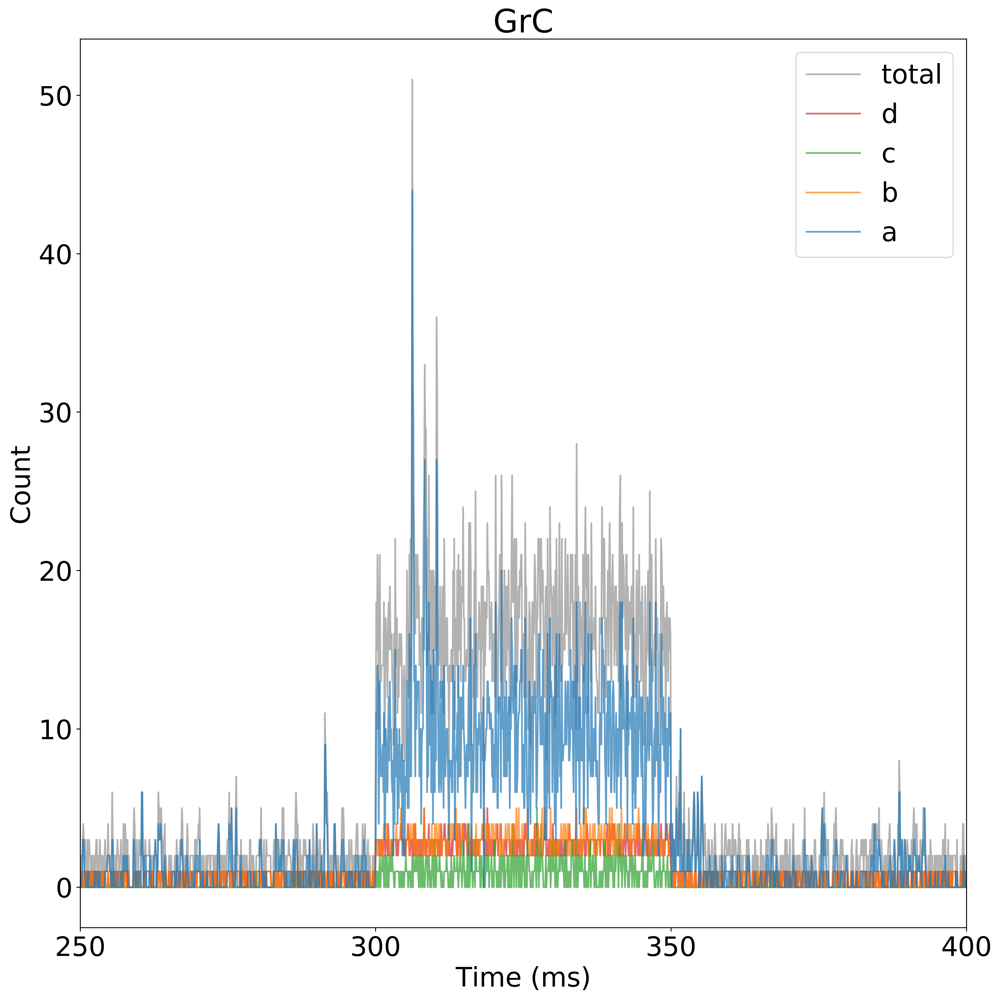

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/or_post_hits_golgi.pdf


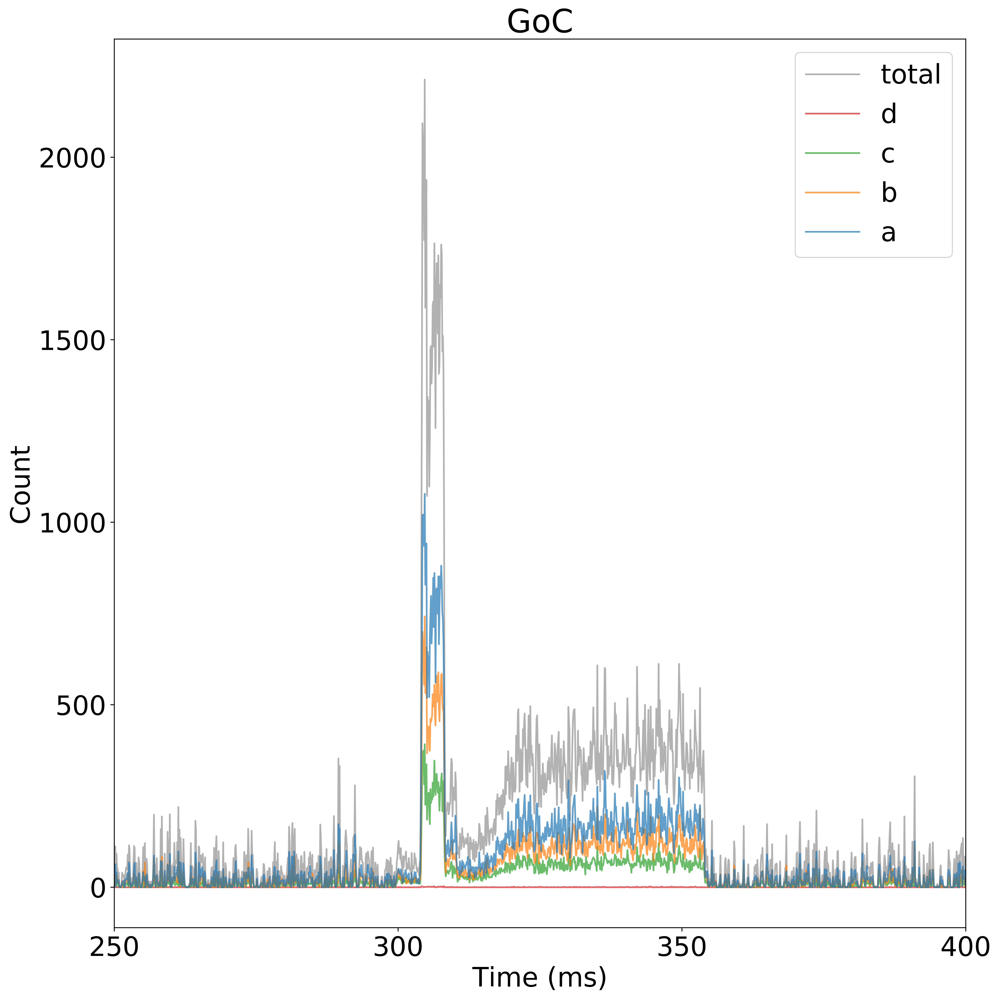

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/or_post_hits_stellate.pdf


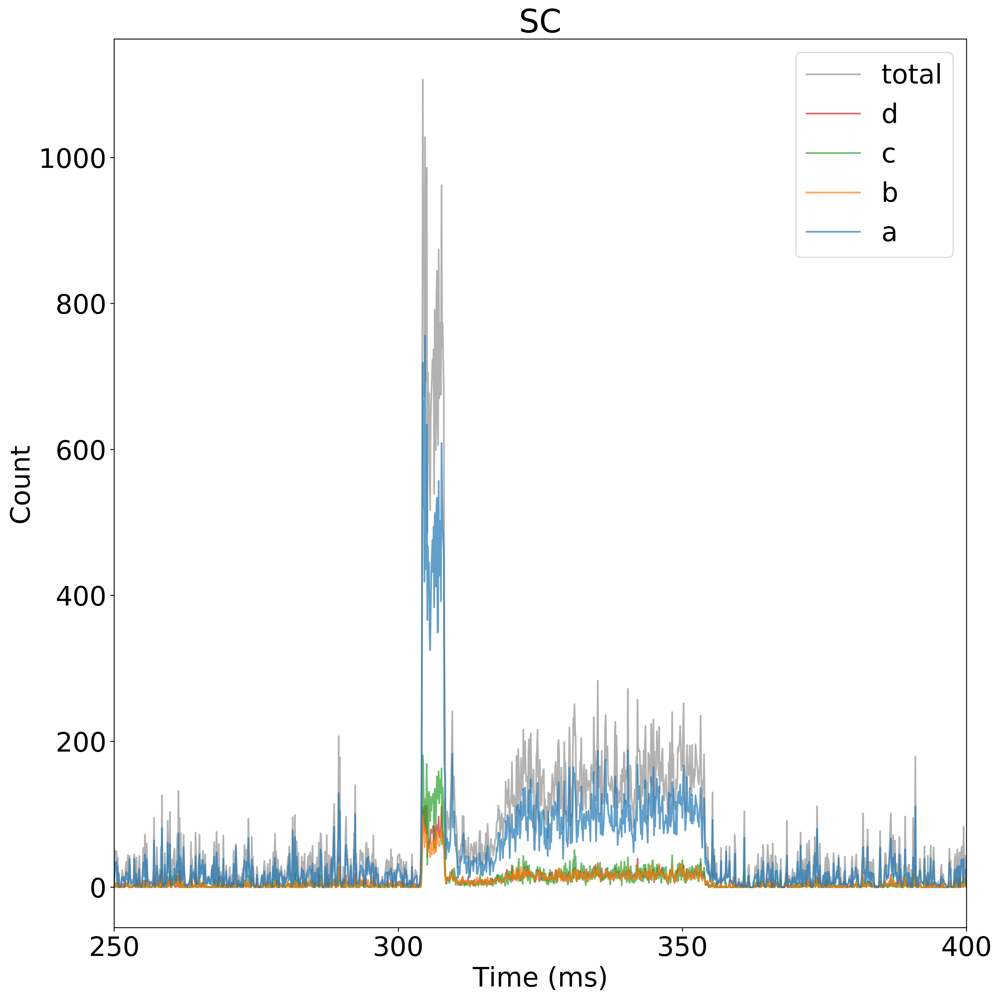

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/or_post_hits_basket.pdf


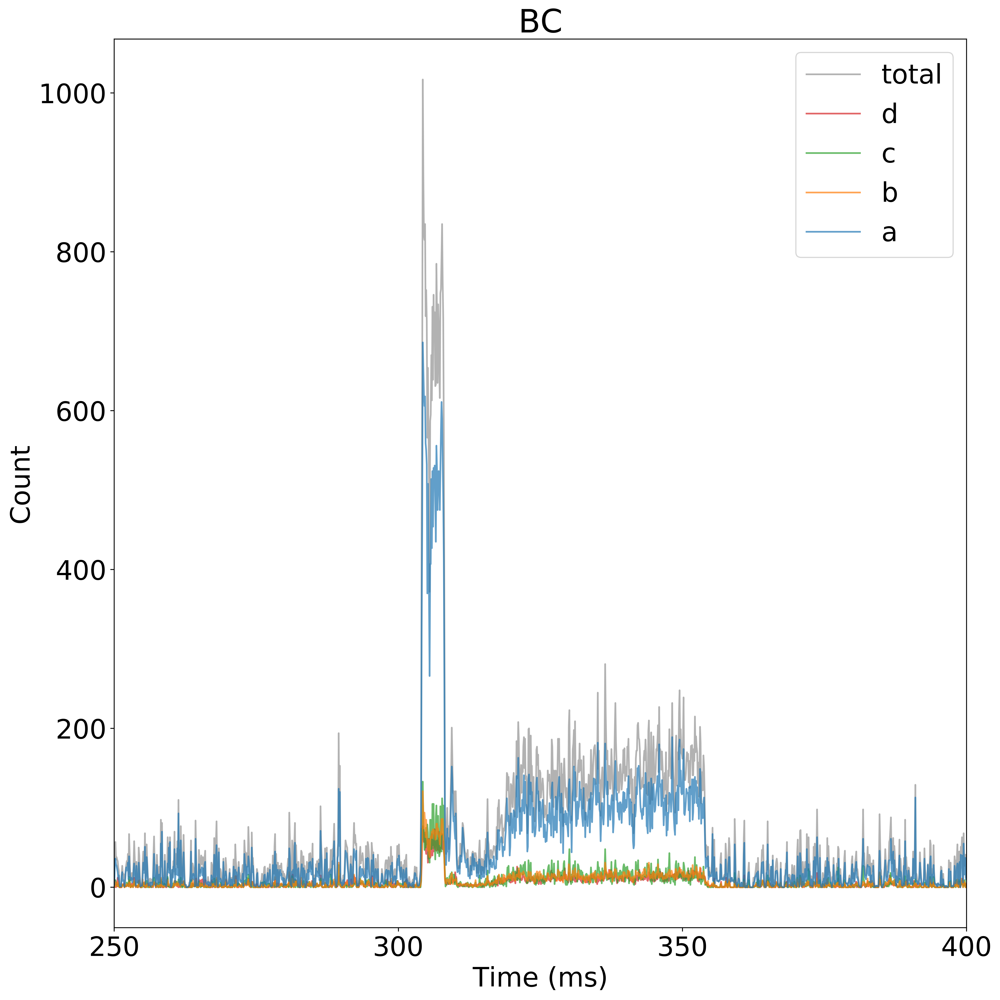

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/or_post_hits_purkinje.pdf


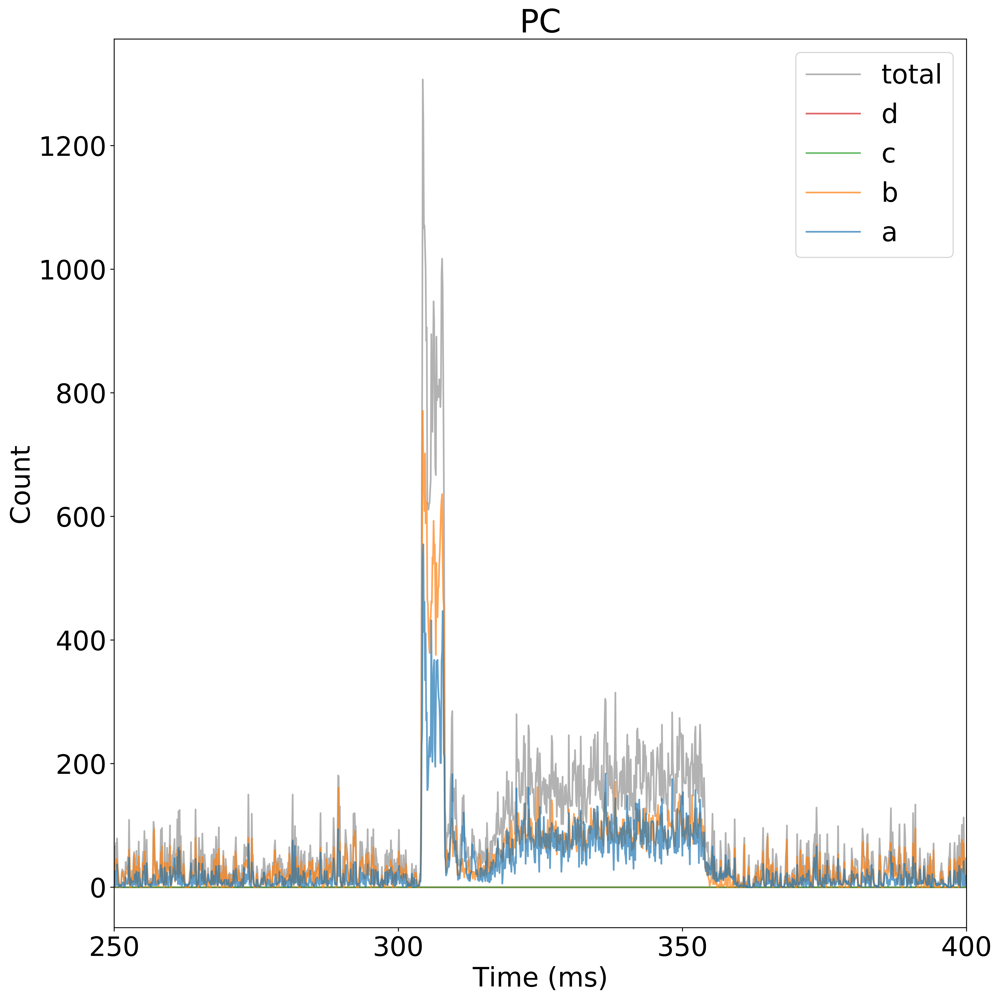

Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/or_post_hits_dcn.pdf


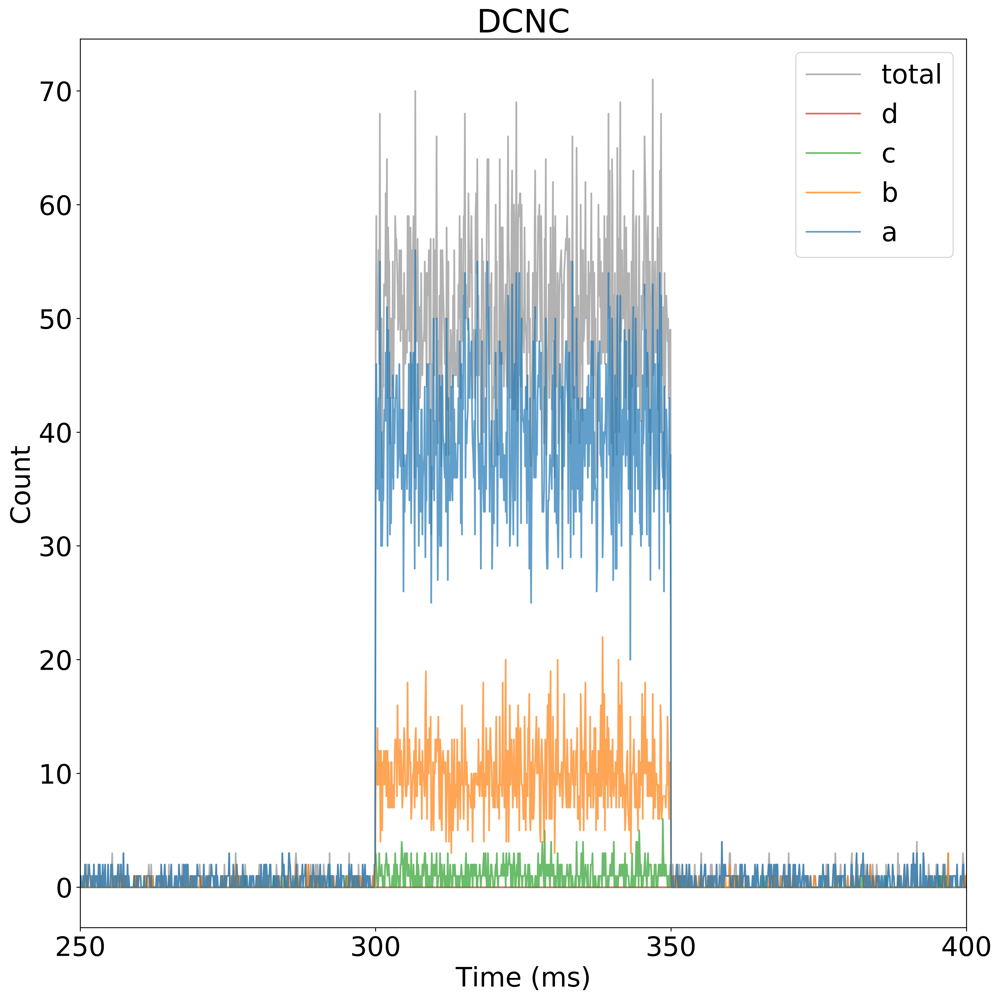

Plotting worst_case spikes per pop (POTENTIALLY; ONLY IF TOOLS ARE SETUP UP THIS WAY
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/potential_worst_neuron_only_spikes_per_pop_granule.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/potential_worst_neuron_only_spikes_per_pop_golgi.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/potential_worst_neuron_only_spikes_per_pop_stellate.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/potential_worst_neuron_only_spikes_per_pop_basket.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/potential_worst_neuron_only_spikes_per_pop_purkinje.pdf
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f371

In [206]:


# plot .1 ms PSTH
# print("Plotting elephant Instantaneous rates")
# try:
#     f, axes = plt.subplots(len(spikes_per_timestep.keys()), 1,
#                            figsize=(14, 20), sharex=True, dpi=400)
#     for index, pop in enumerate(plot_order):
#         if highlight_stim:
#             highlight_area(axes[index], pop, **common_highlight_values)
#         curr_psth = elephant_instantaneous_rates[pop]
#         axes[index].bar(np.arange(curr_psth.size),
#                         curr_psth,
#                         color=viridis_cmap(index / (n_plots + 1)),
#                         rasterized=True)
#         axes[index].set_title(use_display_name(pop))
#         axes[index].set_ylabel("Hz")
#     plt.xticks(wanted_times * time_to_bin_conversion, wanted_times)
#     plt.xlabel("Time (ms)")
#     save_figure(plt, os.path.join(sim_fig_folder,
#                                   "elephant_instantaneous_firing_rate"),
#                 extensions=['.png', ])
#     plt.close(f)
# except:
#     traceback.print_exc()

# plot_analog_signal(all_exc_gsyn, variable_name="gsyn_exc",
#                    ylabel="Exc synaptic conductance ($\mu S$)",
#                    **common_values_for_plots)
# plot_analog_signal(all_inh_gsyn, variable_name="gsyn_inh",
#                    ylabel="Inh synaptic conductance ($\mu S$)",
#                    **common_values_for_plots)
# plot_analog_signal(all_voltages, variable_name="v",
#                    ylabel="Membrane potential (mV)",
#                    **common_values_for_plots)
print("Plotting a b c d post-synaptic hits V2")
l = 13
transparency_lvl = .7
for index, pop in enumerate(plot_order):
    if pop not in all_post_hits.keys():
        f = plt.figure(1, figsize=(l, l), dpi=400)
        plt.close(f)
        continue
        
    sh_exc = np.max((other_recordings[pop]['v'].segments[0].filter(name='v')[0].magnitude.T * 2 ** 15).astype(int), axis=0)
    sh_exc_2 = np.max((other_recordings[pop]['gsyn_exc'].segments[0].filter(name='gsyn_exc')[0].magnitude.T * 2 ** 15).astype(int), axis=0)

    f = plt.figure(1, figsize=(l, l), dpi=400)
#     a = ((sh_exc) & 0xFFFF)
#     b = ((sh_exc >> 16) & 0xFFFF)
#     c = ((sh_exc_2) & 0xFFFF)
#     d = ((sh_exc_2 >> 16) & 0xFFFF)
    a, b, c, d = unpack_abcd(sh_exc, sh_exc_2)

    plt.plot(a + b + c + d, label='total', c="k", alpha=.3)
    plt.plot(d, label='d', c="C3", alpha=transparency_lvl)
    plt.plot(c, label='c', c="C2", alpha=transparency_lvl)
    plt.plot(b, label='b', c="C1", alpha=transparency_lvl)
    plt.plot(a, label='a', c="C0", alpha=transparency_lvl)


    plt.ylabel("Count")

    plt.title(use_display_name(pop))

    plt.xlim(stim_wanted_times.min() * time_to_bin_conversion,
             stim_wanted_times.max() * time_to_bin_conversion)
    plt.xticks(stim_wanted_times * time_to_bin_conversion, stim_wanted_times)
    plt.legend(loc="best")
    plt.xlabel("Time (ms)")

    plt.tight_layout()
    save_figure(
        plt,
        os.path.join(sim_fig_folder,
                     "or_post_hits_{}").format(pop),
        extensions=[".pdf", ])
    plt.show()
    plt.close(f)
    
print("Plotting worst_case spikes per pop (POTENTIALLY; ONLY IF TOOLS ARE SETUP UP THIS WAY")
for _, pop in enumerate(plot_order):
    if (pop not in all_max_exc_spikes.keys() or
            pop not in all_max_inh_spikes.keys()):
        continue

    total = all_max_exc_spikes[pop] + all_max_inh_spikes[pop]
    f = plt.figure(1, figsize=(14, 9), dpi=400)
    plt.plot(total, c='k', label="Total", alpha=.3)

    plt.plot(all_max_exc_spikes[pop], rasterized=True,
             label="excitatory spikes", alpha=transparency_lvl)
    plt.plot(all_max_inh_spikes[pop], rasterized=True,
             label="inhibitory spikes", alpha=transparency_lvl)

    plt.title(use_display_name(pop))
    plt.xlim(stim_wanted_times.min() * time_to_bin_conversion,
             stim_wanted_times.max() * time_to_bin_conversion)
    plt.xticks(stim_wanted_times * time_to_bin_conversion, stim_wanted_times)
    plt.legend(loc="best")
    plt.ylabel("Max # of spikes for a neuron")
    plt.xlabel("Time (ms)")
    plt.tight_layout()
    save_figure(
        plt,
        os.path.join(sim_fig_folder,
                     "potential_worst_neuron_only_spikes_per_pop_{}").format(pop),
        extensions=[".pdf", ])
    plt.close(f)


print("Plotting a b c d post-synaptic hits")
l = 13
transparency_lvl = .7 
    

# Plot distribution of worst case spikes per population
if conn_exists and worst_case:
    print("Plotting histogram of worst spike counts")
    for index, pop in enumerate(plot_order):
        counts = inc_spike_count[pop]
        maxs = np.max(counts, axis=1)
        assert maxs.size == all_neurons[pop]
        f = plt.figure(1, figsize=(9, 9), dpi=400)
        plt.hist(maxs, bins=20, color=viridis_cmap(index / (n_plots + 1)),
                 rasterized=True,
                 edgecolor='k')

        plt.title(use_display_name(pop))

        plt.ylabel("Count")
        plt.xlabel("Max # of spikes per neuron")
        plt.tight_layout()
        save_figure(
            plt,
            os.path.join(sim_fig_folder,
                         "max_spikes_per_neuron_in_{}").format(pop),
            extensions=[".pdf", ])
        plt.close(f)

    print("Plotting worst_case spikes per pop")
    for _, pop in enumerate(plot_order):
        print("\t", pop)
        all_ws_contribution = per_conn_worst_spikes[pop]
        maxs = []
        labels = []
        for k, v in all_ws_contribution.items():
            labels.append(k)
            maxs.append(np.sum(v, axis=0))
        maxs = np.asarray(maxs)
        if len(maxs) == 0:
            continue
        total = np.sum(maxs, axis=0)
        assert total.size == maxs.shape[1]
        f = plt.figure(1, figsize=(14, 9), dpi=400)
        plt.plot(total, c='k', label="Total", alpha=.3)
        for i, row in enumerate(maxs):
            plt.plot(row, rasterized=True, label=labels[i], alpha=.7)
        plt.title(use_display_name(pop) + "\n")

        plt.xlim(stim_wanted_times.min() * time_to_bin_conversion,
                 stim_wanted_times.max() * time_to_bin_conversion)
        plt.xticks(stim_wanted_times * time_to_bin_conversion, stim_wanted_times)
        plt.legend(loc="best")
        plt.ylabel("Max # of spikes per population")
        plt.xlabel("Time (ms)")
        plt.tight_layout()
        save_figure(
            plt,
            os.path.join(sim_fig_folder,
                         "sum_max_spikes_per_pop_{}").format(pop),
            extensions=[".pdf", ])
        plt.close(f)

        maxs = []
        labels = []
        for k, v in all_ws_contribution.items():
            labels.append(k)
            maxs.append(np.max(v, axis=0))
        maxs = np.asarray(maxs)
        if len(maxs) == 0:
            continue
        total = np.sum(maxs, axis=0)
        assert total.size == maxs.shape[1]
        f = plt.figure(1, figsize=(14, 9), dpi=400)
        plt.plot(total, c='k', label="Total", alpha=.3)
        for i, row in enumerate(maxs):
            plt.plot(row, rasterized=True, label=labels[i], alpha=.7)
        plt.title(use_display_name(pop))
        stim_wanted_times = np.linspace(time_filter[1] - 50,
                                        time_filter[2] + 50, 4).astype(int)
        plt.xlim(stim_wanted_times.min() * time_to_bin_conversion,
                 stim_wanted_times.max() * time_to_bin_conversion)
        plt.xticks(stim_wanted_times * time_to_bin_conversion, stim_wanted_times)
        plt.legend(loc="best")
        plt.ylabel("Max # of spikes for a neuron")
        plt.xlabel("Time (ms)")
        plt.tight_layout()
        save_figure(
            plt,
            os.path.join(sim_fig_folder,
                         "worst_neuron_only_spikes_per_pop_{}").format(pop),
            extensions=[".pdf", ])
        plt.close(f)


In [207]:

# raster plot including ALL populations
print("Plotting spiking raster plot for all populations")
f, axes = plt.subplots(len(all_spikes.keys()), 1,
                       figsize=(14, 20), sharex=True, dpi=400)
for index, pop in enumerate(plot_order):
    curr_ax = axes[index]
    # spike raster
    _times = all_spikes[pop][:, 1]
    _ids = all_spikes[pop][:, 0]
    if highlight_stim:
        highlight_area(curr_ax, pop, **common_highlight_values)

    curr_ax.scatter(_times,
                    _ids,
                    color=viridis_cmap(index / (n_plots + 1)),
                    s=.5, rasterized=True)
    curr_ax.set_title(use_display_name(pop))
plt.xlabel("Time (ms)")
# plt.suptitle((use_display_name(simulator)+"\n")
f.tight_layout()
save_figure(plt, os.path.join(sim_fig_folder, "raster_plots"),
            extensions=['.png', '.pdf'])
plt.close(f)

# raster plot + PSTH including ALL populations
print("Plotting spiking raster plot + PSTH for all populations")
f, axes = plt.subplots(2 * len(all_spikes.keys()), 1,
                       figsize=(14, 30), sharex=True, dpi=500)
for index, pop in enumerate(np.repeat(plot_order, 2)):
    curr_ax = axes[index]
    if highlight_stim:
        highlight_area(curr_ax, pop, **common_highlight_values)
    if index % 2 == 0:
        # spike raster
        _times = all_spikes[pop][:, 1]
        _ids = all_spikes[pop][:, 0]
        curr_ax.scatter(_times,
                        _ids,
                        color=viridis_cmap(int(index / 2) / (n_plots + 1)),
                        s=.5, rasterized=True)
        curr_ax.set_title(use_display_name(pop))
        curr_ax.set_ylabel("NID")
    else:
        curr_ax.bar(np.arange(spikes_per_timestep[pop].size) * timestep / ms,
                    spikes_per_timestep[pop],
                    color=viridis_cmap(int(index / 2) / (n_plots + 1)),
                    rasterized=True)
        curr_ax.set_ylabel("Count")

plt.xlabel("Time (ms)")
# plt.suptitle((use_display_name(simulator) + "\n")
f.tight_layout()
save_figure(plt, os.path.join(sim_fig_folder, "raster_and_psth_plots"),
            extensions=['.png', ])
plt.close(f)

# raster + PSTH for each population
print("Plotting spiking raster plot + PSTH for each population")
for index, pop in enumerate(plot_order):
    print("\t{:20}".format(pop), end=' ')
    f, (ax_0, ax_1) = plt.subplots(2, 1, figsize=(9, 9),
                                   sharex=True, dpi=400)

    # spike raster
    _times = all_spikes[pop][:, 1]
    _ids = all_spikes[pop][:, 0]

    if highlight_stim:
        highlight_area(ax_0, pop, **common_highlight_values)
    ax_0.scatter(_times,
                 _ids,
                 color=viridis_cmap(index / (n_plots + 1)),
                 s=.5, rasterized=True)
    ax_0.set_ylabel("NID")

    # PSTH
    if highlight_stim:
        highlight_area(ax_1, pop, **common_highlight_values)
    ax_1.bar(np.arange(spikes_per_timestep[pop].size) * timestep / ms,
             spikes_per_timestep[pop],
             color=viridis_cmap(index / (n_plots + 1)))
    ax_1.set_ylabel("Count")
    plt.xlabel("Time (ms)")
    save_figure(plt, os.path.join(sim_fig_folder,
                                  "{}_raster_and_psth".format(pop)),
                extensions=['.png', ])
    plt.close(f)
    print("SUCCESS")

# raster + PSTH + voltage for each population
print("Plotting spiking raster plot + PSTH + voltage for each population")
for index, pop in enumerate(plot_order):
    # plot voltage traces
    print("\t{:20}".format(pop), end=' ')
    if pop in ["glomerulus", "mossy_fibers"]:
        print("FAIL -- spike source")
        f = plt.figure(1, figsize=(9, 9), dpi=400)
        plt.close(f)
        continue
    f, (ax_0, ax_1, ax_2) = plt.subplots(3, 1, figsize=(9, 12),
                                         sharex=True, dpi=400)

    try:
        # spike raster
        if highlight_stim:
            highlight_area(ax_0, pop, **common_highlight_values)
        ax_0.scatter(all_spikes[pop][:, 1],
                     all_spikes[pop][:, 0],
                     color=viridis_cmap(index / (n_plots + 1)),
                     s=.5, rasterized=True)
        ax_0.set_ylabel("NID")
        # PSTH
        if highlight_stim:
            highlight_area(ax_1, pop, **common_highlight_values)
        ax_1.bar(np.arange(spikes_per_timestep[pop].size) * timestep / ms,
                 spikes_per_timestep[pop],
                 color=viridis_cmap(index / (n_plots + 1)),
                 rasterized=True)
        ax_1.set_ylabel("Count")

        # voltage
        pop_exc_g = all_voltages[pop]
        for _ind, _trace in enumerate(pop_exc_g):
            ax_2.plot(np.arange(_trace.size) * timestep / ms, _trace,
                      color=viridis_cmap(index / (n_plots + 1)))

        ax_2.set_ylabel("Membrane potential (mV)")
        plt.xlabel("Time (ms)")

        save_figure(plt, os.path.join(sim_fig_folder,
                                      "{}_raster_psth_and_voltage".format(pop)),
                    extensions=['.png', ])
        plt.close(f)
        print("SUCCESS")
    except:
        print("FAIL")
# plot .1 ms PSTH
print("Plotting PSTH for each timestep")
f, axes = plt.subplots(len(spikes_per_timestep.keys()), 1,
                       figsize=(14, 20), sharex=True, dpi=400)
for index, pop in enumerate(plot_order):
    if highlight_stim:
        highlight_area(axes[index], pop, **common_highlight_values)
    axes[index].bar(np.arange(spikes_per_timestep[pop].size),
                    spikes_per_timestep[pop],
                    color=viridis_cmap(index / (n_plots + 1)),
                    rasterized=True)
    axes[index].set_title(use_display_name(pop))
plt.xticks(wanted_times * time_to_bin_conversion, wanted_times)
# plt.suptitle((use_display_name(simulator) + "\n")

save_figure(plt, os.path.join(sim_fig_folder,
                              "timestep_psth"),
            extensions=['.png', ])
plt.close(f)

# plot 3 ms PSTH
print("Plotting PSTH in bins of 3 ms")
f, axes = plt.subplots(len(spikes_per_3ms.keys()), 1,
                       figsize=(14, 20), sharex=True, dpi=400)
for index, pop in enumerate(plot_order):
    axes[index].bar(np.arange(spikes_per_3ms[pop].size), spikes_per_3ms[pop],
                    color=viridis_cmap(index / (n_plots + 1)),
                    rasterized=True)
    axes[index].set_title(use_display_name(pop))

plt.xticks(wanted_times * time_to_bin_conversion / bins_in_3ms, wanted_times)
# plt.suptitle((use_display_name(simulator) + "\n")

save_figure(plt, os.path.join(sim_fig_folder,
                              "timestep_psth_3ms"),
            extensions=['.png', '.pdf'])
plt.close(f)

# plot firing rate histogram per PSTH region
print("Plotting firing rate histograms")
f, axes = plt.subplots(len(plot_order), 3,
                       figsize=(14, 20), sharex=True, dpi=400)
for index, pop in enumerate(plot_order):
    for period in range(stimulus_periods):
        curr_ax = axes[index, period]
        curr_ax.hist(per_neuron_firing[pop][:, period],
                     color=viridis_cmap(index / (n_plots + 1)),
                     bins=20, rasterized=True)
        if period == 1:
            curr_ax.set_title(use_display_name(pop))
        curr_ax.set_xlabel("Hz")
        curr_ax.xaxis.set_tick_params(which='both',
                                      labelbottom=True)
        curr_ax.set_xticks([0, 75, 150])

f.tight_layout()

save_figure(plt, os.path.join(sim_fig_folder,
                              "neuron_firing_rate_hist"),
            extensions=['.png', '.pdf'])
plt.close(f)
# TODO plot weight histogram

# TODO plot centred connectivity
print("=" * 80)

Plotting spiking raster plot for all populations
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/raster_plots.png
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/raster_plots.pdf
Plotting spiking raster plot + PSTH for all populations
Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/raster_and_psth_plots.png
Plotting spiking raster plot + PSTH for each population
	glomerulus           Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/glomerulus_raster_and_psth.png
SUCCESS
	granule              Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f3710e632b0acfb3bb09650542af/granule_raster_and_psth.png
SUCCESS
	golgi                Plotting                                :figures/spinn_400x400_run_0_poisson_@c1f7f